# Setup Environment

In [877]:
import pandas as pd
from itertools import product, chain
import multiprocessing as mp

from ast import literal_eval
from datetime import datetime, timedelta
import dask.dataframe as dd
import dask
dask.config.set({"dataframe.convert-string": False})

import pm4py
from pm4py.algo.discovery.alpha import algorithm as alpha_miner
from pm4py.algo.filtering.log.variants import variants_filter
from pm4py.algo.discovery.heuristics import algorithm as heuristic_miner

import ast
import json
import random
import os
from os import path
from itertools import chain
from memory_profiler import profile
from multiprocessing import Process, Queue
from mlxtend.preprocessing import TransactionEncoder
from tqdm.notebook import tqdm
import polars as pl

from scipy.cluster.hierarchy import dendrogram, linkage
from sklearn.metrics import silhouette_samples, silhouette_score
from joblib import Parallel, delayed

import numpy as np
from numpy import unique, where

from sklearn import set_config
from sklearn.utils import check_array, check_random_state
from sklearn.base import BaseEstimator, ClusterMixin
from sklearn.cluster import AffinityPropagation, Birch, DBSCAN, MiniBatchKMeans, KMeans, AgglomerativeClustering
from sklearn.metrics.pairwise import cosine_similarity, euclidean_distances, pairwise_distances_argmin
from sklearn.decomposition import TruncatedSVD,  MiniBatchSparsePCA
from sklearn.metrics import silhouette_score, silhouette_samples

import matplotlib
import matplotlib.cm as cm
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches

np.random.seed(42)
random.seed(42)

if not path.exists('Sarabun-Regular.ttf'):
  !wget https://github.com/google/fonts/raw/main/ofl/sarabun/Sarabun-Regular.ttf -O Sarabun-Regular.ttf 

if 'Sarabun' not in [x.name for x in matplotlib.font_manager.fontManager.ttflist]:
  matplotlib.font_manager.fontManager.addfont('Sarabun-Regular.ttf')
matplotlib.rc('font', family='Sarabun')

In [878]:
year = '2023'
prom_output_path = './dataset/'+year+'/place_process_mining/'
cluster_output_path = './dataset/'+year+'/place_clustering/pattern/'
silhouette_path = './dataset/'+year+'/place_clustering/silhouette/'

In [879]:
_df = dd.read_parquet('dataset/'+year+'/dataset.parquet', engine='pyarrow')
df = _df.compute()

In [880]:
df = df.drop_duplicates(["text","primaryType"]).reset_index(drop=True)

In [881]:
# # Define source
# df = pd.read_csv(year+'.csv')
# print(len(df))
# df.sample(3)

In [882]:
df

,urls,keyword,text,places,place_infos,filtered_places,filtered_rename_places,primaryType,subType,activities,primaryType_comb,activity_comb,rename_activity_comb
0,https://www.facebook.com/groups/12319466768303...,unidentified,เอาทริปพึงกลับมาฝากของดีราชบุรีเขาสวรรค์ตลาดโอ...,"[""ราชบุรี"", ""เขาสวรรค์"", ""ตลาดโอ๊ปอย""]","[{'types': ['tourist_attraction', 'point_of_in...","['เขาสวรรค์', 'ตลาดโอ๊ปอย']","['เขาสวรรค์ สวนผึ้ง', 'ตลาดโอ๊ะป่อย Oh Poi Mar...","[['Tourism'], ['Shop and Store']]","[['tourist_attraction'], ['market']]","[{""place"": ""เขาสวรรค์"", ""activity"": []}, {""pla...","[('Tourism', 'Shop and Store')]",[()],[[]]
1,https://www.facebook.com/groups/paikondieow/pe...,ฤดู,ท่ามกลางท้องฟ้าอันสดใสและผืนทะเลสีครามของต้นฤด...,"[""เกาะมัน"", ""เกาะมันใน"", ""เกาะมันกลาง"", ""เกาะม...","[{'types': ['natural_feature', 'establishment'...","['เกาะมัน', 'เกาะมันใน', 'เกาะมันกลาง', 'เกาะม...","['Ko Man Nork', 'Ko Man Nai', 'Ko Man Klang', ...","[['Tourism'], ['Tourism'], ['Tourism'], ['Tour...","[['natural_feature'], ['natural_feature'], ['n...","[{""place"": ""เกาะมัน"", ""activity"": [""พักผ่อนกับ...","[('Tourism', 'Tourism', 'Tourism', 'Tourism')]","[('พักผ่อนกับที่พักสุดไพรเวท',), ('กิจกรรมชวนผ...","[['Relaxation'], ['Relaxation Activities'], ['..."
2,https://www.facebook.com/groups/paikondieow/pe...,unidentified,Gamping คูล ๆ นอนรถบ้านริมทะเลที่เดียวในสัตหีบ...,"[""หาด EOD สัตหีบ"", ""หาดน้ำใส"", ""หาดดงตาล"", ""ตล...","[{'types': ['natural_feature', 'establishment'...","['หาด EOD สัตหีบ', 'หาดน้ำใส', 'หาดดงตาล', 'ตล...","['Nang Rong Beach', 'Nam Sai Beach', 'Dongtan ...","[['Tourism'], ['Tourism'], ['Tourism'], ['Shop...","[['natural_feature'], ['tourist_attraction'], ...","[{""place"": ""หาด EOD สัตหีบ"", ""activity"": [""แช่...","[('Tourism', 'Tourism', 'Tourism', 'Shop and S...","[('แช่อ่างจากุชชี่ใต้แสงจันทร์', 'แล่นเรือใบ',...","[['Spa and relaxation', 'Nature and Outdoor Ac..."
3,https://www.facebook.com/groups/paikondieow/pe...,สิงหา,12 พิกัด มาเก๊า-จูไห่ บินเที่ยวสบายๆ ไม่ต้องทำ...,"[""มาเก๊า"", ""จูไห่"", ""PONTO SQUARE"", ""อนุสรณ์สถ...","[{'types': ['clothing_store', 'store', 'point_...","['PONTO SQUARE', 'หวี่นี่', 'ตลาดใต้ดินก๊งเป่ย...","['PRONTO Siam square soi 2', 'ไอ-มี่ ชาบู', 'S...","[['Shop and Store'], ['Food and Drink'], ['Sho...","[['store', 'clothing_store'], ['food', 'restau...","[{""place"": ""PONTO SQUARE"", ""activity"": []}, {""...","[('Shop and Store', 'Food and Drink', 'Shop an...","[('ช้อปเพลิน', 'ไหว้ขอลูก', 'ไหว้เสริมสิริมงคล')]","[['Shopping', 'Religious Activities', 'Religio..."
4,https://www.facebook.com/groups/paikondieow/pe...,กพ,วาเลนไทน์ปีนี้ พาเธอไปดูหนัง แบบ สุดปัง ! #โร...,"[""พารากอน ซีนีเพล็กซ์"", ""พารากอน ซีนีเพล็กซ์"",...","[{'types': ['movie_theater', 'point_of_interes...","['พารากอน ซีนีเพล็กซ์', 'พารากอน ซีนีเพล็กซ์']","['Paragon Cineplex', 'Paragon Cineplex']","[['Entertainment'], ['Entertainment']]","[['movie_theater'], ['movie_theater']]","[{""place"": ""พารากอน ซีนีเพล็กซ์"", ""activity"": ...","[('Entertainment', 'Entertainment')]","[('ดูหนัง',)]",[['Camping']]
...,...,...,...,...,...,...,...,...,...,...,...,...,...
199,https://www.facebook.com/share/p/ahKPxsMNEgzrg...,trip,งามแต้..เมืองแป้หน้าฝนจ้าววว ยิ่งรู้จักยิ่งหลง...,"[""จังหวัดแพร่"", ""วัดพระธาตุอินทร์แขวน"", ""จังหว...","[{'types': ['tourist_attraction', 'place_of_wo...","['วัดพระธาตุอินทร์แขวน', 'พระธาตุอินทร์แขวน', ...","['Golden Rock Mountaintop Temple, Phrae Town',...","[['Religion', 'Tourism'], ['Religion', 'Touris...","[['tourist_attraction', 'place_of_worship'], [...","[{""place"": ""วัดพระธาตุอินทร์แขวน"", ""activity"":...","[('Religion', 'Religion', 'Religion'), ('Relig...","[('สักการะบูชาพระธาตุอินทร์แขวน', 'สักการะบูชา...","[['Religious Activities', 'Religious Activitie..."
200,https://www.facebook.com/groups/paikondieow/pe...,กพ,เที่ยวปีใหม่ที่เชียงรายค่ะหลงรักไม่ไหว อยากย้า...,"[""เชียงราย"", ""โรงแรมวังคำ"", ""สวนดอกไม้"", ""หอนา...","[{'types': ['hotel', 'lodging', 'point_of_inte...","['โรงแรมวั

# Clustering

## Module

### Evaluation

In [883]:
def compute_silhouette_scores(X, labels):
    # This function computes the silhouette scores for each sample
    return silhouette_samples(X, labels)

def parallel_silhouette_score(X, n_clusters, n_jobs=8):
    # Step 1: Perform K-means clustering
    kmeans =  MiniBatchKMeans(random_state=42, max_iter=300, batch_size=32, n_clusters=n_clusters, n_init=2,  # Finer tolerance
                         reassignment_ratio=0.1, verbose=1, max_no_improvement = 30)
    with joblib.parallel_backend('dask'):
        cluster_labels = kmeans.fit_predict(X)
    
    # Step 2: Split the labels into n_jobs parts for parallel processing
    labels_split = np.array_split(cluster_labels, n_jobs)
    X_split = np.array_split(X, n_jobs)

    # Step 3: Use Dask delayed to handle the parallel computation
    delayed_results = [delayed(compute_silhouette_scores)(X_split[i], labels_split[i]) for i in range(n_jobs)]

    # Compute all results at once using Dask
    parallel_results = compute(*delayed_results)  # This triggers all the computations


#     # Step 2: Split the labels into n_jobs parts for parallel processing
#     # It's crucial to split data or labels for processing parts in parallel
#     # Here, for simplicity, we process silhouette scores in chunks
#     labels_split = np.array_split(cluster_labels, n_jobs)
#     X_split = np.array_split(X, n_jobs)

#     # Step 3: Use joblib to parallelize the silhouette score computation
#     parallel_results = Parallel(n_jobs=n_jobs)(delayed(compute_silhouette_scores)(X_split[index], labels) for index, labels in enumerate(labels_split))

    # Step 4: Combine the results and compute the mean score
    # Since silhouette_samples returns a score for each sample, we concatenate them first
    all_scores = np.concatenate(parallel_results)
    mean_score = np.mean(all_scores)

    return all_scores, mean_score, cluster_labels

### Preprocess

In [884]:
def liststr_to_list(liststr):
  tolist = ast.literal_eval(liststr)
  return tolist

In [885]:
def create_categorical_numerical_pair(data):
  categorical_to_numerical = {"NONE": 0}
  numerical_to_categorical = {0: "NONE"}

  for index, element in enumerate(sorted(list(set(chain.from_iterable(data))))):
    categorical_to_numerical[element] = index+1
    numerical_to_categorical[index+1] = element

  return categorical_to_numerical, numerical_to_categorical

def preprocess(data, categorical_to_numerical, numerical_to_categorical, padding = True, encoding = True, padding_tag = 0):

  max_length = len(max(data, key=len))
 # categorical_to_numerical, numerical_to_categorical = create_categorical_numerical_pair(data)

  preprocessed_list = []

  for subsequence in data:
    sequence = subsequence
    if encoding:
        sequence = [categorical_to_numerical[point] for point in subsequence]

    if padding:
      if len(sequence) < max_length:
        for i in range(0, max_length - len(subsequence)):
          sequence.append(padding_tag)
    preprocessed_list.append(sequence)

  return preprocessed_list

In [886]:
# Calculate cosine similarity between sublists
def similarity(sublist1, sublist2):
    return cosine_similarity([sublist1], [sublist2])[0][0]

def group_cluster(data, labels, sort_by_similarity=True):
  # Construct dict by clusters
  cluster_dict = {}
  for index, label in enumerate(labels):
    if label not in cluster_dict:
      cluster_dict[label] = []
    cluster_dict[label].append(data[index])

  if sort_by_similarity:
    # Convert the sublists to numpy arrays for cosine similarity calculation
    cluster_arrays = {k: np.array(v) for k, v in cluster_dict.items()}

    # Sort each sublist based on the similarity of their patterns
    sorted_data = {}
    for key, sublists in cluster_arrays.items():
        similarities = [(i, sublist) for i, sublist in enumerate(sublists)]
        similarities.sort(key=lambda x: similarity(x[1], sublists.mean(axis=0)), reverse=True)
        sorted_data[key] = [sublist.tolist() for i, sublist in similarities]

    return sorted_data

  return cluster_dict

In [887]:
# reduce dimension
def minibatch_sparse_pca(data, n_components):
  transformer = MiniBatchSparsePCA(n_components=n_components, batch_size=50,
                                  max_iter=10, random_state=0, verbose = 1)
  transformer.fit(data)
  return transformer.transform(data)

# most values in the components_ are zero (sparsity)
# np.mean(transformer.components_ == 0)

### Model

In [888]:
# MiniBatchKMeans CLustering
def mini_batchmeans_clustering(data, n_clusters=None, max_iter=300, batch_size=2048,
                               n_init = 10, decompose = True, decompose_size = 8
                                 ):
  # kmeans = MiniBatchKMeans(n_clusters=n_clusters,
  #                         random_state=42,
  #                         batch_size=batch_size,
  #                         max_iter=max_iter,
  #                          n_init=n_init,max_no_improvement=30,
  #                        # Finer tolerance
  #                        reassignment_ratio=0.1,
  #                         verbose = 1)
  x = data
  if decompose:
    x = truncated_svd(data, n_components = decompose_size)
    
  # kmeans.fit(x)
  kmeans =  MiniBatchKMeans(random_state=42, max_iter=300, batch_size=32, n_clusters=n_clusters, n_init=2,  # Finer tolerance
                         reassignment_ratio=0.1, verbose=1, max_no_improvement = 30)
  with joblib.parallel_backend('dask'):
    kmeans.fit(x)

  labels = kmeans.labels_
  n_clusters_ = unique(labels).size

  # Construct dict of clusters
  cluster_dict = group_cluster(data, labels)

  # Print results
  print('Estimated number of clusters: %d' % n_clusters_)
  print('Labels: %s' % labels)

  return cluster_dict, labels

### Visualization

In [889]:
def calculate_percentages(nested_list, cat_to_num):

    percent_counts = {}
    for cat, num in cat_to_num.items():
      percent_counts[num] = 0

    for sequence in nested_list:
      # Count occurrences of each item
      temp_counts = {}
      for cat, num in cat_to_num.items():
        temp_counts[num] = 0

      for item in sequence:
        if item in temp_counts:
          temp_counts[item] += 1
        else:
          temp_counts[item] = 1

      total_count = len(sequence)
      temp_percent_counts = {item: (count / total_count) for item, count in temp_counts.items()}

      for item, count in temp_percent_counts.items():
        if item in percent_counts:
          percent_counts[item] += count
        else:
          percent_counts[item] = count

    total_count = len(nested_list)
    overall_percent = {item: (count / total_count) * 100 for item, count in percent_counts.items()}
    overall_percent = dict(sorted(overall_percent.items(), key=lambda item: item[1], reverse=True))

    return overall_percent

In [890]:
def plot_patches(data, cat_to_num, num_to_cat, defined_sample_size = -1, p=0.5, random_seed = 42):

  np.random.seed(42)
  img_name = "default"

  n_cluster = len(data.keys())
  n_rows = (n_cluster + 1) // 2

  # Define a list of colors for your categories
  colormap_tab20b = plt.cm.tab20b(np.linspace(0, 1, 20))
  colormap_tab20c = plt.cm.tab20c(np.linspace(0, 1, 20))
  colormap_Pastel1 = plt.cm.Pastel1(np.linspace(0, 1, 9))
  colormap_Set3 = plt.cm.Set3(np.linspace(0, 1, 12))

  colors_combined = np.vstack((colormap_Set3, colormap_tab20c, colormap_tab20b, colormap_Pastel1))
  np.random.shuffle(colors_combined)
  color_dict = {category: colors_combined[i] for i, category in enumerate(cat_to_num.keys())}


  # fig, axs = plt.subplots(n_rows, 2, figsize=(9, n_rows*2.5), constrained_layout=True)
  fig, axs = plt.subplots(1, 1, figsize=(10, 6), constrained_layout=True)
  fig.subplots_adjust(left=0.05, right=0.95, bottom=0.8, top=0.05, wspace=0.2, hspace=1.2)

  legend_labels = {}
  percentages = {}

  if n_cluster == 1:
    axs = np.array([[axs]])
  elif n_rows == 1:  # Only one row but possibly more than one column
    axs = np.array([axs])

  total = 0
  for key, value in data.items():
    # Sum the lengths of all lists associated with the key
    item_count = sum(len(sublist) for sublist in value)
    # Assign the count to the corresponding key in the item_counts dictionary
    total += item_count

  for key, element in data.items():
    sample_size = defined_sample_size
    np.random.seed(random_seed + key)
    similarity_matrix = np.array(element)

    percentages = calculate_percentages(element, cat_to_num)



    # row, col = divmod(key, 2)
    row, col = 0, 0
   
    # Plot with categorical colors
    for i, row_data in enumerate(similarity_matrix):
        for j, val in enumerate(row_data):
            # Use color_dict to map category to color
            color = colors_combined[val % len(colors_combined)]
            # rect = plt.Rectangle((j-0.5, i-0.5), 1, 1, color=color_dict[num_to_cat.get(val, 'None')])
            rect = plt.Rectangle((j-0.5, i-0.5), 1, 1, color=color)
            axs[row, col].add_patch(rect)

    axs[row,col].set_title(f'Cluster {key}', fontsize='medium', )
    axs[row,col].grid(which="minor", color="w", axis='x', linestyle='-', linewidth=0.4)
    axs[row,col].tick_params(which="minor", size=0)
    axs[row,col].set_xticks(np.arange(-.5, len(similarity_matrix[0]), 1), minor=True)
    axs[row,col].set_yticks(np.arange(-.5, len(similarity_matrix), 1), minor=True)
    axs[row,col].set_xticks(np.arange(0, len(similarity_matrix[0]), 1), minor=False)
    axs[row,col].set_yticks(np.arange(0, len(similarity_matrix), 1), minor=False)
    axs[row,col].set_xticklabels(np.asarray([i if i%2 == 0 else "" for i in range(1, len(similarity_matrix[0])+1)]))
    axs[row,col].set_yticklabels(np.asarray([i if( i == 1 or i==len(similarity_matrix)) else "" for i in range(1, len(similarity_matrix)+1)]))
    axs[row,col].set_xlabel('Destination', fontsize='medium')
    axs[row,col].set_ylabel('Itinerary', fontsize='medium')

    img_name = f'cluster_{key}'

  # if n_cluster % 2 != 0:
  #   axs[-1,-1].axis('off')

  legend_labels = cat_to_num

  # Shared legend for both subplots
  # patches = [mpatches.Patch(facecolor=plt.cm.gist_ncar(value/len(cat_to_num.keys())), label=label) for label, value in legend_labels.items()]
  # patches = [mpatches.Patch(color=color_dict[cat], label=f"{cat} ({'{:.2f}'.format(percentages[num])}%){' - Top {}'.format(list(percentages.keys()).index(num)+1) if list(percentages.keys()).index(num) < 5 else ''}") for cat, num in cat_to_num.items()]
  patches = [mpatches.Patch(color=color_dict[num_to_cat[num]], label=f"{'Top {} - '.format(list(percentages.keys()).index(num)+1) if list(percentages.keys()).index(num) < 5 else ''}{num_to_cat[num]} ({'{:.2f}'.format(percent)}%)") for num, percent in percentages.items()]
  lgd = axs[row,col].legend(handles=patches, bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0., title="Legend", fontsize='small', title_fontsize='medium')

  # Shared title for the figure
  fig.suptitle('Itinerary Patterns', fontsize='large', fontweight='bold')
  plt.savefig(f'{cluster_output_path}{img_name}.png', bbox_extra_artists=[lgd,], bbox_inches='tight')

## Runner - Find optimal K

In [891]:
def generate_groups(lists):
    for group in product(*lists):
        yield group

#Define a function to be applied to each partition
def primary_type_comb_process_partition(partition):
    partition = partition.reset_index(drop = True)
    # Extract mentioned activities along the places from text post by LLM
    for index, primaryType_itinerary_text in tqdm(enumerate(partition['primaryType'])):
        try:
            primaryType_itinerary_lists = ast.literal_eval(primaryType_itinerary_text)
            

            primaryType_comb = generate_groups(primaryType_itinerary_lists)
            try:
                partition.loc[index, 'primaryType_comb'] = np.array(list(primaryType_comb)).tolist()
                partition.loc[index, 'primaryType'] = primaryType_itinerary_lists
            except:
                partition.loc[index, 'primaryType_comb'] = list(primaryType_comb)
                partition.loc[index, 'primaryType'] = primaryType_itinerary_lists
        except Exception as e:
            print(e)
    return partition

df = df.astype('object')
# Read the large DataFrame using Dask
_df = dd.from_pandas(df, npartitions=10)

# Apply the function to each partition in parallel
result_df = _df.map_partitions(primary_type_comb_process_partition).compute()
df = result_df.copy()
df = df.reset_index(drop=True)
df

0it [00:00, ?it/s]

malformed node or string on line 1: <ast.Name object at 0x000001C191765A20>
malformed node or string on line 1: <ast.Name object at 0x000001C191767BB0>


,urls,keyword,text,places,place_infos,filtered_places,filtered_rename_places,primaryType,subType,activities,primaryType_comb,activity_comb,rename_activity_comb
0,https://www.facebook.com/groups/12319466768303...,unidentified,เอาทริปพึงกลับมาฝากของดีราชบุรีเขาสวรรค์ตลาดโอ...,"[""ราชบุรี"", ""เขาสวรรค์"", ""ตลาดโอ๊ปอย""]","[{'types': ['tourist_attraction', 'point_of_in...","['เขาสวรรค์', 'ตลาดโอ๊ปอย']","['เขาสวรรค์ สวนผึ้ง', 'ตลาดโอ๊ะป่อย Oh Poi Mar...","[[Tourism], [Shop and Store]]","[['tourist_attraction'], ['market']]","[{""place"": ""เขาสวรรค์"", ""activity"": []}, {""pla...","[[Tourism, Shop and Store]]",[()],[[]]
1,https://www.facebook.com/groups/paikondieow/pe...,ฤดู,ท่ามกลางท้องฟ้าอันสดใสและผืนทะเลสีครามของต้นฤด...,"[""เกาะมัน"", ""เกาะมันใน"", ""เกาะมันกลาง"", ""เกาะม...","[{'types': ['natural_feature', 'establishment'...","['เกาะมัน', 'เกาะมันใน', 'เกาะมันกลาง', 'เกาะม...","['Ko Man Nork', 'Ko Man Nai', 'Ko Man Klang', ...","[[Tourism], [Tourism], [Tourism], [Tourism]]","[['natural_feature'], ['natural_feature'], ['n...","[{""place"": ""เกาะมัน"", ""activity"": [""พักผ่อนกับ...","[[Tourism, Tourism, Tourism, Tourism]]","[('พักผ่อนกับที่พักสุดไพรเวท',), ('กิจกรรมชวนผ...","[['Relaxation'], ['Relaxation Activities'], ['..."
2,https://www.facebook.com/groups/paikondieow/pe...,unidentified,Gamping คูล ๆ นอนรถบ้านริมทะเลที่เดียวในสัตหีบ...,"[""หาด EOD สัตหีบ"", ""หาดน้ำใส"", ""หาดดงตาล"", ""ตล...","[{'types': ['natural_feature', 'establishment'...","['หาด EOD สัตหีบ', 'หาดน้ำใส', 'หาดดงตาล', 'ตล...","['Nang Rong Beach', 'Nam Sai Beach', 'Dongtan ...","[[Tourism], [Tourism], [Tourism], [Shop and St...","[['natural_feature'], ['tourist_attraction'], ...","[{""place"": ""หาด EOD สัตหีบ"", ""activity"": [""แช่...","[[Tourism, Tourism, Tourism, Shop and Store], ...","[('แช่อ่างจากุชชี่ใต้แสงจันทร์', 'แล่นเรือใบ',...","[['Spa and relaxation', 'Nature and Outdoor Ac..."
3,https://www.facebook.com/groups/paikondieow/pe...,สิงหา,12 พิกัด มาเก๊า-จูไห่ บินเที่ยวสบายๆ ไม่ต้องทำ...,"[""มาเก๊า"", ""จูไห่"", ""PONTO SQUARE"", ""อนุสรณ์สถ...","[{'types': ['clothing_store', 'store', 'point_...","['PONTO SQUARE', 'หวี่นี่', 'ตลาดใต้ดินก๊งเป่ย...","['PRONTO Siam square soi 2', 'ไอ-มี่ ชาบู', 'S...","[[Shop and Store], [Food and Drink], [Shop and...","[['store', 'clothing_store'], ['food', 'restau...","[{""place"": ""PONTO SQUARE"", ""activity"": []}, {""...","[[Shop and Store, Food and Drink, Shop and Sto...","[('ช้อปเพลิน', 'ไหว้ขอลูก', 'ไหว้เสริมสิริมงคล')]","[['Shopping', 'Religious Activities', 'Religio..."
4,https://www.facebook.com/groups/paikondieow/pe...,กพ,วาเลนไทน์ปีนี้ พาเธอไปดูหนัง แบบ สุดปัง ! #โร...,"[""พารากอน ซีนีเพล็กซ์"", ""พารากอน ซีนีเพล็กซ์"",...","[{'types': ['movie_theater', 'point_of_interes...","['พารากอน ซีนีเพล็กซ์', 'พารากอน ซีนีเพล็กซ์']","['Paragon Cineplex', 'Paragon Cineplex']","[[Entertainment], [Entertainment]]","[['movie_theater'], ['movie_theater']]","[{""place"": ""พารากอน ซีนีเพล็กซ์"", ""activity"": ...","[[Entertainment, Entertainment]]","[('ดูหนัง',)]",[['Camping']]
...,...,...,...,...,...,...,...,...,...,...,...,...,...
199,https://www.facebook.com/share/p/ahKPxsMNEgzrg...,trip,งามแต้..เมืองแป้หน้าฝนจ้าววว ยิ่งรู้จักยิ่งหลง...,"[""จังหวัดแพร่"", ""วัดพระธาตุอินทร์แขวน"", ""จังหว...","[{'types': ['tourist_attraction', 'place_of_wo...","['วัดพระธาตุอินทร์แขวน', 'พระธาตุอินทร์แขวน', ...","['Golden Rock Mountaintop Temple, Phrae Town',...","[[Religion, Tourism], [Religion, Tourism], [Re...","[['tourist_attraction', 'place_of_worship'], [...","[{""place"": ""วัดพระธาตุอินทร์แขวน"", ""activity"":...","[[Religion, Religion, Religion], [Religion, Re...","[('สักการะบูชาพระธาตุอินทร์แขวน', 'สักการะบูชา...","[['Religious Activities', 'Religious Activitie..."
200,https://www.facebook.com/groups/paikondieow/pe...,กพ,เที่ยวปีใหม่ที่เชียงรายค่ะหลงรักไม่ไหว อยากย้า...,"[""เชียงราย"", ""โรงแรมวังคำ"", ""สวนดอกไม้"", ""หอนา...","[{'types': ['hotel', 'lodging', 'point_of_inte...","['โรงแรมวังคำ', 'หอนาฬิกา', 'ตลาดไนท์บร

In [892]:
df['primaryType_len'] = df['primaryType'].map(len)
# df['primaryType_len'].value_counts()

from scipy import stats
# # https://stackoverflow.com/questions/23199796/detect-and-exclude-outliers-in-a-pandas-dataframe

df = df[(np.abs(stats.zscore(df['primaryType_len'])) < 3)].reset_index(drop=True)

In [893]:
df['primaryType_len'].value_counts()

primaryType_len
2    115
3     39
4     17
5     11
6      8
9      4
7      4
8      1
Name: count, dtype: int64

In [894]:
df = df.explode('primaryType_comb')

In [895]:
df = df.reset_index(drop = True)
df

,urls,keyword,text,places,place_infos,filtered_places,filtered_rename_places,primaryType,subType,activities,primaryType_comb,activity_comb,rename_activity_comb,primaryType_len
0,https://www.facebook.com/groups/12319466768303...,unidentified,เอาทริปพึงกลับมาฝากของดีราชบุรีเขาสวรรค์ตลาดโอ...,"[""ราชบุรี"", ""เขาสวรรค์"", ""ตลาดโอ๊ปอย""]","[{'types': ['tourist_attraction', 'point_of_in...","['เขาสวรรค์', 'ตลาดโอ๊ปอย']","['เขาสวรรค์ สวนผึ้ง', 'ตลาดโอ๊ะป่อย Oh Poi Mar...","[[Tourism], [Shop and Store]]","[['tourist_attraction'], ['market']]","[{""place"": ""เขาสวรรค์"", ""activity"": []}, {""pla...","[Tourism, Shop and Store]",[()],[[]],2
1,https://www.facebook.com/groups/paikondieow/pe...,ฤดู,ท่ามกลางท้องฟ้าอันสดใสและผืนทะเลสีครามของต้นฤด...,"[""เกาะมัน"", ""เกาะมันใน"", ""เกาะมันกลาง"", ""เกาะม...","[{'types': ['natural_feature', 'establishment'...","['เกาะมัน', 'เกาะมันใน', 'เกาะมันกลาง', 'เกาะม...","['Ko Man Nork', 'Ko Man Nai', 'Ko Man Klang', ...","[[Tourism], [Tourism], [Tourism], [Tourism]]","[['natural_feature'], ['natural_feature'], ['n...","[{""place"": ""เกาะมัน"", ""activity"": [""พักผ่อนกับ...","[Tourism, Tourism, Tourism, Tourism]","[('พักผ่อนกับที่พักสุดไพรเวท',), ('กิจกรรมชวนผ...","[['Relaxation'], ['Relaxation Activities'], ['...",4
2,https://www.facebook.com/groups/paikondieow/pe...,unidentified,Gamping คูล ๆ นอนรถบ้านริมทะเลที่เดียวในสัตหีบ...,"[""หาด EOD สัตหีบ"", ""หาดน้ำใส"", ""หาดดงตาล"", ""ตล...","[{'types': ['natural_feature', 'establishment'...","['หาด EOD สัตหีบ', 'หาดน้ำใส', 'หาดดงตาล', 'ตล...","['Nang Rong Beach', 'Nam Sai Beach', 'Dongtan ...","[[Tourism], [Tourism], [Tourism], [Shop and St...","[['natural_feature'], ['tourist_attraction'], ...","[{""place"": ""หาด EOD สัตหีบ"", ""activity"": [""แช่...","[Tourism, Tourism, Tourism, Shop and Store]","[('แช่อ่างจากุชชี่ใต้แสงจันทร์', 'แล่นเรือใบ',...","[['Spa and relaxation', 'Nature and Outdoor Ac...",4
3,https://www.facebook.com/groups/paikondieow/pe...,unidentified,Gamping คูล ๆ นอนรถบ้านริมทะเลที่เดียวในสัตหีบ...,"[""หาด EOD สัตหีบ"", ""หาดน้ำใส"", ""หาดดงตาล"", ""ตล...","[{'types': ['natural_feature', 'establishment'...","['หาด EOD สัตหีบ', 'หาดน้ำใส', 'หาดดงตาล', 'ตล...","['Nang Rong Beach', 'Nam Sai Beach', 'Dongtan ...","[[Tourism], [Tourism], [Tourism], [Shop and St...","[['natural_feature'], ['tourist_attraction'], ...","[{""place"": ""หาด EOD สัตหีบ"", ""activity"": [""แช่...","[Tourism, Tourism, Tourism, Food and Drink]","[('แช่อ่างจากุชชี่ใต้แสงจันทร์', 'แล่นเรือใบ',...","[['Spa and relaxation', 'Nature and Outdoor Ac...",4
4,https://www.facebook.com/groups/paikondieow/pe...,สิงหา,12 พิกัด มาเก๊า-จูไห่ บินเที่ยวสบายๆ ไม่ต้องทำ...,"[""มาเก๊า"", ""จูไห่"", ""PONTO SQUARE"", ""อนุสรณ์สถ...","[{'types': ['clothing_store', 'store', 'point_...","['PONTO SQUARE', 'หวี่นี่', 'ตลาดใต้ดินก๊งเป่ย...","['PRONTO Siam square soi 2', 'ไอ-มี่ ชาบู', 'S...","[[Shop and Store], [Food and Drink], [Shop and...","[['store', 'clothing_store'], ['food', 'restau...","[{""place"": ""PONTO SQUARE"", ""activity"": []}, {""...","[Shop and Store, Food and Drink, Shop and Stor...","[('ช้อปเพลิน', 'ไหว้ขอลูก', 'ไหว้เสริมสิริมงคล')]","[['Shopping', 'Religious Activities', 'Religio...",9
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
406,https://www.facebook.com/groups/paikondieow/pe...,กพ,เที่ยวปีใหม่ที่เชียงรายค่ะหลงรักไม่ไหว อยากย้า...,"[""เชียงราย"", ""โรงแรมวังคำ"", ""สวนดอกไม้"", ""หอนา...","[{'types': ['hotel', 'lodging', 'point_of_inte...","['โรงแรมวังคำ', 'หอนาฬิกา', 'ตลาดไนท์บราซ่า', ...","['Wangcome Hotel', 'หอนาฬิกา', 'At Narong Nigh...","[[Hotel], [Tourism], [Shop and Store], [Religi...","[['lodging', 'hotel'], ['park'], ['market'], [...","[{""place"": ""โรงแรมวังคำ"", ""activity"": [""นอน"", ...","[Hotel, Tourism, Shop and Store, Religion, Rel...","[('นอน', 'ชมหอนาฬิกาเปิดไฟเปิดเพลง', 'ของกิน',...","[['Relaxation', 'Nature and Outdoor Activities...",5
407,https://www.facebook.com/groups/paikondieow/pe...,กพ,เที่ยวปีใหม่ที่เชียงรายค่ะหลงรักไม่ไหว 

### BREAK

In [809]:
# original_frequencies = df['primaryType_len'].value_counts().to_dict()
# ori_proportion = df['primaryType_len'].value_counts() / df['primaryType_len'].value_counts().sum()
# # df.groupby(['primaryType_len']).agg(
# #     {"primaryType_len_count": len}).sort_values(
# #     ["primaryType_len_count", "primaryType_len"], ascending=[False, True]).head(int(len(df) * 0.8)).reset_index()

In [810]:
# def generate_groups(lists):
#     for group in product(*lists):
#         yield group

# for index, primaryType_itinerary_text in tqdm(enumerate(df['primaryType'])):
#     primaryType_itinerary_lists = ast.literal_eval(primaryType_itinerary_text)
    
#     primaryType_comb = generate_groups(primaryType_itinerary_lists)
#     try:
#         df.loc[index, 'primaryType_comb'] = np.array(list(primaryType_comb)).tolist()
#     except:
#         df.loc[index, 'primaryType_comb'] = list(primaryType_comb)
        
# df = df.explode('primaryType_comb')

In [811]:
# df = df.explode('primaryType_comb')

In [812]:
# max_index_len = df.index.value_counts().max()

# index_len = df.index.value_counts().to_dict()

# frames= []

# for idx, amount in index_len.items():
#     # Filter the DataFrame to get rows corresponding to the current index
#     subset = df.loc[idx]
    
#     # subset = df[df.index == idx]
    
#     # Ensure subset is a DataFrame, not a Series
#     if isinstance(subset, pd.Series):
#         subset = subset.to_frame().transpose()
    
#     repeat_times = max_index_len / len(subset)
#     # Append the repeated subsets plus the original to the list
#     frames.extend([subset] * round(repeat_times))
#     # print(len([subset] * repeat_times))
    
# result = pd.concat(frames)
# df = result.copy()
# new_frequencies = df['primaryType_len'].value_counts().to_dict()

In [813]:
# original_frequencies_ = sorted(original_frequencies.items())
# new_frequencies_ = sorted(new_frequencies.items())

# # Ensure keys match (this step assumes both dicts have exactly the same keys)
# differences = list(map(lambda x, y: (x[0], x[1] - y[1]), new_frequencies_, original_frequencies_))
# ratios = list(map(lambda x, y: (x[0], x[1] / y[1] if y[1] != 0 else float('inf')), new_frequencies_, original_frequencies_))

In [814]:
# max_ratio = max(ratios, key=lambda x: x[1])[1]

# # Function to multiply a dictionary value
# def multiply_value(ori_item, new_item):
#     key, value = ori_item
#     newkey, newvalue = new_item
#     return (key, int(value * max_ratio) - newvalue)

# # Use map to apply the function to each dictionary item
# # Convert the result back into a dictionary
# multiplied_dict = dict(map(multiply_value, original_frequencies.items(), new_frequencies.items()))

In [815]:
# frames = []

# for idx, amount in multiplied_dict.items():
#     # Filter the DataFrame to get rows corresponding to the current index
#     # subset = df.loc[idx]
#     subset = df[df['primaryType_len'] == idx]
#     # Ensure subset is a DataFrame, not a Series
#     if isinstance(subset, pd.Series):
#         subset = subset.to_frame().transpose()
    
#     repeat_times = amount // len(subset)
#     # Append the repeated subsets plus the original to the list
#     frames.extend([subset] * (repeat_times + 1))
    
# # Concatenate all frames
# result = pd.concat(frames)
# new_proportion = result['primaryType_len'].value_counts() / result['primaryType_len'].value_counts().sum()
# ori_proportion, new_proportion

In [816]:
# df = result.reset_index(drop=True)
# df

In [817]:
# df = df.reset_index(drop = True)
# df

### END BREAK

In [818]:
# def create_categorical_numerical_pair(data):
#   categorical_to_numerical = {"NONE": 0}
#   numerical_to_categorical = {0: "NONE"}

#   for index, element in enumerate(sorted(list(set(data)))):
#     categorical_to_numerical[element] = index+1
#     numerical_to_categorical[index+1] = element

#   return categorical_to_numerical, numerical_to_categorical

In [819]:
# np.array(primaryType_comb_list).shape

In [820]:
# # Select 300,000 rows to be sample
# primaryType_comb_list = df['primaryType_comb'].sample(n=300000 if len(df) > 300000 else len(df)).tolist()
# print(len(primaryType_comb_list))
primaryType_comb_list =  df['primaryType_comb'].tolist()
# primaryType_comb_list = [list(k) for i in primaryType_comb_list for k in i]
cat_to_num, num_to_cat= create_categorical_numerical_pair(primaryType_comb_list)
cat_to_num

{'NONE': 0,
 'Agriculture': 1,
 'Art and Culture': 2,
 'Conference and Community': 3,
 'Education': 4,
 'Entertainment': 5,
 'Food and Drink': 6,
 'Healthcare and Wellness': 7,
 'Hotel': 8,
 'Religion': 9,
 'Service': 10,
 'Shop and Store': 11,
 'Sport': 12,
 'Tourism': 13}

In [821]:
# primaryType_comb_list = df['primaryType_comb'].tolist()
# print(len(primaryType_comb_list))

# cat_to_num, num_to_cat= create_categorical_numerical_pair(primaryType_comb_list)
cat_to_num = {'NONE': 0,
  'Agriculture': 1,
  'Art and Culture': 2,
  'Conference and Community': 3,
  'Education': 4,
  'Entertainment': 5,
  'Food and Drink': 6,
  'Healthcare and Wellness': 7,
  'Hotel': 8,
  'Religion': 9,
  'Service': 10,
  'Shop and Store': 11,
  'Sport': 12,
  'Tourism': 13}
num_to_cat =  {0: 'NONE',
  1: 'Agriculture',
  2: 'Art and Culture',
  3: 'Conference and Community',
  4: 'Education',
  5: 'Entertainment',
  6: 'Food and Drink',
  7: 'Healthcare and Wellness',
  8: 'Hotel',
  9: 'Religion',
  10: 'Service',
  11: 'Shop and Store',
  12: 'Sport',
  13: 'Tourism'}

In [822]:
import dask.array as da

def preprocess_dask(data, categorical_to_numerical, numerical_to_categorical, padding=True, encoding=True, padding_tag=0):
    max_length = len(max(data, key=len))  # This needs to be computed beforehand if data is very large

    def process_sequence(subsequence):
        if encoding:
            sequence = [categorical_to_numerical.get(point, padding_tag) for point in subsequence]
        else:
            sequence = list(subsequence)

        if padding and len(sequence) < max_length:
            sequence.extend([padding_tag] * (max_length - len(sequence)))

        return sequence

    # Apply the processing function to each sequence
    result = list(map(process_sequence, data))
    return da.from_array(np.array(result), chunks=(1000, max_length))  # Adjust chunk size based on your system's memory

# Example usage
# categorical_to_numerical, numerical_to_categorical = create_categorical_numerical_pair(data_list)
X = preprocess_dask(primaryType_comb_list, cat_to_num, num_to_cat)
X = X.compute()  # This line triggers the actual computation
np.random.shuffle(X)
X.shape

(1316, 11)

In [823]:
import dask.array as da
from dask.distributed import Client
from sklearn.cluster import MiniBatchKMeans
from dask import delayed, compute

# # def compute_silhouette_scores(X, labels):
# #     # Compute the silhouette scores using Dask
# #     return silhouette_samples(X, labels)

# # @delayed
# # def parallel_silhouette_score(X, n_clusters, n_jobs=8):
# #     # Use MiniBatchKMeans for more efficient clustering on large datasets
# #     kmeans = MiniBatchKMeans(
# #         n_clusters=n_clusters, batch_size=512, 
# #         max_iter=100, tol=1e-4, random_state=42, 
# #         reassignment_ratio=0.01,  n_init='auto', 
# #     )
# #     cluster_labels = kmeans.fit_predict(X)
    
# #     # Compute silhouette scores
# #     all_scores = compute_silhouette_scores(X, cluster_labels)
# #     mean_score = da.mean(all_scores).compute()  # This triggers the actual computation

# #     return all_scores, mean_score, cluster_labels

# # Assuming X is a Dask array, if not, convert it
# X_dask = da.from_array(X, chunks=(100000, 31))  # Adjust chunk size based on your system's configuration
# X_dask = X_dask.persist()

# # # Example usage
# # result = parallel_silhouette_score(X_dask, n_clusters=5)
# # all_scores, mean_score, cluster_labels = compute(result)  # Trigger the computation

In [824]:
#import dask_ml.cluster

#km = dask_ml.cluster.KMeans(n_clusters=3, init_max_iter=2, oversampling_factor=10)
#km.fit(X_dask)

In [825]:
from dask_ml.wrappers import Incremental
from dask_ml.datasets import make_classification
import sklearn.linear_model
from dask.distributed import Client
import joblib

# kmeans = MiniBatchKMeans(
#     n_clusters=5, batch_size=512, 
#     max_iter=100, tol=1e-4, random_state=42, 
#     reassignment_ratio=0.01,  n_init='auto', 
# )
    
# client = Client(processes=False)             # create local cluster
# # client = Client("scheduler-address:8786")  # or connect to remote cluster

# with joblib.parallel_backend('dask'):
#     kmeans.fit(X)

In [826]:
# X = np.array(preprocess(primaryType_comb_list, cat_to_num, num_to_cat))
# # X = minibatch_sparse_pca(X, n_components = int(X.shape[1] * 0.6))
# np.random.shuffle(X)
# X.shape

C:\Users\researcher01\AppData\Roaming\Python\Python311\site-packages\distributed\node.py:182: UserWarning:

Port 8787 is already in use.
Perhaps you already have a cluster running?
Hosting the HTTP server on port 50541 instead

C:\ProgramData\anaconda3\Lib\contextlib.py:144: UserWarning:

Creating scratch directories is taking a surprisingly long time. (2.45s) This is often due to running workers on a network file system. Consider specifying a local-directory to point workers to write scratch data to a local disk.



  0%|          | 0/99 [00:00<?, ?it/s]

Init 1/2 with method k-means++
Inertia for init 1/2: 19687.0
Init 2/2 with method k-means++
Inertia for init 2/2: 14682.0
Minibatch step 1/12337: mean batch inertia: 131.9375
Minibatch step 2/12337: mean batch inertia: 95.74479166666666, ewa inertia: 95.74479166666666
Minibatch step 3/12337: mean batch inertia: 84.90552083333331, ewa inertia: 95.21805413186534
Minibatch step 4/12337: mean batch inertia: 91.27986128826531, ewa inertia: 95.02667649937453
Minibatch step 5/12337: mean batch inertia: 123.27981249926351, ewa inertia: 96.3996459025582
Minibatch step 6/12337: mean batch inertia: 72.75725129742588, ewa inertia: 95.25073682531563
Minibatch step 7/12337: mean batch inertia: 78.05867317424843, ewa inertia: 94.4152834664179
Minibatch step 8/12337: mean batch inertia: 95.40766814231638, ewa inertia: 94.46350868984806
Minibatch step 9/12337: mean batch inertia: 87.40815688289217, ewa inertia: 94.1206518062906
Minibatch step 10/12337: mean batch inertia: 86.26348835984295, ewa inertia

C:\Users\researcher01\AppData\Local\Temp\3\ipykernel_11276\1283416292.py:20: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.



For n_clusters = 22,  The average silhouette_score is : 0.25768421793829704,  Size fluctuation is : 26.03954399062452,  Percentage of clusters which above average : 0.0, 
Init 1/2 with method k-means++
Inertia for init 1/2: 3332.0
Init 2/2 with method k-means++
Inertia for init 2/2: 2835.0
[MiniBatchKMeans] Reassigning 8 cluster centers.
Minibatch step 1/12337: mean batch inertia: 29.65625
Minibatch step 2/12337: mean batch inertia: 29.416232638888886, ewa inertia: 29.416232638888886
Minibatch step 3/12337: mean batch inertia: 30.768158933080805, ewa inertia: 29.481929892365184
Minibatch step 4/12337: mean batch inertia: 23.070675768860184, ewa inertia: 29.170373124024774
Minibatch step 5/12337: mean batch inertia: 24.124387408153176, ewa inertia: 28.925161973063663
Minibatch step 6/12337: mean batch inertia: 20.792089097255527, ewa inertia: 28.52993291911399
Minibatch step 7/12337: mean batch inertia: 23.984698800495373, ewa inertia: 28.309055938406633
Minibatch step 8/12337: mean bat

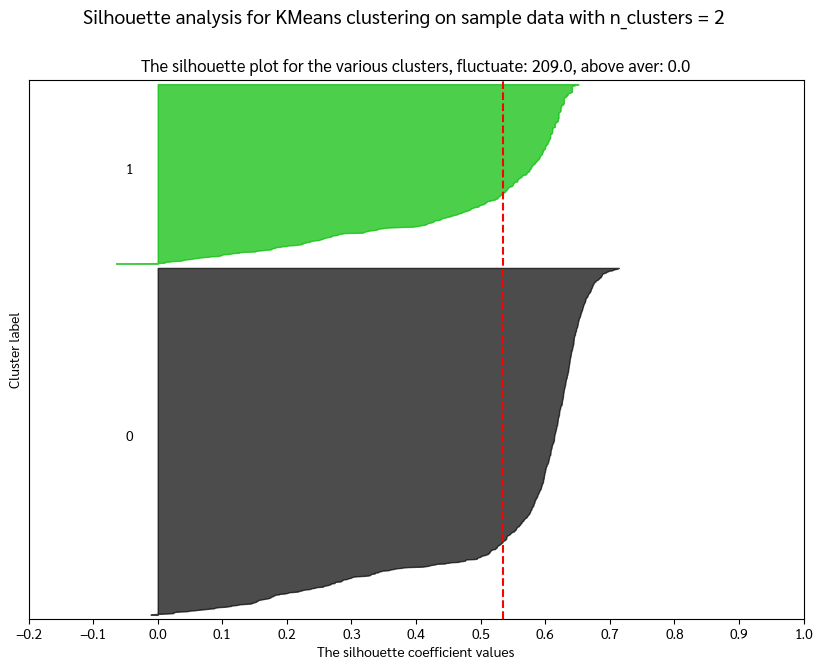

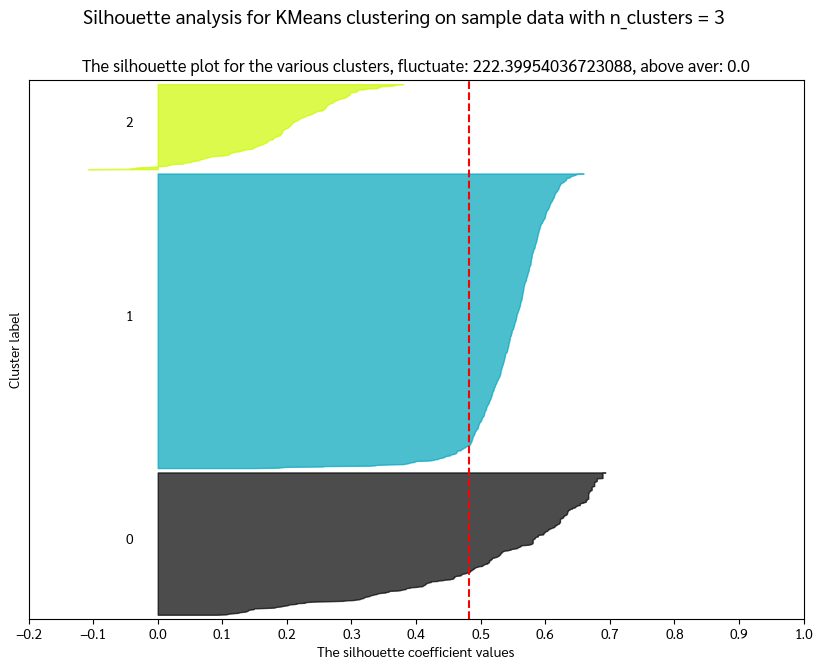

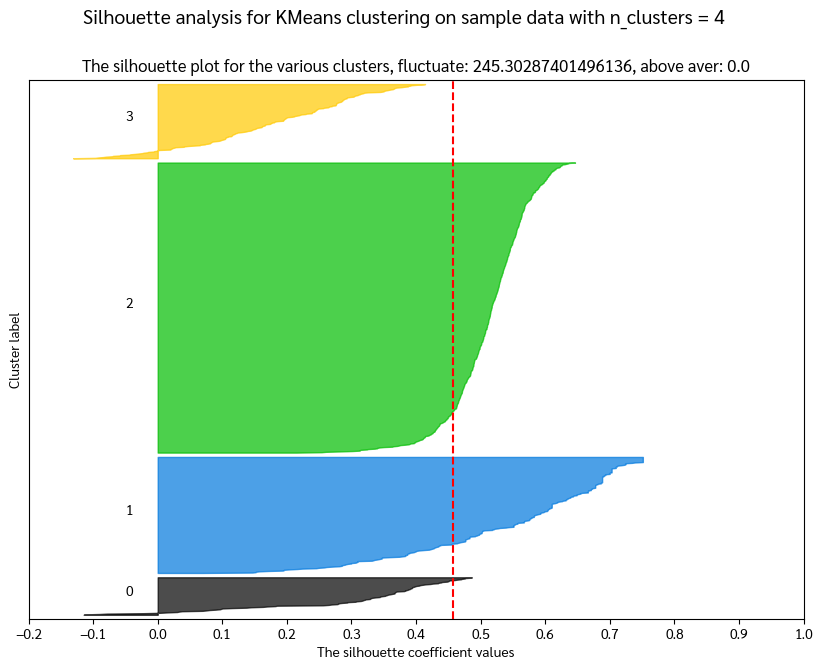

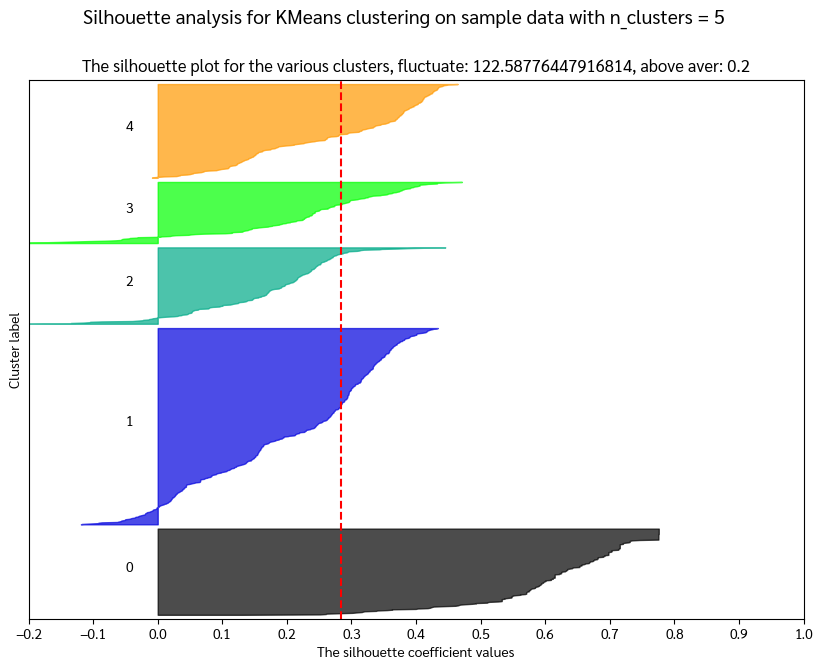

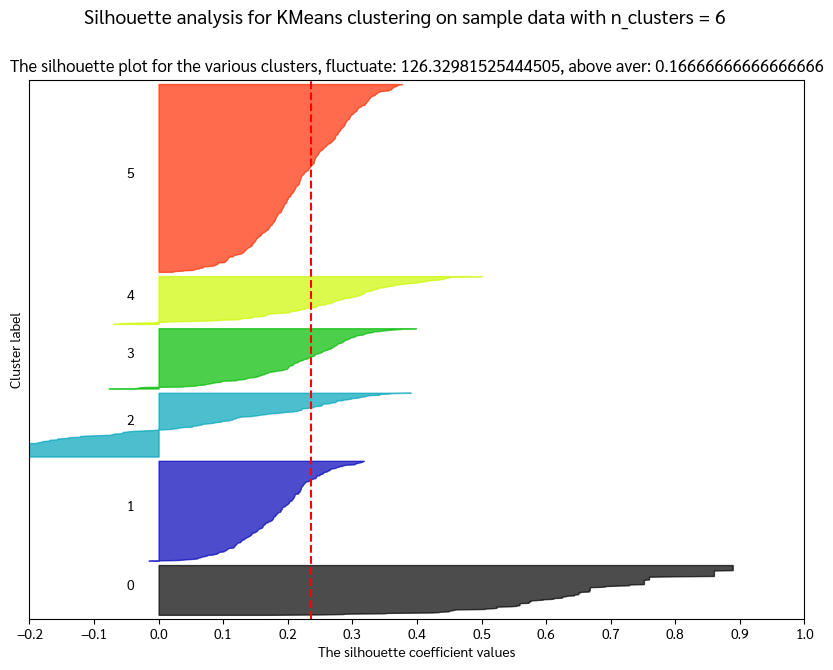

...

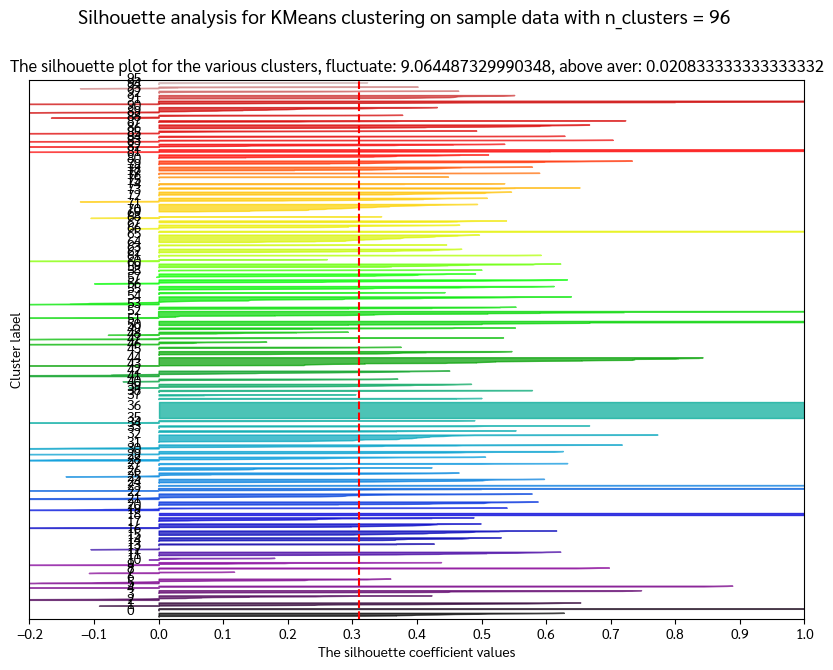

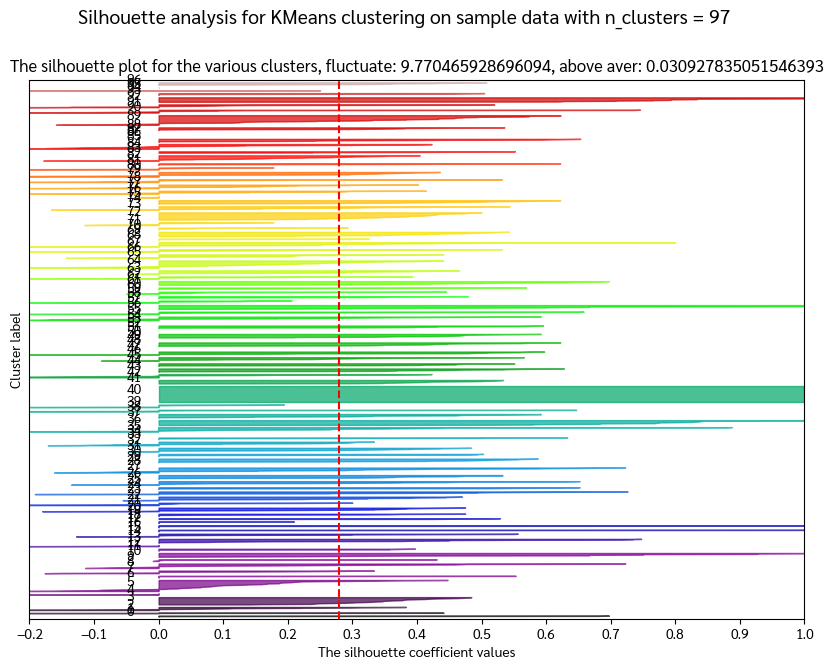

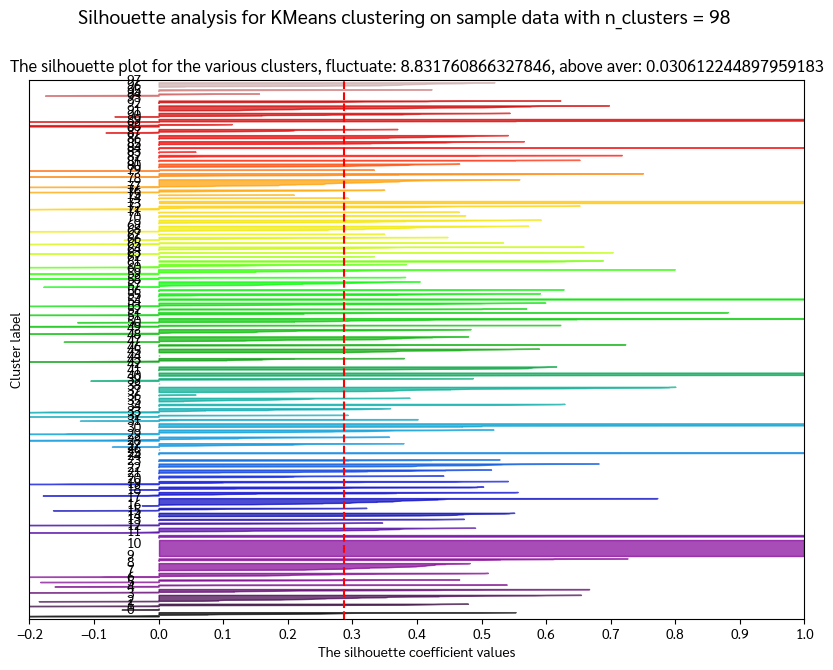

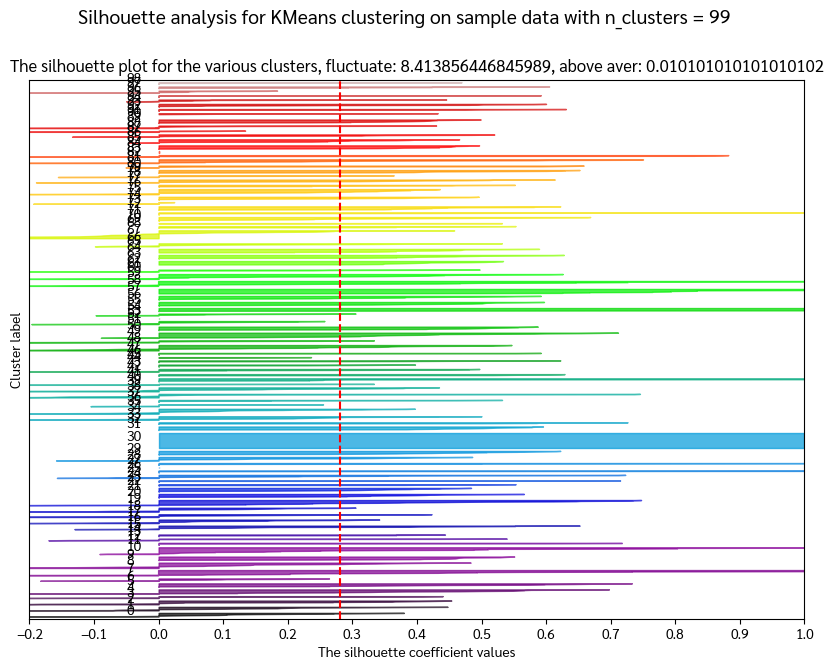

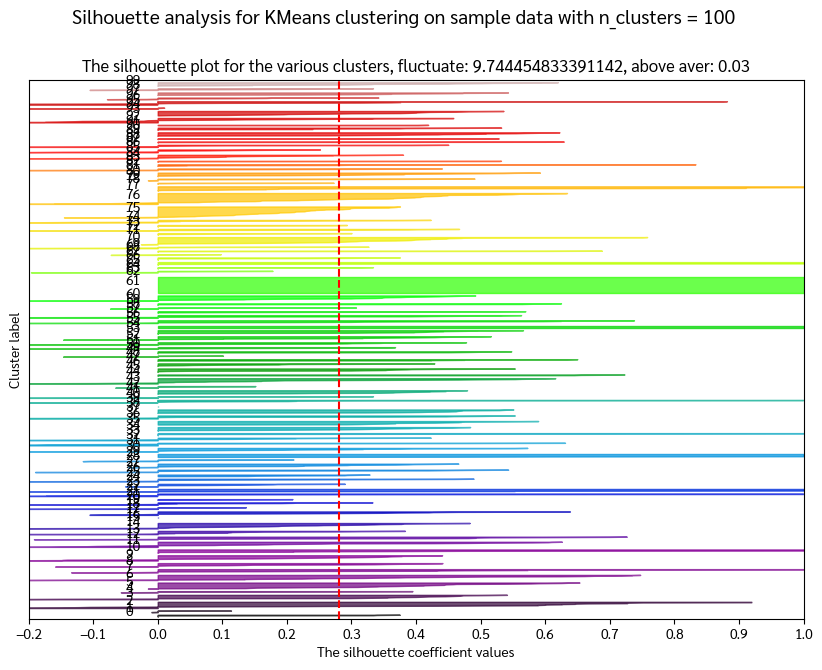

In [827]:
# For reproducibility
range_n_clusters = range(2,101)
cluster_fluctuation = []
cluster_above_avr = []
silhouette_avg_total = []

client = Client()  # Set up a Dask client, which provides a dashboard for monitoring performance

for n_clusters in tqdm(range_n_clusters):
    sample_silhouette_values, silhouette_avg, cluster_labels = parallel_silhouette_score(X, n_clusters)
    print(f"Done: {n_clusters}")
    
    # result = parallel_silhouette_score(X_dask, n_clusters=n_clusters)
    # sample_silhouette_values, silhouette_avg, cluster_labels = compute(result)  # Trigger the computation
    # # 
    
    silhouette_avg_total.append(silhouette_avg)
    amount_clusters_pass_avg = 0
     # Create a subplot with 1 row and 2 columns
    fig, ax1 = plt.subplots(1, 1)
    fig.set_size_inches(10, 7)

    # The 1st subplot is the silhouette plot
    # The silhouette coefficient can range from -1, 1 but in this example all
    # lie within [-0.1, 1]
    ax1.set_xlim([-0.2, 1])
    # The (n_clusters+1)*10 is for inserting blank space between silhouette
    # plots of individual clusters, to demarcate them clearly.
    ax1.set_ylim([0, len(X) + (n_clusters + 1) * 10])

    y_lower = 10
    for i in range(n_clusters):
        # Aggregate the silhouette scores for samples belonging to
        # cluster i, and sort them
        ith_cluster_silhouette_values = sample_silhouette_values[cluster_labels == i]
        
        below_avg = np.sum(ith_cluster_silhouette_values < silhouette_avg)
        if below_avg < 0.05 * len(ith_cluster_silhouette_values):
            amount_clusters_pass_avg += 1

        ith_cluster_silhouette_values.sort()

        size_cluster_i = ith_cluster_silhouette_values.shape[0]
        y_upper = y_lower + size_cluster_i

        color = cm.nipy_spectral(float(i) / n_clusters)
        ax1.fill_betweenx(
            np.arange(y_lower, y_upper),
            0,
            ith_cluster_silhouette_values,
            facecolor=color,
            edgecolor=color,
            alpha=0.7,
        )

        # Label the silhouette plots with their cluster numbers at the middle
        ax1.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

        # Compute the new y_lower for next plot
        y_lower = y_upper + 10  # 10 for the 0 samples
        
    cluster_sizes = np.bincount(cluster_labels)
    size_fluctuation = np.std(cluster_sizes)
    
    cluster_above_avr.append(amount_clusters_pass_avg/n_clusters)
    cluster_fluctuation.append(size_fluctuation)
    
    print(
         f"For n_clusters = {n_clusters}, ",
         f"The average silhouette_score is : {silhouette_avg}, ", 
         f"Size fluctuation is : {size_fluctuation}, ",
         f"Percentage of clusters which above average : {amount_clusters_pass_avg/n_clusters}, "
    )

    ax1.set_title(f"The silhouette plot for the various clusters, fluctuate: {size_fluctuation}, above aver: {amount_clusters_pass_avg/n_clusters}")
    ax1.set_xlabel("The silhouette coefficient values")
    ax1.set_ylabel("Cluster label")

    # The vertical line for average silhouette score of all the values
    ax1.axvline(x=silhouette_avg, color="red", linestyle="--")

    ax1.set_yticks([])  # Clear the yaxis labels / ticks
    ax1.set_xticks([-0.2, -0.1, 0, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1])
    

    plt.suptitle(
        "Silhouette analysis for KMeans clustering on sample data with n_clusters = %d"
        % n_clusters,
        fontsize=14,
        fontweight="bold",
    )
    
    img_name = f"Cluster{n_clusters}"
    plt.savefig(f'{silhouette_path}{img_name}.png')

In [828]:
silhouette_df = pd.DataFrame({"number_cluster": range_n_clusters,
                              "fluctuation": cluster_fluctuation,
                              "silhouette_avg":silhouette_avg_total, 
                              "cluster_above_avg":cluster_above_avr})
silhouette_df.to_csv(silhouette_path+'silhouette_df.csv',index=False)
silhouette_df.sample(3)

,number_cluster,fluctuation,silhouette_avg,cluster_above_avg
80,82,10.280104,0.306590,0.036585
87,89,9.542892,0.301338,0.011236
35,37,17.498325,0.294599,0.027027


In [829]:
best_number_cluster = silhouette_df.sort_values(['cluster_above_avg'], 
                      ascending=False).head(20).sort_values(['fluctuation'], 
                      ascending=False).head(5)['number_cluster'].values[4]
best_number_cluster
# 18

15

## Runner - Clustering with optimal K

In [830]:
# primaryType_comb_list = df['primaryType_comb'].tolist()
# print(len(primaryType_comb_list))

# cat_to_num, num_to_cat= create_categorical_numerical_pair(primaryType_comb_list)
cat_to_num = {'NONE': 0,
  'Agriculture': 1,
  'Art and Culture': 2,
  'Conference and Community': 3,
  'Education': 4,
  'Entertainment': 5,
  'Food and Drink': 6,
  'Healthcare and Wellness': 7,
  'Hotel': 8,
  'Religion': 9,
  'Service': 10,
  'Shop and Store': 11,
  'Sport': 12,
  'Tourism': 13}
num_to_cat =  {0: 'NONE',
  1: 'Agriculture',
  2: 'Art and Culture',
  3: 'Conference and Community',
  4: 'Education',
  5: 'Entertainment',
  6: 'Food and Drink',
  7: 'Healthcare and Wellness',
  8: 'Hotel',
  9: 'Religion',
  10: 'Service',
  11: 'Shop and Store',
  12: 'Sport',
  13: 'Tourism'}

In [831]:
# import dask.array as da

# def preprocess_dask(data, categorical_to_numerical, numerical_to_categorical, padding=True, encoding=True, padding_tag=0):
#     max_length = len(max(data, key=len))  # This needs to be computed beforehand if data is very large

#     def process_sequence(subsequence):
#         if encoding:
#             sequence = [categorical_to_numerical.get(point, padding_tag) for point in subsequence]
#         else:
#             sequence = list(subsequence)

#         if padding and len(sequence) < max_length:
#             sequence.extend([padding_tag] * (max_length - len(sequence)))

#         return sequence

#     # Apply the processing function to each sequence
#     result = list(map(process_sequence, data))
#     return da.from_array(np.array(result), chunks=(1000, max_length))  # Adjust chunk size based on your system's memory

# # Example usage
# # categorical_to_numerical, numerical_to_categorical = create_categorical_numerical_pair(data_list)
# primaryType_comb_list =  df['primaryType_comb'].tolist()
# # primaryType_comb_list = [list(k) for i in primaryType_comb_list for k in i]

# X = preprocess_dask(primaryType_comb_list, cat_to_num, num_to_cat)
# X = X.compute()  # This line triggers the actual computation
# np.random.shuffle(X)
# X.shape

In [832]:
# X = np.array(preprocess(primaryType_comb_list, cat_to_num, num_to_cat))
# # X = minibatch_sparse_pca(X, n_components = int(X.shape[1] * 0.6))
# np.random.shuffle(X)
# X.shape

In [833]:
cluster_dict, labels = mini_batchmeans_clustering(X, n_clusters=best_number_cluster, decompose_size = 5, batch_size = 2048, decompose = False, n_init=10)

Init 1/2 with method k-means++
Inertia for init 1/2: 3528.0
Init 2/2 with method k-means++
Inertia for init 2/2: 3558.0
[MiniBatchKMeans] Reassigning 1 cluster centers.
Minibatch step 1/12337: mean batch inertia: 51.5
Minibatch step 2/12337: mean batch inertia: 37.45789930555555, ewa inertia: 37.45789930555555
Minibatch step 3/12337: mean batch inertia: 34.32651661214255, ewa inertia: 37.30572884816874
Minibatch step 4/12337: mean batch inertia: 32.38753784534689, ewa inertia: 37.06672791864665
Minibatch step 5/12337: mean batch inertia: 26.270883542462702, ewa inertia: 36.54210070522541
[MiniBatchKMeans] Reassigning 3 cluster centers.
Minibatch step 6/12337: mean batch inertia: 23.19011949083217, ewa inertia: 35.8932572749132
Minibatch step 7/12337: mean batch inertia: 26.74793735174706, ewa inertia: 35.44883777978592
Minibatch step 8/12337: mean batch inertia: 24.364963744403003, ewa inertia: 34.91021368087589
Minibatch step 9/12337: mean batch inertia: 24.136542148179498, ewa inerti

In [834]:
import pickle

# # save dictionary to person_data.pkl file
# with open('./cluster52_2020set1_10032024.pkl', 'wb') as fp:
#     pickle.dump(cluster_dict, fp)
#     print('dictionary saved successfully to file')

with open(cluster_output_path+'labels.pkl', 'wb') as fp:
    pickle.dump(labels, fp)
    print('dictionary saved successfully to file')

dictionary saved successfully to file


In [835]:
with open(cluster_output_path+f'cluster_dict.pkl', 'wb') as f:
    pickle.dump(cluster_dict, f)

In [836]:
df['labels'] = labels
df.head(5)

,urls,keyword,text,places,place_infos,filtered_places,filtered_rename_places,primaryType,subType,activities,primaryType_comb,activity_comb,rename_activity_comb,primaryType_len,labels
0,https://www.facebook.com/groups/paikondieow/pe...,trip,"ONE DAY TRIP บางแสน , ชลบุรี_____หนึ่งวันกับกา...","[""บางแสน"", ""ชลบุรี"", ""กรุงเทพ"", ""หาดบางแสน"", ""...","[{'types': ['neighborhood', 'political'], 'add...","['หาดบางแสน', 'สะพานมารควิถี']","['Bang Saen Ville', 'Cholmarkwithi Bridge']","[[Tourism], [Tourism]]","[['neighborhood'], ['tourist_attraction']]","[{""place"": ""หาดบางแสน"", ""activity"": [""ถ่ายรูป""...","[Tourism, Tourism]","[('ถ่ายรูป',)]",[['Photography']],2,3
1,https://www.facebook.com/groups/paikondieow/pe...,มกรา,เที่ยวโฮมสเตย์ชาวเขา ที่พักบนดอย ต.ช้างกื้ด อ...,"[""ดอย"", ""ต.ช้างกื้ด"", ""อ.แม่แตง"", ""จ.เชียงใหม่...","[{'types': ['private_guest_room', 'lodging', '...","['บ้านห้วยกุ๊บกั๊บ', 'บ้านซุกกิ๊กโฮมสเตย์', 'ป...","['บ้านฝ้ายโฮมสเตย์ บ้านห้วยกุ๊บกั๊บ', 'Baansuk...","[[Hotel], [Hotel], [Tourism]]","[['private_guest_room', 'lodging'], ['private_...",<NA>,"[Hotel, Hotel, Tourism]",[],[],3,14
2,https://www.facebook.com/groups/paikondieow/pe...,มิถุนายน,ทุ่งบัวสวรรค์ (ทุ่งดอกกระเจียว) อช ไทรทอง อ หน...,"[""ทุ่งบัวสวรรค์"", ""ทุ่งดอกกระเจียว"", ""อช ไทรทอ...","[{'types': ['tourist_attraction', 'point_of_in...","['ทุ่งบัวสวรรค์', 'ทุ่งดอกกระเจียว', 'อช ไทรทอง']","['Bua Sawan field or Krachiao flower field', '...","[[Tourism], [Tourism], [Tourism]]","[['tourist_attraction'], ['tourist_attraction'...","[{""place"": ""ทุ่งบัวสวรรค์"", ""activity"": []}, {...","[Tourism, Tourism, Tourism]",[()],[[]],3,13
3,https://www.facebook.com/groups/paikondieow/pe...,กันยายน,ยิ่งยงสวนดอกไม้ เชียงใหม่สวนดอกไม้ บนยอดดอยม...,"[""ดอยม่อนแจ่ม"", ""เชียงใหม่"", ""บ้านภูหมอก""]","[{'types': ['food', 'point_of_interest', 'stor...","['ดอยม่อนแจ่ม', 'บ้านภูหมอก']","['ม่อนแจ่ม(แซลมอนxซูชิ)สาขาบางใหญ่', 'Baan Phu...","[[Shop and Store, Food and Drink], [Hotel]]","[['store', 'food'], ['private_guest_room', 'lo...",<NA>,"[Shop and Store, Hotel]",[],[],2,5
4,https://www.facebook.com/groups/paikondieow/pe...,กันยายน,ยิ่งยงสวนดอกไม้ เชียงใหม่สวนดอกไม้ บนยอดดอยม...,"[""ดอยม่อนแจ่ม"", ""เชียงใหม่"", ""บ้านภูหมอก""]","[{'types': ['food', 'point_of_interest', 'stor...","['ดอยม่อนแจ่ม', 'บ้านภูหมอก']","['ม่อนแจ่ม(แซลมอนxซูชิ)สาขาบางใหญ่', 'Baan Phu...","[[Shop and Store, Food and Drink], [Hotel]]","[['store', 'food'], ['private_guest_room', 'lo...",<NA>,"[Food and Drink, Hotel]",[],[],2,8


In [837]:
df

,urls,keyword,text,places,place_infos,filtered_places,filtered_rename_places,primaryType,subType,activities,primaryType_comb,activity_comb,rename_activity_comb,primaryType_len,labels
0,https://www.facebook.com/groups/paikondieow/pe...,trip,"ONE DAY TRIP บางแสน , ชลบุรี_____หนึ่งวันกับกา...","[""บางแสน"", ""ชลบุรี"", ""กรุงเทพ"", ""หาดบางแสน"", ""...","[{'types': ['neighborhood', 'political'], 'add...","['หาดบางแสน', 'สะพานมารควิถี']","['Bang Saen Ville', 'Cholmarkwithi Bridge']","[[Tourism], [Tourism]]","[['neighborhood'], ['tourist_attraction']]","[{""place"": ""หาดบางแสน"", ""activity"": [""ถ่ายรูป""...","[Tourism, Tourism]","[('ถ่ายรูป',)]",[['Photography']],2,3
1,https://www.facebook.com/groups/paikondieow/pe...,มกรา,เที่ยวโฮมสเตย์ชาวเขา ที่พักบนดอย ต.ช้างกื้ด อ...,"[""ดอย"", ""ต.ช้างกื้ด"", ""อ.แม่แตง"", ""จ.เชียงใหม่...","[{'types': ['private_guest_room', 'lodging', '...","['บ้านห้วยกุ๊บกั๊บ', 'บ้านซุกกิ๊กโฮมสเตย์', 'ป...","['บ้านฝ้ายโฮมสเตย์ บ้านห้วยกุ๊บกั๊บ', 'Baansuk...","[[Hotel], [Hotel], [Tourism]]","[['private_guest_room', 'lodging'], ['private_...",<NA>,"[Hotel, Hotel, Tourism]",[],[],3,14
2,https://www.facebook.com/groups/paikondieow/pe...,มิถุนายน,ทุ่งบัวสวรรค์ (ทุ่งดอกกระเจียว) อช ไทรทอง อ หน...,"[""ทุ่งบัวสวรรค์"", ""ทุ่งดอกกระเจียว"", ""อช ไทรทอ...","[{'types': ['tourist_attraction', 'point_of_in...","['ทุ่งบัวสวรรค์', 'ทุ่งดอกกระเจียว', 'อช ไทรทอง']","['Bua Sawan field or Krachiao flower field', '...","[[Tourism], [Tourism], [Tourism]]","[['tourist_attraction'], ['tourist_attraction'...","[{""place"": ""ทุ่งบัวสวรรค์"", ""activity"": []}, {...","[Tourism, Tourism, Tourism]",[()],[[]],3,13
3,https://www.facebook.com/groups/paikondieow/pe...,กันยายน,ยิ่งยงสวนดอกไม้ เชียงใหม่สวนดอกไม้ บนยอดดอยม...,"[""ดอยม่อนแจ่ม"", ""เชียงใหม่"", ""บ้านภูหมอก""]","[{'types': ['food', 'point_of_interest', 'stor...","['ดอยม่อนแจ่ม', 'บ้านภูหมอก']","['ม่อนแจ่ม(แซลมอนxซูชิ)สาขาบางใหญ่', 'Baan Phu...","[[Shop and Store, Food and Drink], [Hotel]]","[['store', 'food'], ['private_guest_room', 'lo...",<NA>,"[Shop and Store, Hotel]",[],[],2,5
4,https://www.facebook.com/groups/paikondieow/pe...,กันยายน,ยิ่งยงสวนดอกไม้ เชียงใหม่สวนดอกไม้ บนยอดดอยม...,"[""ดอยม่อนแจ่ม"", ""เชียงใหม่"", ""บ้านภูหมอก""]","[{'types': ['food', 'point_of_interest', 'stor...","['ดอยม่อนแจ่ม', 'บ้านภูหมอก']","['ม่อนแจ่ม(แซลมอนxซูชิ)สาขาบางใหญ่', 'Baan Phu...","[[Shop and Store, Food and Drink], [Hotel]]","[['store', 'food'], ['private_guest_room', 'lo...",<NA>,"[Food and Drink, Hotel]",[],[],2,8
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1311,https://www.facebook.com/groups/paikondieow/pe...,พระนครศรีอยุธยา,คาเฟ่บรรยากาศบ้านสวน พร้อมมุมถ่ายภาพสวยๆ @ บ้า...,"[""บ้านสวนรอยจรัล"", ""ต.วัดตูม"", ""พระนครศรีอยุธยา""]","[{'types': ['restaurant', 'point_of_interest',...","['บ้านสวนรอยจรัล', 'ต.วัดตูม']","['บ้านสวนรอยจรัล', 'Wat Tum']","[[Food and Drink], [Religion, Tourism]]","[['restaurant', 'food'], ['tourist_attraction'...",<NA>,"[Food and Drink, Tourism]",[],[],2,4
1312,https://www.facebook.com/groups/paikondieow/pe...,มิถุนายน,#โพสต์เดียวครบ — [ รวม 20 พิกัด ] [ #เกาะล้า...,"[""เกาะล้าน"", ""หาดสังวาลย์"", ""Sangwan beach vil...","[{'types': ['restaurant', 'food', 'point_of_in...","['Sangwan beach villa', 'หาดตาแหวน', 'หาดทองหล...","['Sangwan Beach', 'Tawaen', 'Tong Lang Beach',...","[[Food and Drink], [Tourism], [Tourism], [Tour...","[['food', 'restaurant'], ['natural_feature'], ...","[{""place"": ""Sangwan beach villa"", ""activity"": ...","[Food and Drink, Tourism, Tourism, Tourism]",[()],[[]],4,14
1313,https://www.facebook.com/groups/paikondieow/pe...,เพื่อนร่วม,คาเฟ่วิวหลักล้าน | ม่อนสกาดคาเฟ่ ................,"[""ม่อนสกาดคาเฟ่"", ""น่าน"", ""ดอยสกาด"", ""สกาด"", ""...","[{'types': ['private_guest_room', 'lodging', '...","['ม่อนสกาดคาเฟ่', 'ดอยสกาด']","['ม่อนสกาดคาเฟ่&ฟาร์มสเตย์ ดอยสกาด', 'Baan Mom...","[[Hotel], [Hotel]]","[['private_guest_room', 'lodging'], ['private_...",<NA>,"[Hotel, Hotel]",[],[],2,10
1314,https://www.facebook.com/gro

In [838]:
df.to_csv(year+'.csv', index=False)

In [839]:
# %%time
# df = pd.read_csv(year+'.csv')
# _df = dd.from_pandas(df, npartitions=10)
# _df.to_parquet('dataset/'+year+'/dataset.parquet', engine='pyarrow')

In [840]:
# find top-10 best condensed clusters
sample_silhouette_values, silhouette_avg, cluster_labels = parallel_silhouette_score(X, best_number_cluster)
avg_positive_samples = []
positive_samples = []


for i in range(0, best_number_cluster):
    # Aggregate the silhouette scores for samples belonging to
    # cluster i, and sort them
    ith_cluster_silhouette_values = sample_silhouette_values[cluster_labels == i]

    avg_positive_samples.append(np.mean(0 < ith_cluster_silhouette_values))
    positive_samples.append(np.sum(0 < ith_cluster_silhouette_values))    

Init 1/2 with method k-means++
Inertia for init 1/2: 3528.0
Init 2/2 with method k-means++
Inertia for init 2/2: 3558.0
[MiniBatchKMeans] Reassigning 1 cluster centers.
Minibatch step 1/12337: mean batch inertia: 51.5
Minibatch step 2/12337: mean batch inertia: 37.45789930555555, ewa inertia: 37.45789930555555
Minibatch step 3/12337: mean batch inertia: 34.32651661214255, ewa inertia: 37.30572884816874
Minibatch step 4/12337: mean batch inertia: 32.38753784534689, ewa inertia: 37.06672791864665
Minibatch step 5/12337: mean batch inertia: 26.270883542462702, ewa inertia: 36.54210070522541
[MiniBatchKMeans] Reassigning 3 cluster centers.
Minibatch step 6/12337: mean batch inertia: 23.19011949083217, ewa inertia: 35.8932572749132
Minibatch step 7/12337: mean batch inertia: 26.74793735174706, ewa inertia: 35.44883777978592
Minibatch step 8/12337: mean batch inertia: 24.364963744403003, ewa inertia: 34.91021368087589
Minibatch step 9/12337: mean batch inertia: 24.136542148179498, ewa inerti

In [841]:
positive_clusters = pd.DataFrame({'cluster number':range(0, best_number_cluster), 'mean silhouette score of samples silhouette > 0':avg_positive_samples,
                                 'number of samples silhouette > 0':positive_samples
                                 })
positive_clusters.to_csv(cluster_output_path+'silaverage_silhouette_more_0.csv', index=False)
positive_clusters[positive_clusters['mean silhouette score of samples silhouette > 0'] > 0.8].sort_values(by=['number of samples silhouette > 0'], ascending=False).reset_index(drop=True).to_csv(cluster_output_path+'best_clusters.csv', index=False)

In [842]:
best_clusters = pd.read_csv('dataset/'+year+'/place_clustering/pattern/best_clusters.csv')['cluster number'].tolist()

In [843]:
len(unique(cluster_labels)), len(unique(labels))

(15, 15)

In [844]:
cluster_dict.keys()

dict_keys([3, 14, 13, 5, 8, 4, 1, 0, 2, 9, 7, 10, 6, 12, 11])

  0%|          | 0/15 [00:00<?, ?it/s]

C:\Users\researcher01\AppData\Local\Temp\3\ipykernel_11276\1952901627.py:22: UserWarning:

This figure was using a layout engine that is incompatible with subplots_adjust and/or tight_layout; not calling subplots_adjust.



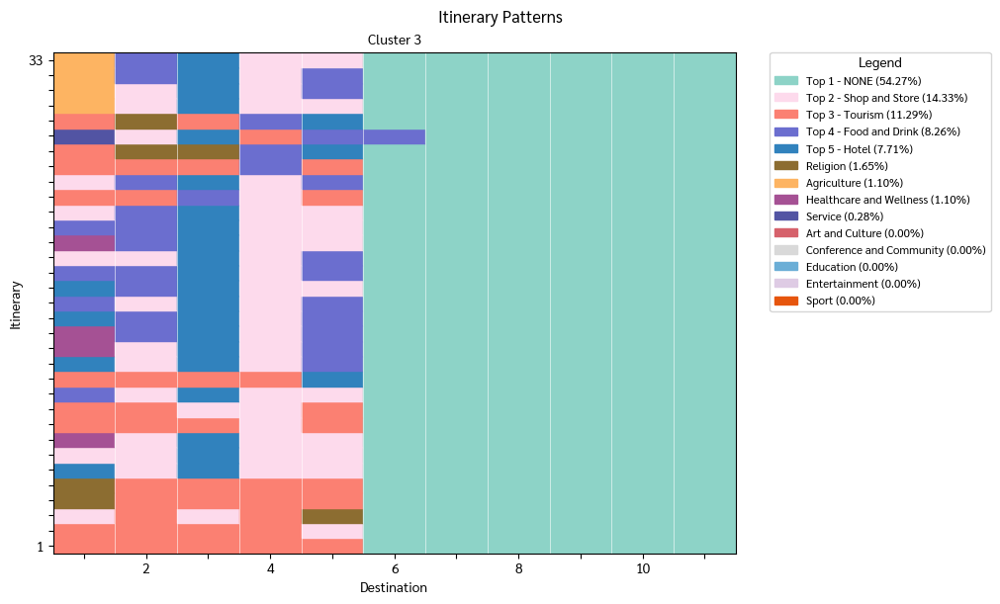

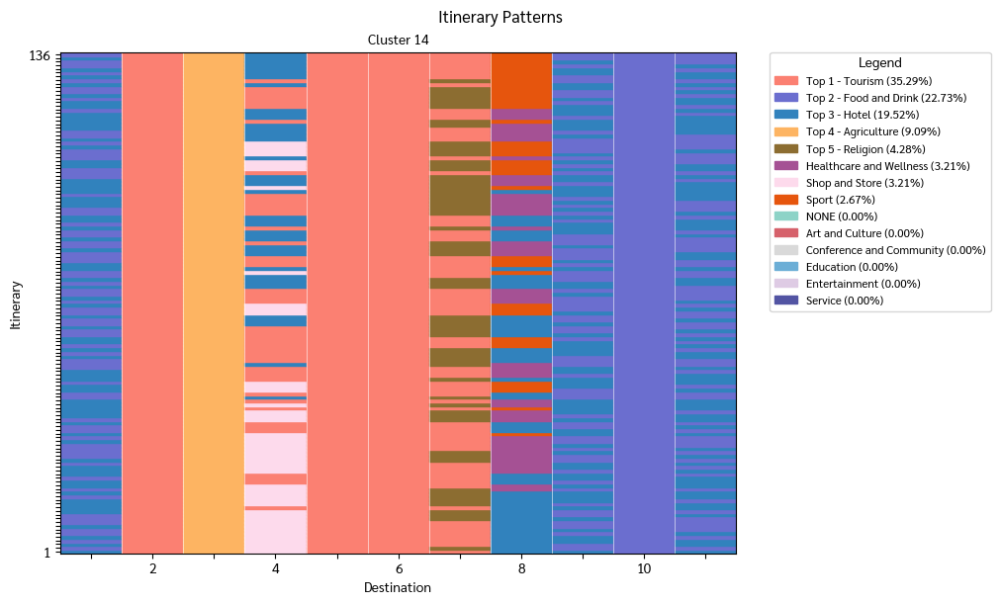

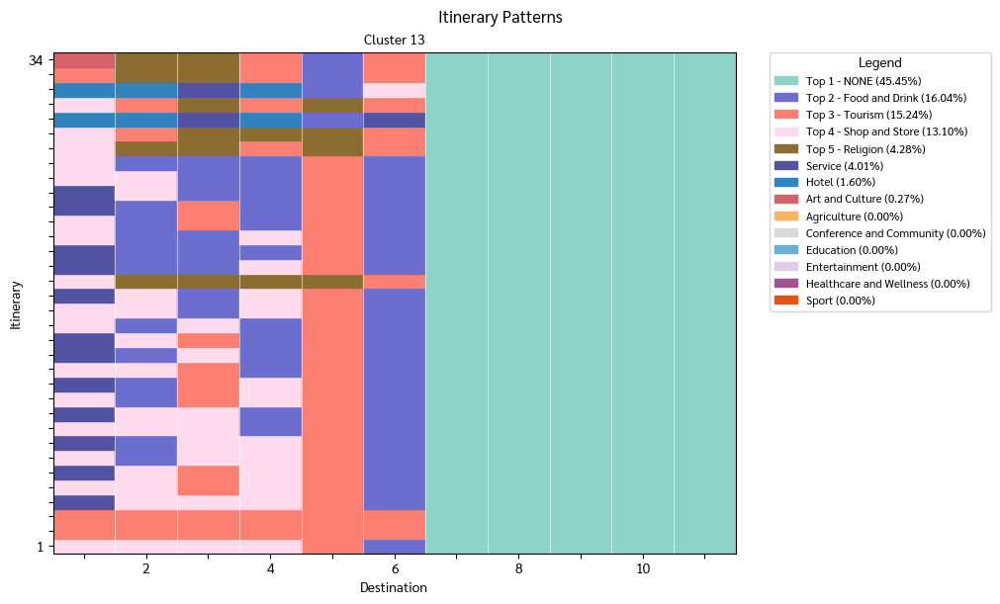

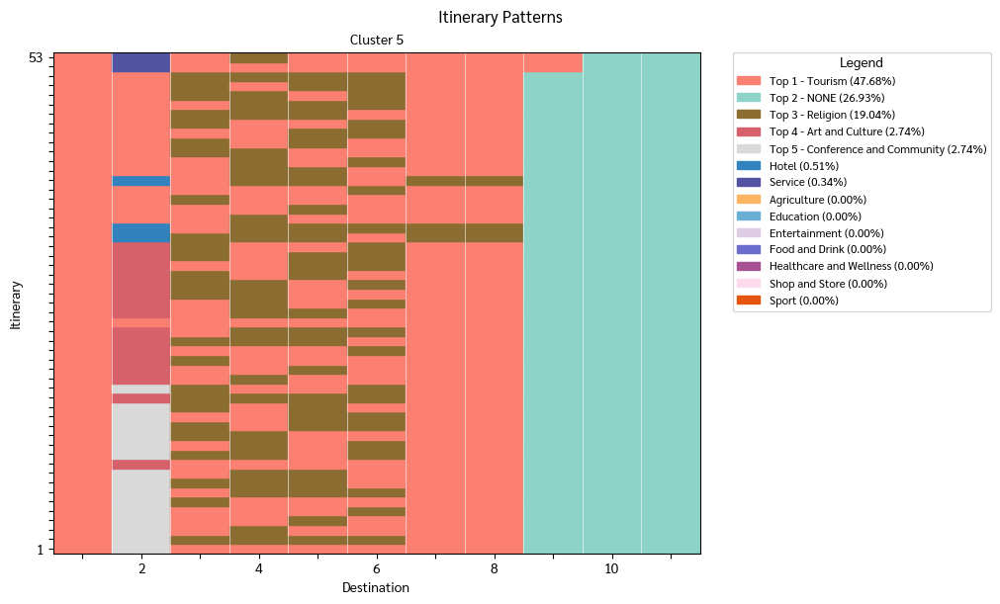

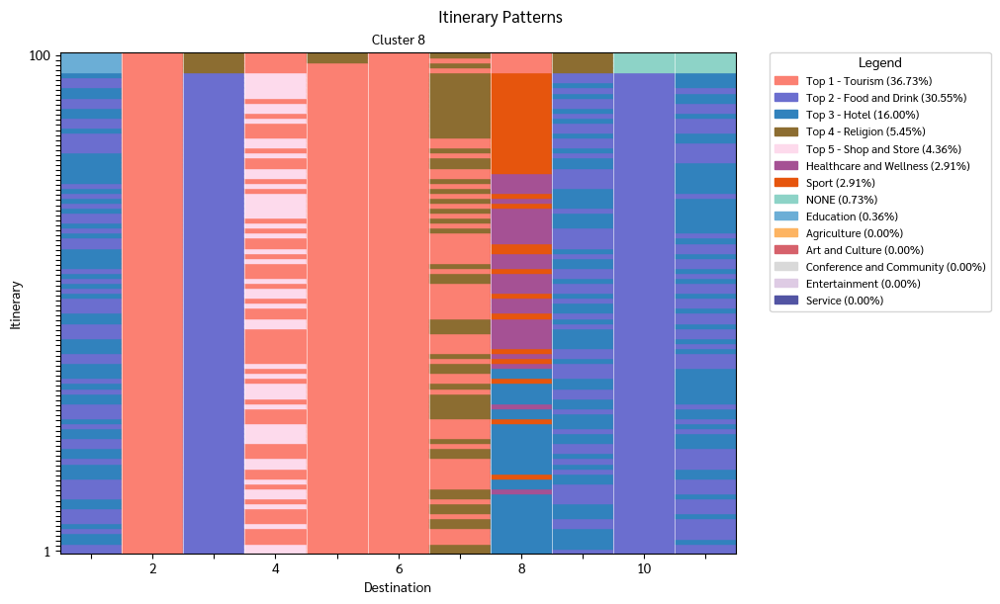

...

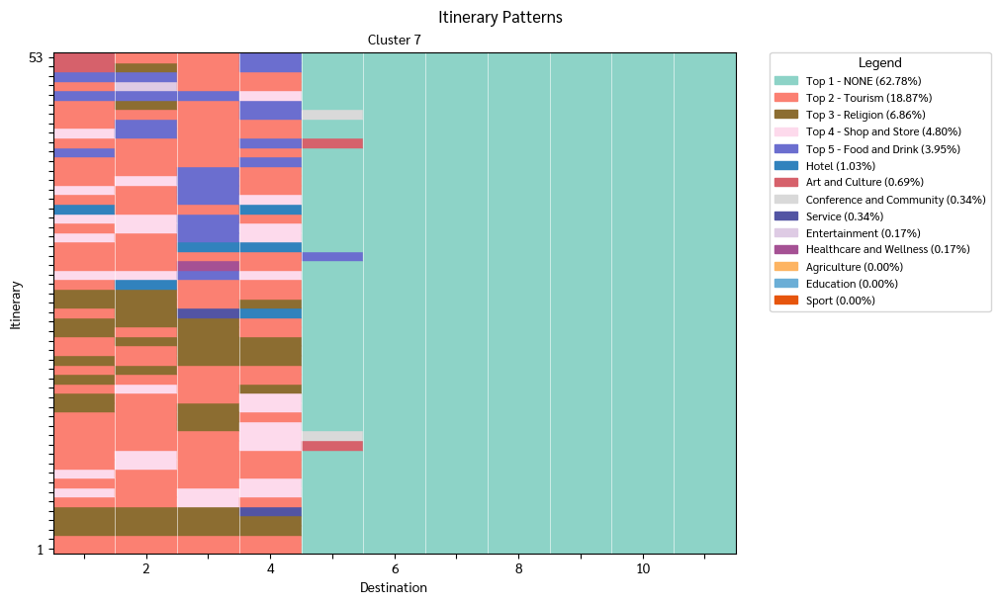

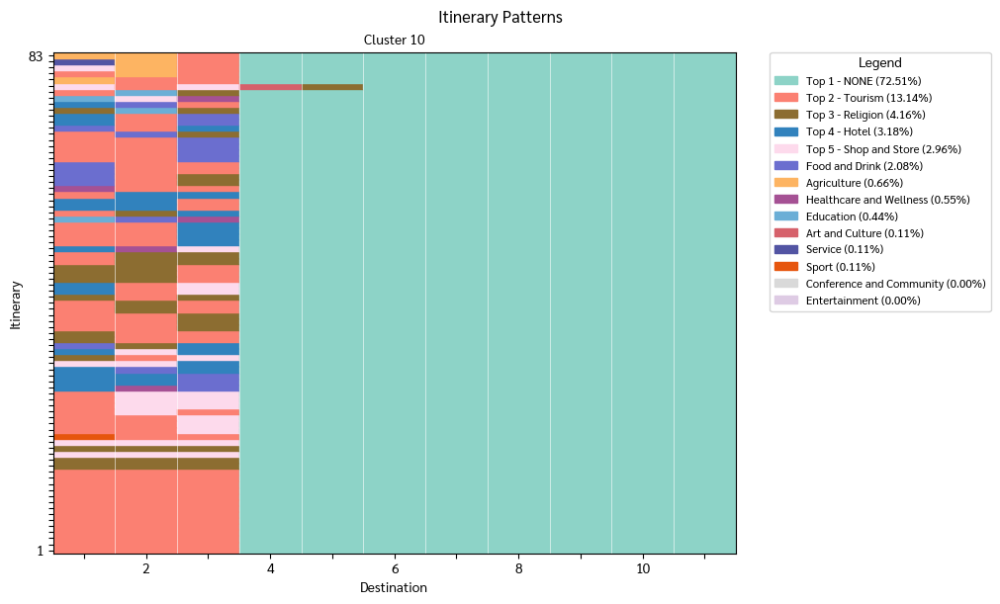

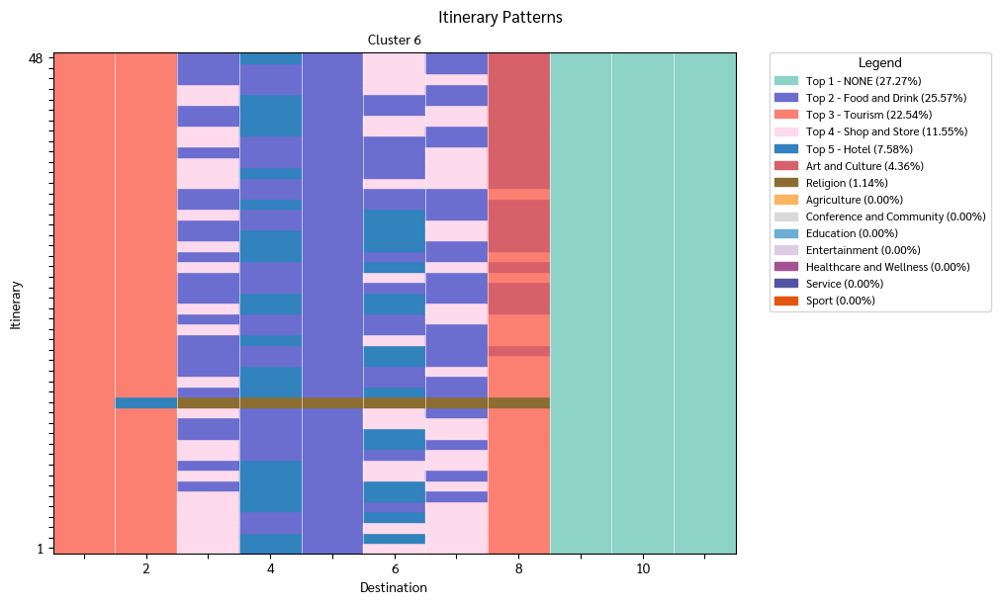

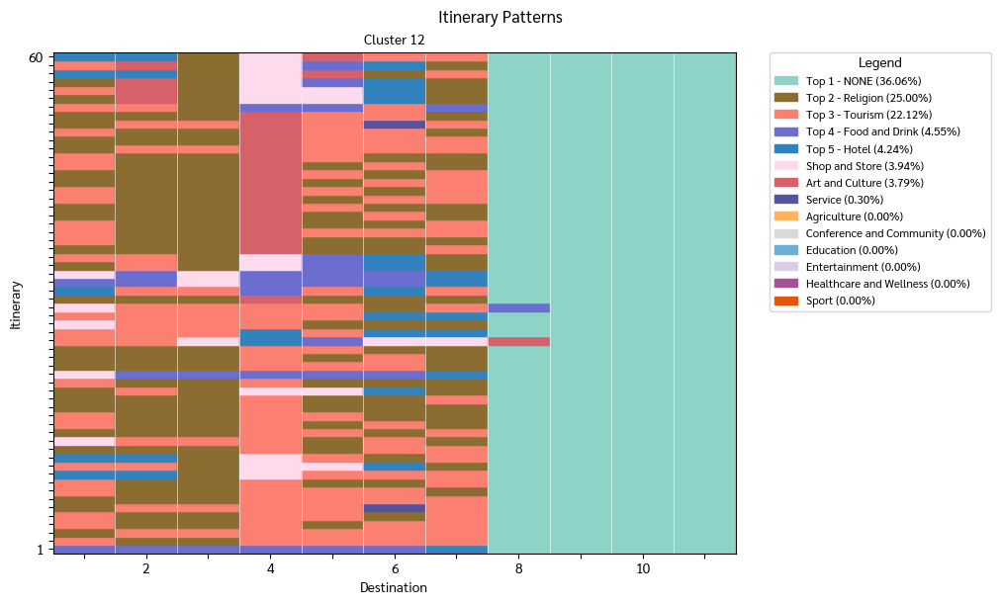

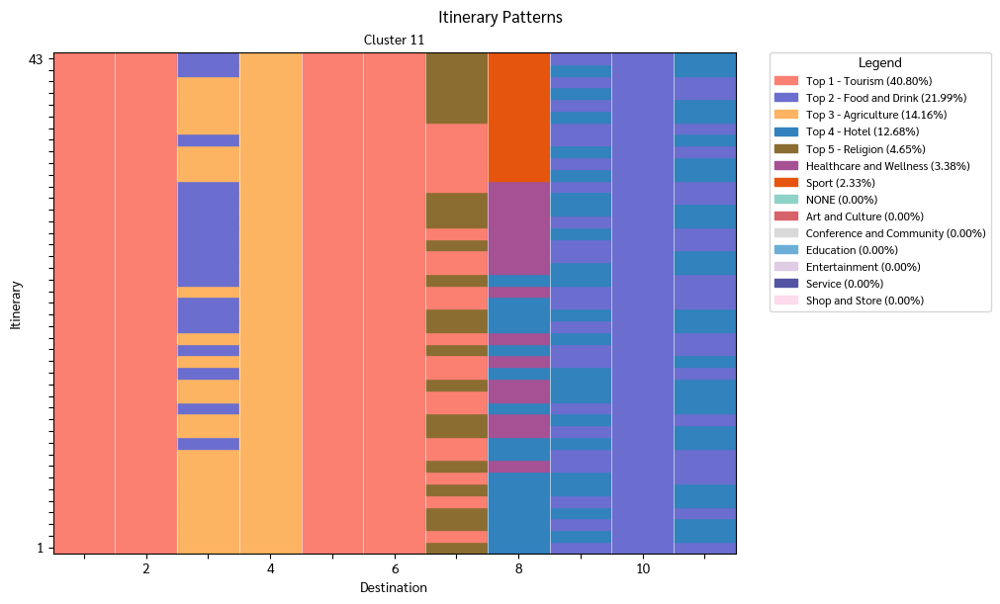

In [845]:
# for key in tqdm(best_clusters):
for key in tqdm(cluster_dict.keys()):
    new_dict = {}
    new_dict[key] = cluster_dict[key]
    plot_patches(new_dict, cat_to_num, num_to_cat,random_seed=84)

## Runner - Process Mining

In [846]:
best_clusters = pd.read_csv('dataset/'+year+'/place_clustering/pattern/best_clusters.csv')['cluster number'].tolist()

In [847]:
# Mocking the date times for the event log column
start_date = datetime(1678, 1, 1)  # Mock start date

def generate_datetime(x):
    date_offset = timedelta(days=x['CaseID'] - 1)  # Days offset based on original index
    hour_offset = timedelta(hours=x['EventID'] - 1)  # Hours offset based on caseID
    # return (start_date + date_offset + hour_offset).strftime('%d-%m-%Y:%H.%M')
    return (start_date + date_offset + hour_offset).strftime('%Y-%m-%d  %H:%M:%S')

In [848]:
# prepare data to use in pm4py from list to xes
def create_eventlog_df(data):
  sample_df = pd.DataFrame({'Activity':data})

  sample_df  = pd.DataFrame(sample_df['Activity'].explode()).reset_index().rename(columns={"index":"CaseID"})
  sample_df['CaseID'] += 1

  sample_df = sample_df[sample_df['Activity']!=0]
  sample_df = sample_df.reset_index(drop=True)

  sample_df = sample_df.reset_index().rename(columns={"index":"EventID"})
  sample_df['EventID'] += 1

  sample_df['timestamp'] = sample_df.apply(generate_datetime, axis = 1)
  sample_df['timestamp'] = pd.to_datetime(sample_df['timestamp'], format='%Y-%m-%d  %H:%M:%S')

  # Reorder Columns
  cols = sample_df.columns.tolist()
  cols = cols[1:2] + cols[0:1] + cols[2:]
  sample_df = sample_df[cols]

  sample_df = sample_df.replace({"Activity":num_to_cat})

  return sample_df

In [849]:
def create_eventlog_pm4py(data):
  sample_df = pm4py.format_dataframe(data, case_id='CaseID', activity_key='Activity',
                                   timestamp_key='timestamp')
  log = pm4py.convert_to_event_log(sample_df)

  return log

In [850]:
def inductive_miner_visualization(log, cluster_name):
  # the log is filtered on the top 5 variants
  filtered_log = pm4py.filter_variants_top_k(log, 10)

  # filtered_log = variants_filter.filter_log_variants_percentage(log, percentage=0.8)


  # a directly-follows graph (DFG) is discovered from the log
  dfg, start_activities, end_activities = pm4py.discover_dfg(filtered_log)

  # a process tree is discovered using the inductive miner
  process_tree = pm4py.discover_process_tree_inductive(filtered_log)
  # the process tree is converted to an accepting Petri net
  petri_net, initial_marking, final_marking = pm4py.convert_to_petri_net(process_tree)
  process_tree = pm4py.discover_process_tree_inductive(filtered_log)
  # the accepting Petri net is converted to a BPMN diagram
  bpmn_diagram = pm4py.convert_to_bpmn(petri_net, initial_marking, final_marking)

  # the discovered process models are shown on the screen as .svg images
  pm4py.view_dfg(dfg, start_activities, end_activities, format='png')
  pm4py.vis.save_vis_dfg(dfg, start_activities, end_activities, file_path=f'{prom_output_path}dfg_{cluster_name}_.png')
  # print("\n")
  pm4py.view_process_tree(process_tree, format='png')
  pm4py.vis.save_vis_process_tree(process_tree, file_path=f'{prom_output_path}processtree_{cluster_name}_.png')
  # print("\n")
  pm4py.view_petri_net(petri_net, initial_marking, final_marking, format='png')
  pm4py.vis.save_vis_petri_net(petri_net, initial_marking, final_marking,file_path=f'{prom_output_path}petrinet_{cluster_name}_.png')
  # print("\n")
  pm4py.view_bpmn(bpmn_diagram, format='png')
  pm4py.vis.save_vis_bpmn(bpmn_diagram, file_path=f'{prom_output_path}bpmn_{cluster_name}_.png')

  # we compare the original log versus the discovered model
  fitness = pm4py.fitness_token_based_replay(log, petri_net, initial_marking, final_marking)
  precision = pm4py.precision_token_based_replay(log, petri_net, initial_marking, final_marking)

  print(fitness) # 0.984
  print(precision) # 0.758

  # we check if the discovered model is a sound workflow net
  is_sound_wfnet = pm4py.check_soundness(petri_net, initial_marking, final_marking)[0]
  print(is_sound_wfnet) # True

In [851]:
import pickle
with open('dataset/'+year+'/place_clustering/pattern/cluster_dict.pkl', 'rb') as f:
    cluster_dict = pickle.load(f)

In [852]:
year

'2021'

  0%|          | 0/15 [00:00<?, ?it/s]

Cluster 3:
33


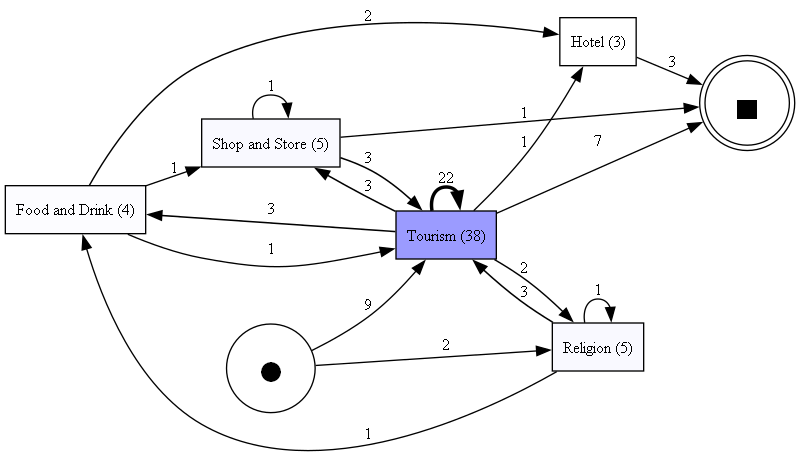

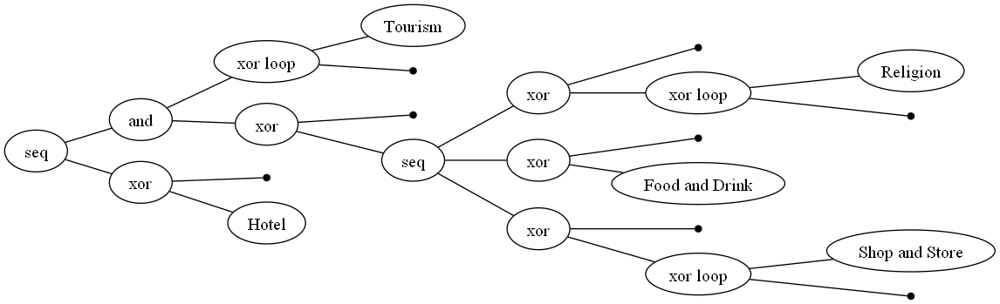

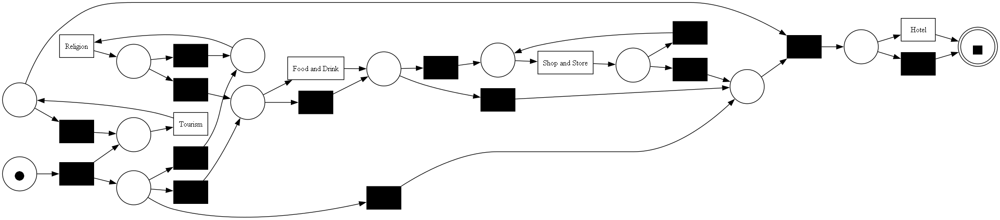

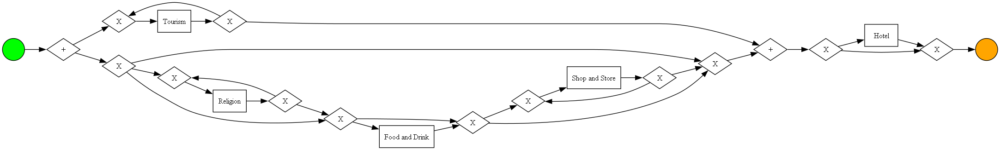

replaying log with TBR, completed traces ::   0%|          | 0/32 [00:00<?, ?it/s]

replaying log with TBR, completed traces ::   0%|          | 0/62 [00:00<?, ?it/s]

{'perc_fit_traces': 33.333333333333336, 'average_trace_fitness': 0.788232264368628, 'log_fitness': 0.8199251967114781, 'percentage_of_fitting_traces': 33.333333333333336}
0.6053268765133172
True
###########################################
Cluster 14:
136


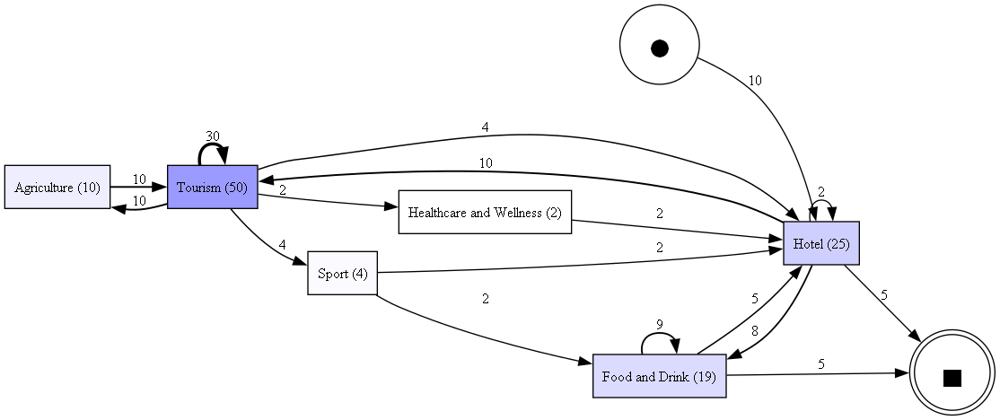

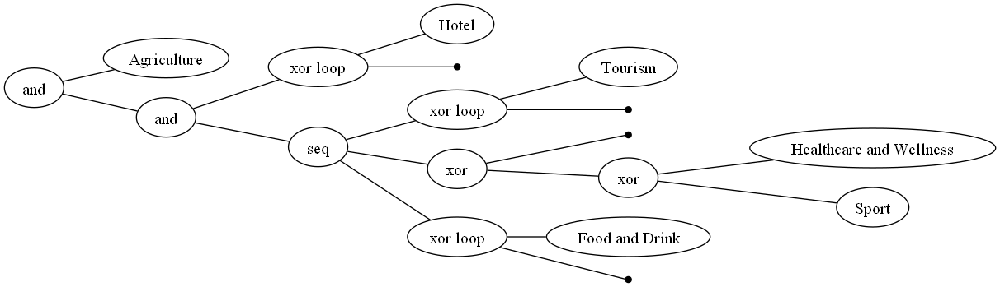

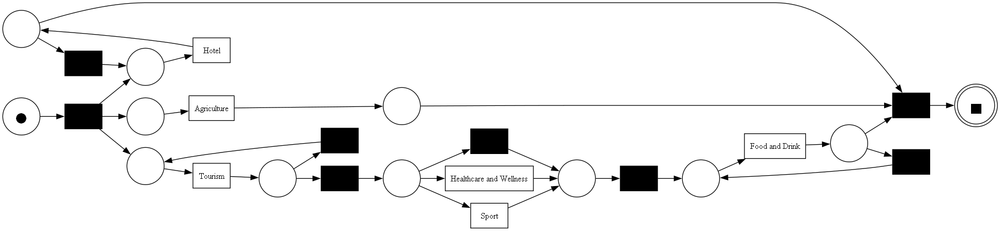

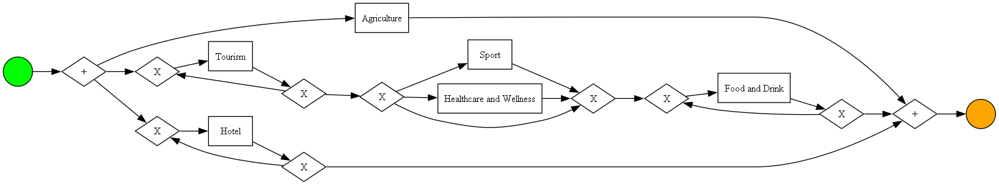

replaying log with TBR, completed traces ::   0%|          | 0/136 [00:00<?, ?it/s]

replaying log with TBR, completed traces ::   0%|          | 0/206 [00:00<?, ?it/s]

{'perc_fit_traces': 50.0, 'average_trace_fitness': 0.9705516612352303, 'log_fitness': 0.9721184116542183, 'percentage_of_fitting_traces': 50.0}
0.3547589616810878
True
###########################################
Cluster 13:
34


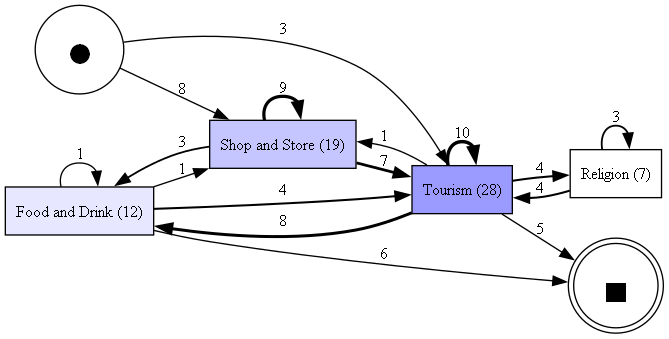

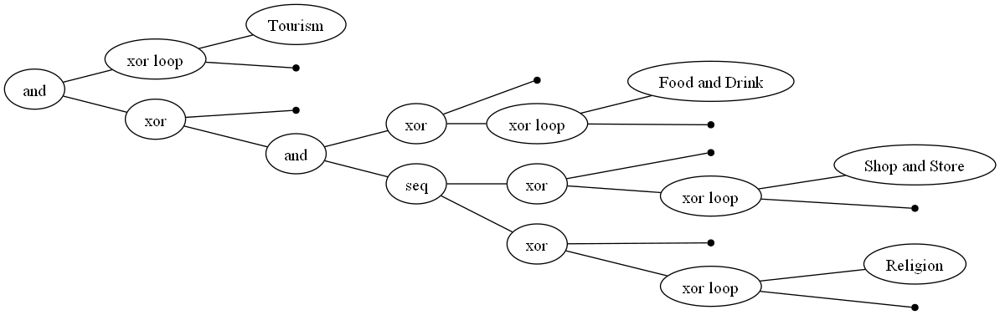

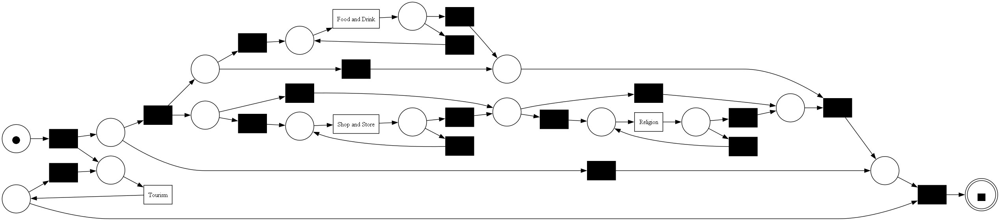

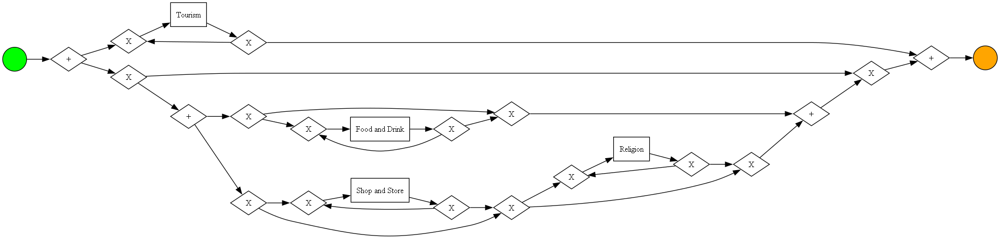

replaying log with TBR, completed traces ::   0%|          | 0/33 [00:00<?, ?it/s]

replaying log with TBR, completed traces ::   0%|          | 0/97 [00:00<?, ?it/s]

{'perc_fit_traces': 94.11764705882354, 'average_trace_fitness': 0.9923676813382696, 'log_fitness': 0.9954499401307912, 'percentage_of_fitting_traces': 94.11764705882354}
0.4672544080604534
True
###########################################
Cluster 5:
53


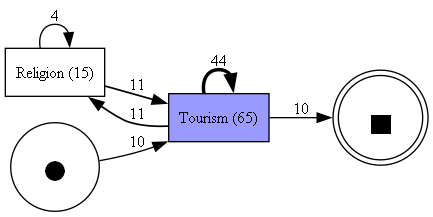

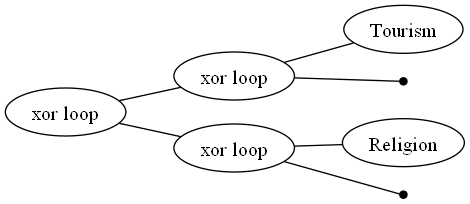

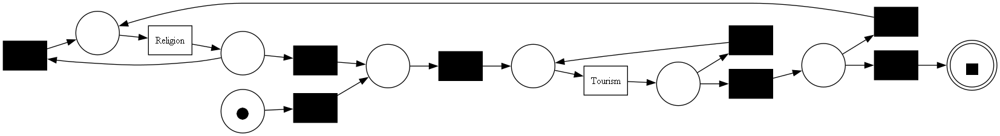

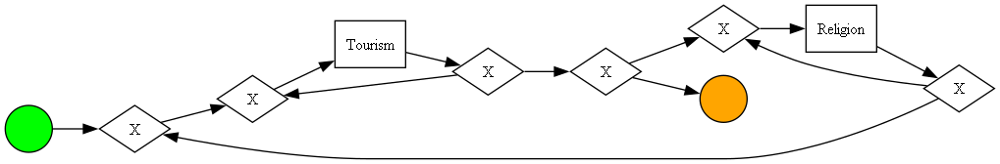

replaying log with TBR, completed traces ::   0%|          | 0/53 [00:00<?, ?it/s]

replaying log with TBR, completed traces ::   0%|          | 0/167 [00:00<?, ?it/s]

{'perc_fit_traces': 94.33962264150944, 'average_trace_fitness': 0.9969040247678017, 'log_fitness': 0.9973045822102425, 'percentage_of_fitting_traces': 94.33962264150944}
0.7822277847309136
True
###########################################
Cluster 8:
100


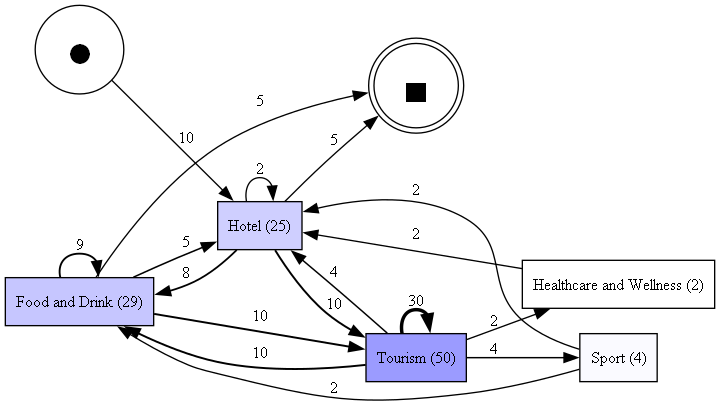

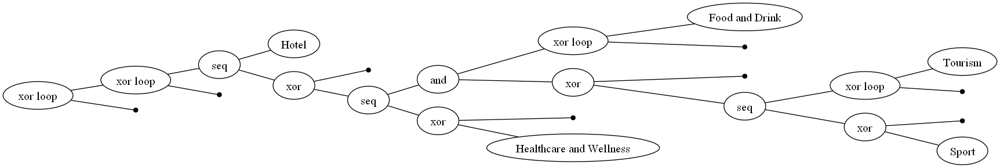

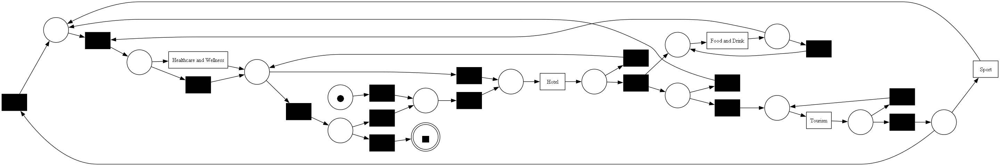

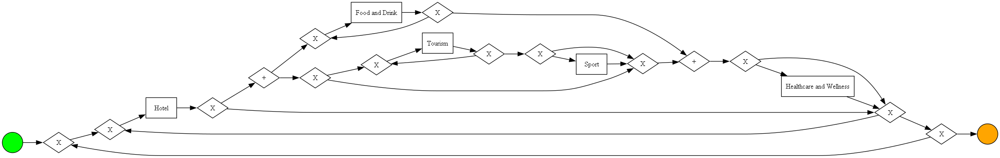

replaying log with TBR, completed traces ::   0%|          | 0/100 [00:00<?, ?it/s]

replaying log with TBR, completed traces ::   0%|          | 0/162 [00:00<?, ?it/s]

{'perc_fit_traces': 40.0, 'average_trace_fitness': 0.9499843221939925, 'log_fitness': 0.9582797504425447, 'percentage_of_fitting_traces': 40.0}
0.4228723404255319
True
###########################################
Cluster 4:
96


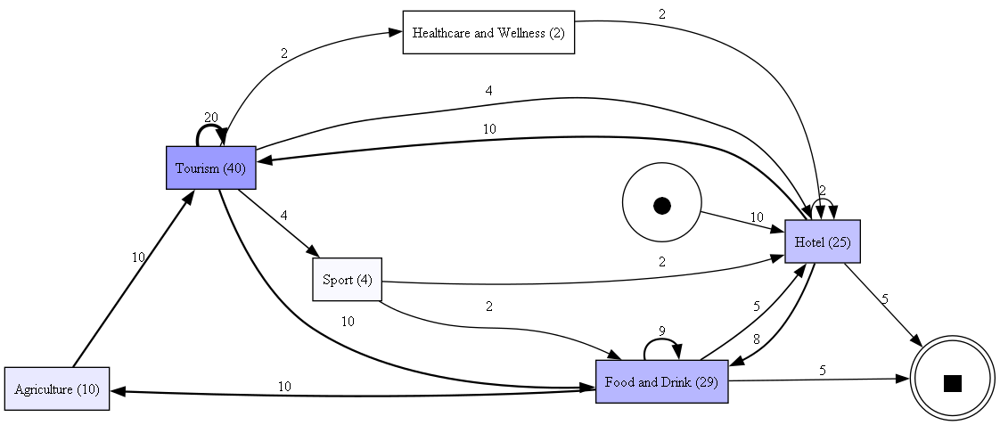

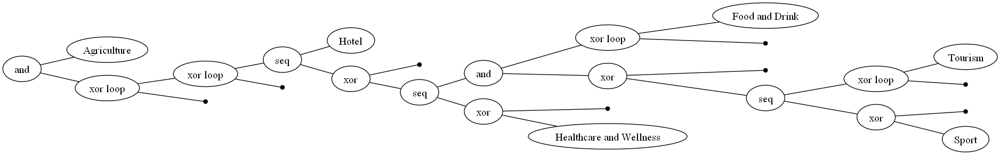

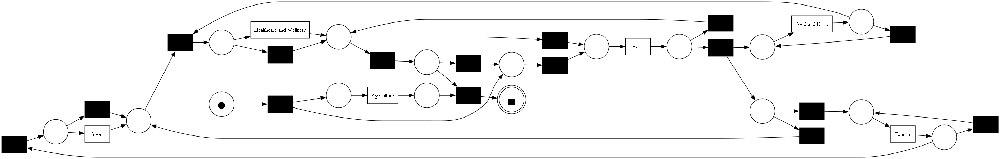

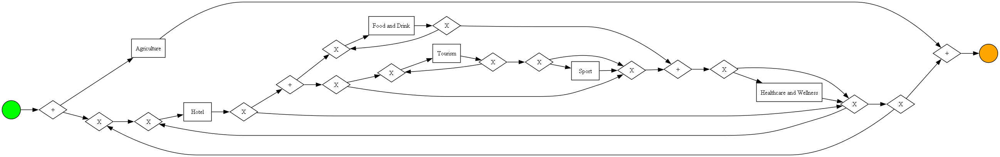

replaying log with TBR, completed traces ::   0%|          | 0/96 [00:00<?, ?it/s]

replaying log with TBR, completed traces ::   0%|          | 0/148 [00:00<?, ?it/s]

{'perc_fit_traces': 20.833333333333332, 'average_trace_fitness': 0.930408863848352, 'log_fitness': 0.9341233837387684, 'percentage_of_fitting_traces': 20.833333333333332}
0.37459283387622155
True
###########################################
Cluster 1:
212


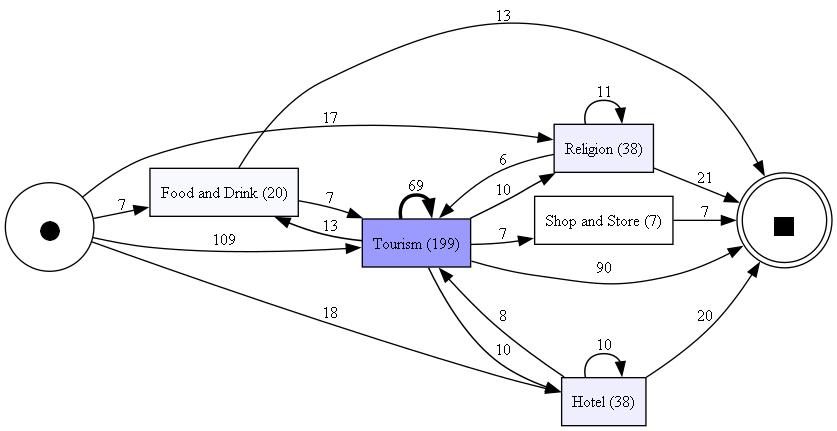

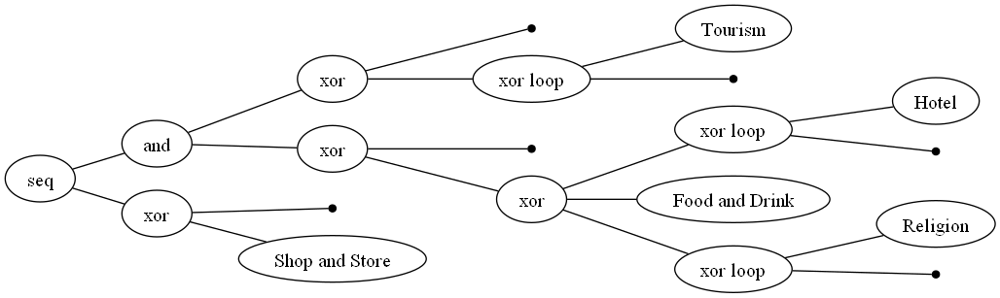

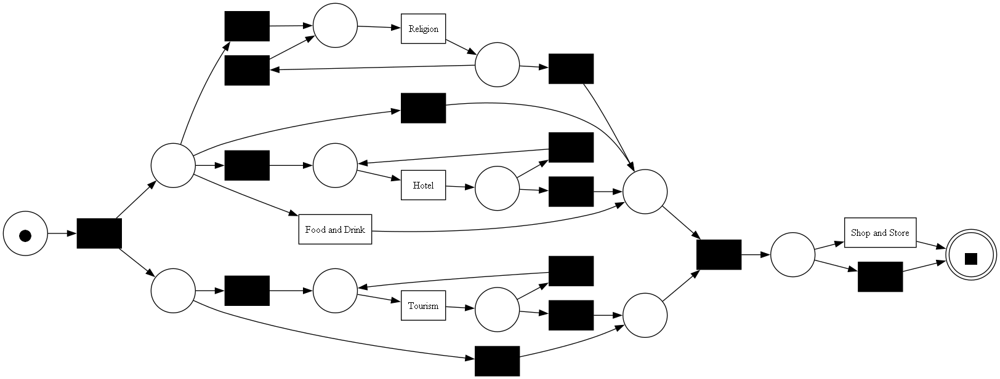

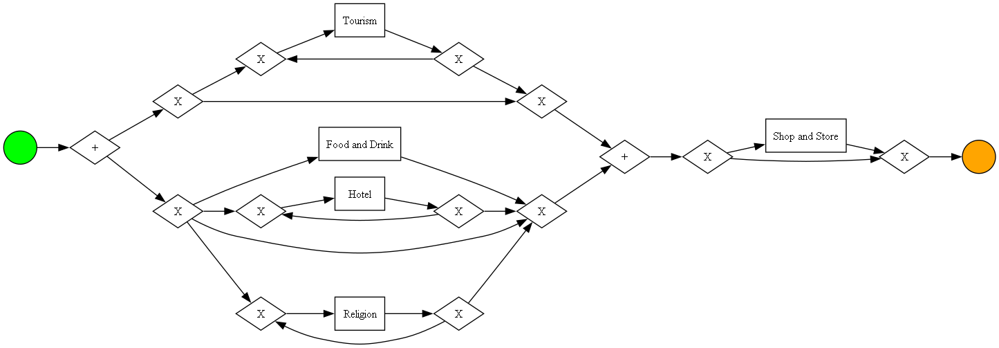

replaying log with TBR, completed traces ::   0%|          | 0/48 [00:00<?, ?it/s]

replaying log with TBR, completed traces ::   0%|          | 0/19 [00:00<?, ?it/s]

{'perc_fit_traces': 91.0377358490566, 'average_trace_fitness': 0.9894558795502192, 'log_fitness': 0.9910292728989613, 'percentage_of_fitting_traces': 91.0377358490566}
0.9353689567430026
True
###########################################
Cluster 0:
47


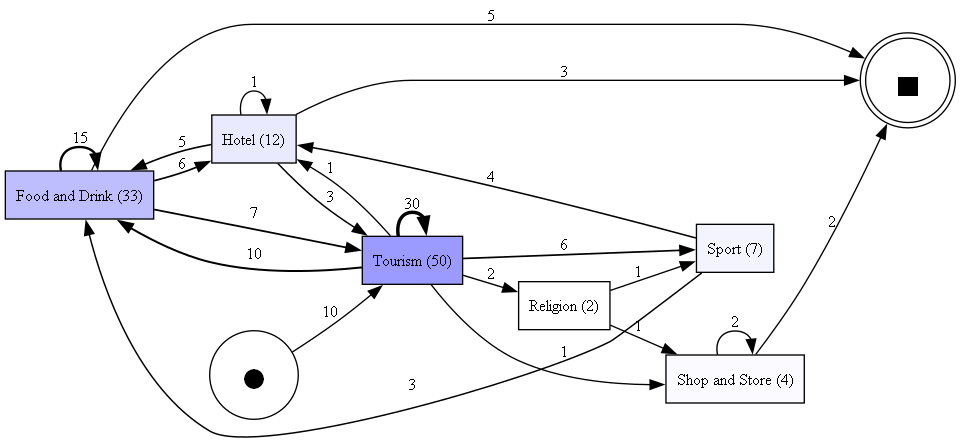

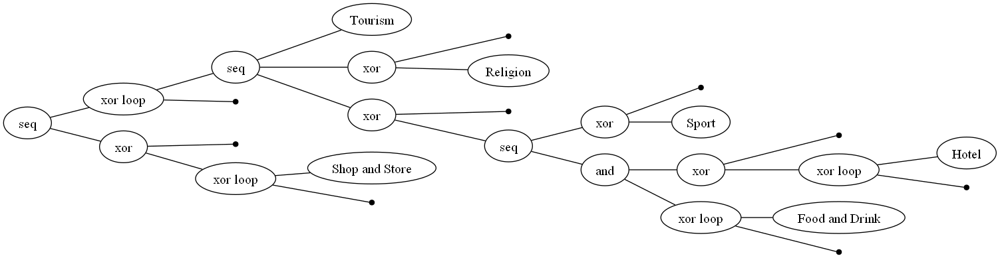

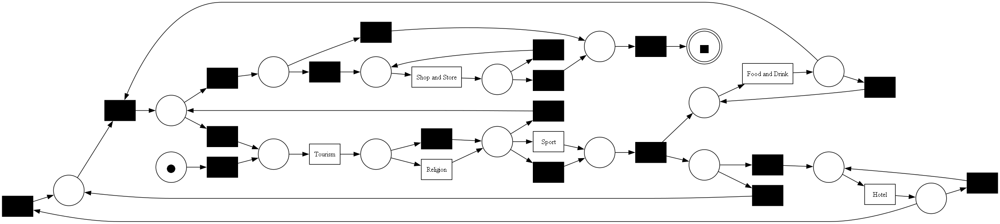

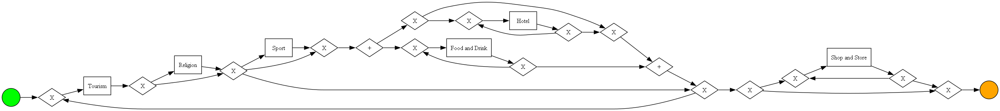

replaying log with TBR, completed traces ::   0%|          | 0/47 [00:00<?, ?it/s]

replaying log with TBR, completed traces ::   0%|          | 0/108 [00:00<?, ?it/s]

{'perc_fit_traces': 76.59574468085107, 'average_trace_fitness': 0.9856528995405227, 'log_fitness': 0.9882352941176471, 'percentage_of_fitting_traces': 76.59574468085107}
0.3550387596899225
True
###########################################
Cluster 2:
166


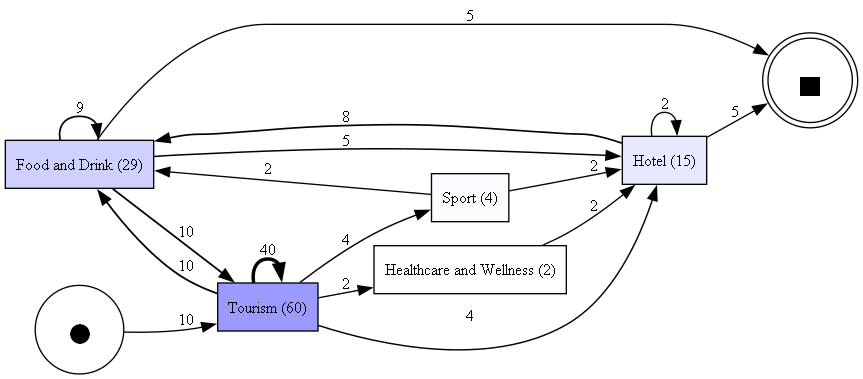

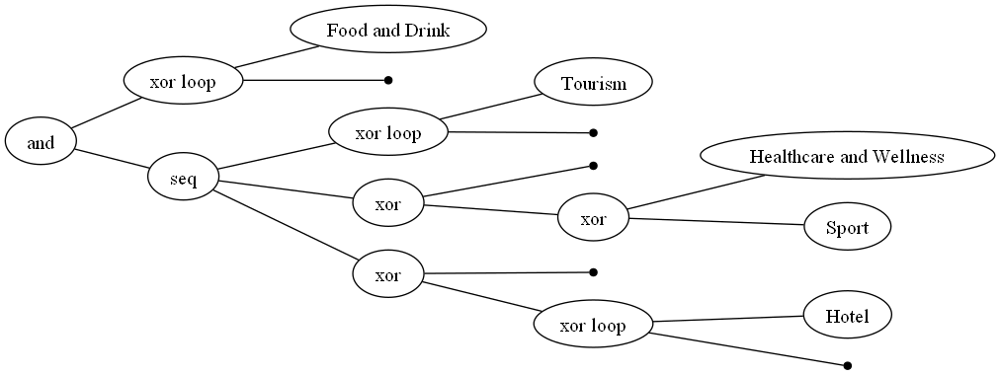

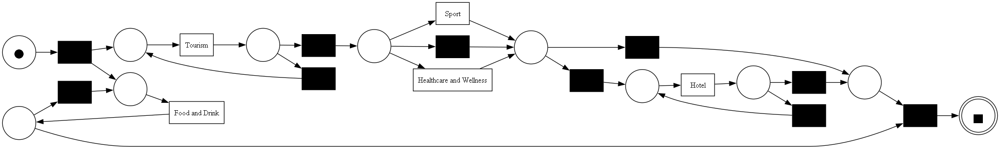

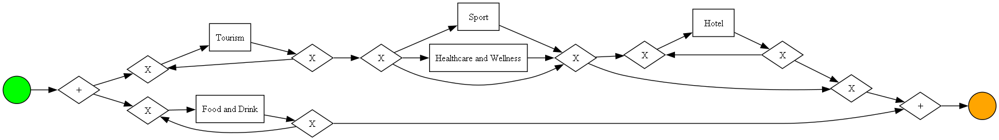

replaying log with TBR, completed traces ::   0%|          | 0/166 [00:00<?, ?it/s]

replaying log with TBR, completed traces ::   0%|          | 0/256 [00:00<?, ?it/s]

{'perc_fit_traces': 72.89156626506023, 'average_trace_fitness': 0.9886240767264863, 'log_fitness': 0.9882168106834249, 'percentage_of_fitting_traces': 72.89156626506023}
0.3832948167712116
True
###########################################
Cluster 9:
152


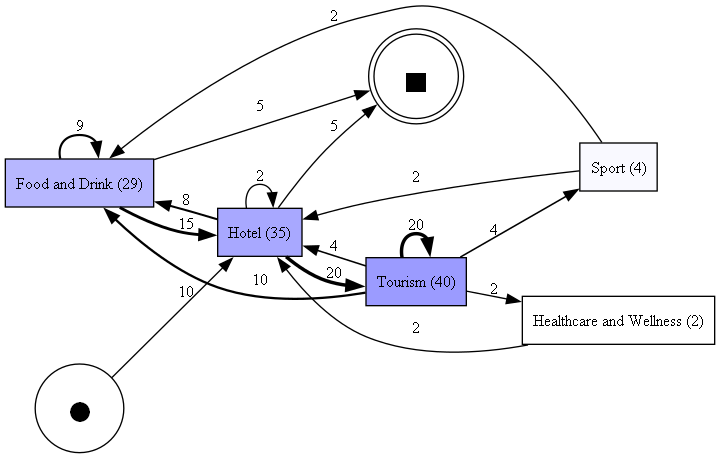

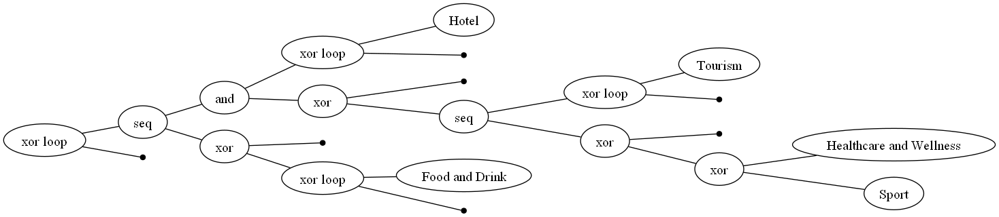

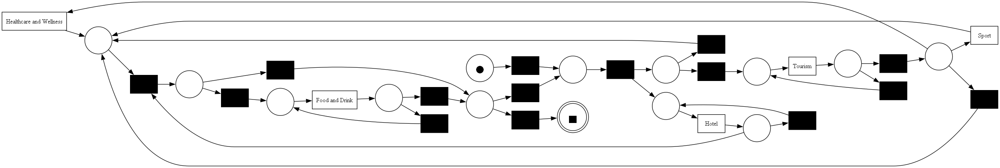

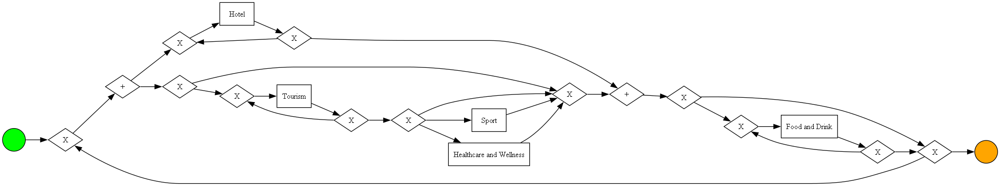

replaying log with TBR, completed traces ::   0%|          | 0/152 [00:00<?, ?it/s]

replaying log with TBR, completed traces ::   0%|          | 0/236 [00:00<?, ?it/s]

{'perc_fit_traces': 39.473684210526315, 'average_trace_fitness': 0.9458597474639522, 'log_fitness': 0.9471787082236027, 'percentage_of_fitting_traces': 39.473684210526315}
0.3791130185979972
True
###########################################
Cluster 7:
53


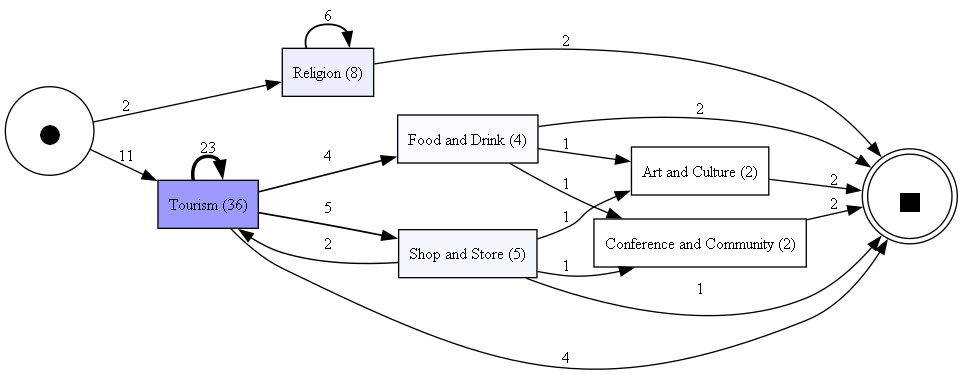

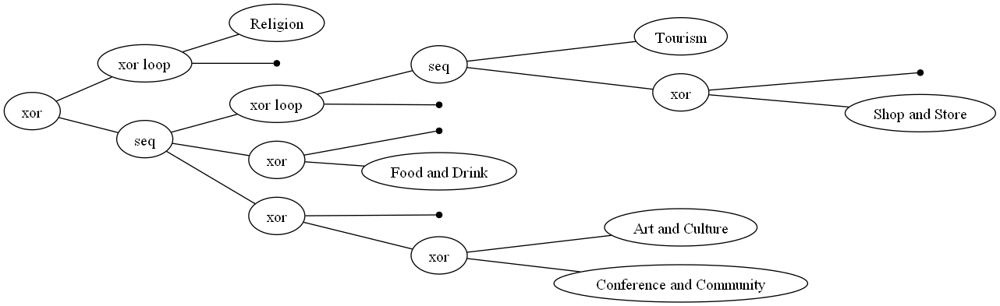

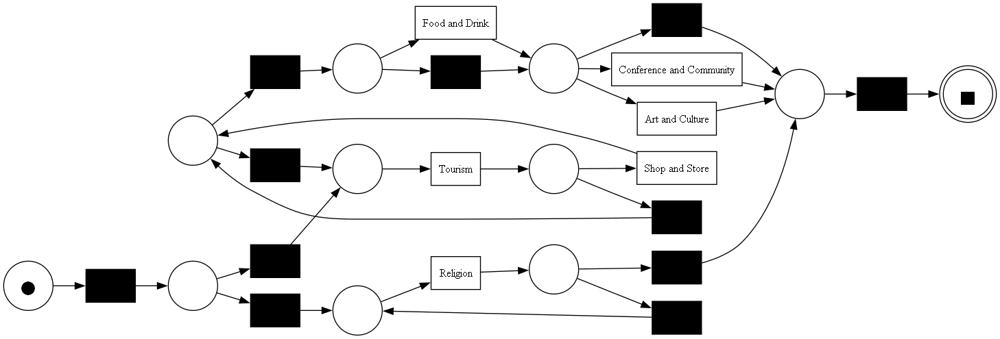

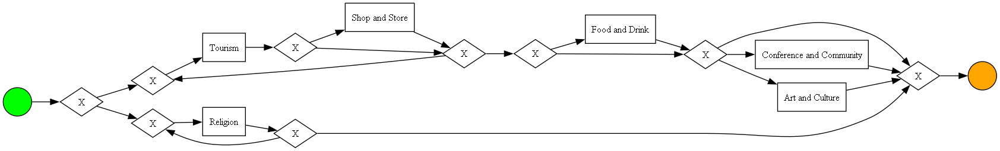

replaying log with TBR, completed traces ::   0%|          | 0/50 [00:00<?, ?it/s]

replaying log with TBR, completed traces ::   0%|          | 0/54 [00:00<?, ?it/s]

{'perc_fit_traces': 37.735849056603776, 'average_trace_fitness': 0.920361661399397, 'log_fitness': 0.9349470499243571, 'percentage_of_fitting_traces': 37.735849056603776}
0.6313725490196078
True
###########################################
Cluster 10:
83


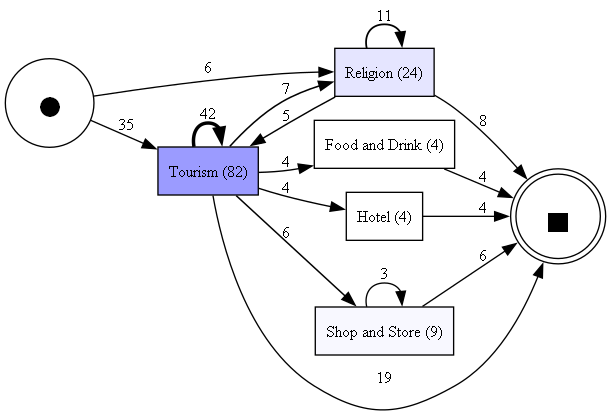

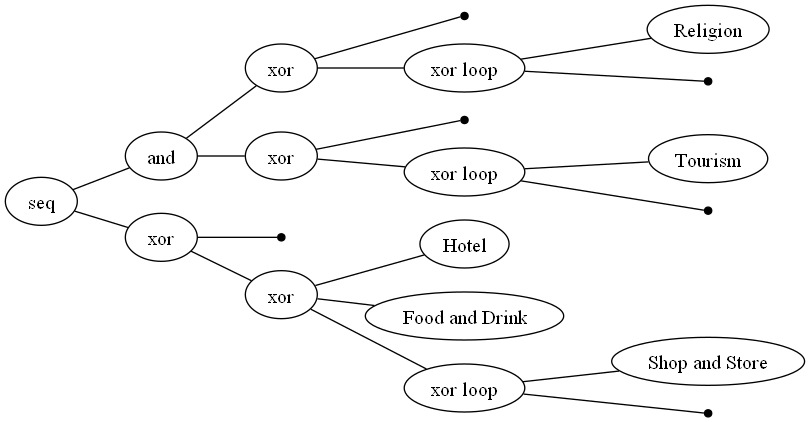

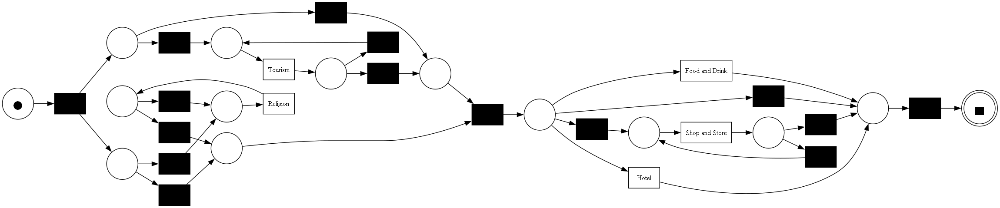

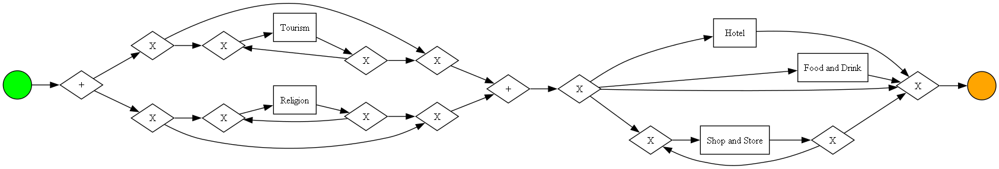

replaying log with TBR, completed traces ::   0%|          | 0/44 [00:00<?, ?it/s]

replaying log with TBR, completed traces ::   0%|          | 0/39 [00:00<?, ?it/s]

{'perc_fit_traces': 69.87951807228916, 'average_trace_fitness': 0.9533639720386703, 'log_fitness': 0.9602713178294574, 'percentage_of_fitting_traces': 69.87951807228916}
0.8672114402451481
True
###########################################
Cluster 6:
48


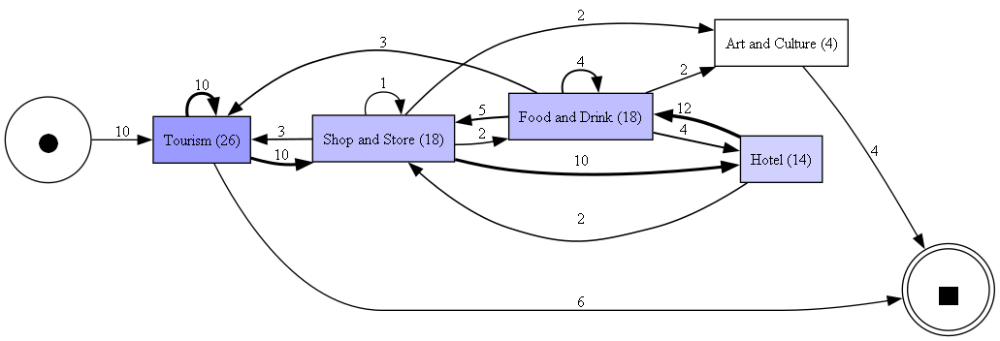

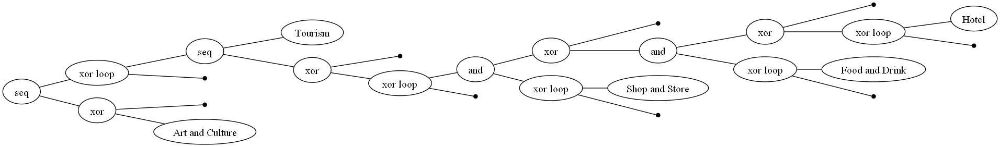

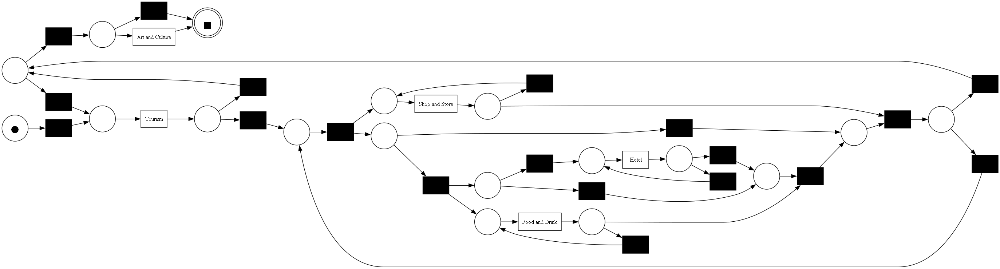

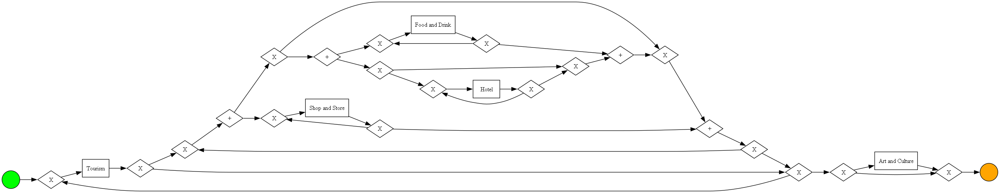

replaying log with TBR, completed traces ::   0%|          | 0/48 [00:00<?, ?it/s]

replaying log with TBR, completed traces ::   0%|          | 0/54 [00:00<?, ?it/s]

{'perc_fit_traces': 81.25, 'average_trace_fitness': 0.985612760830152, 'log_fitness': 0.9886984492962754, 'percentage_of_fitting_traces': 81.25}
0.492776886035313
True
###########################################
Cluster 12:
60


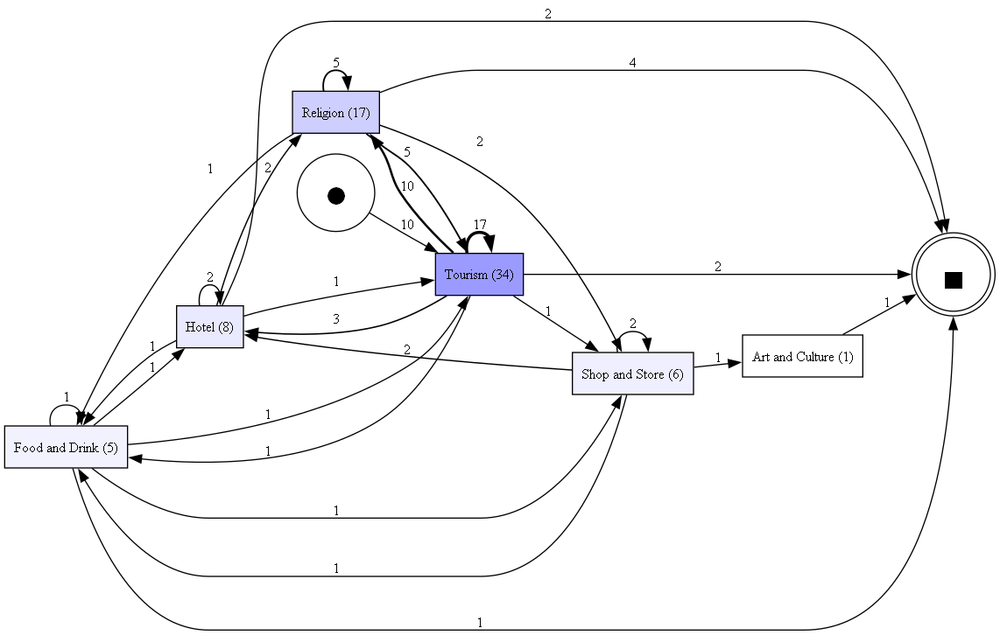

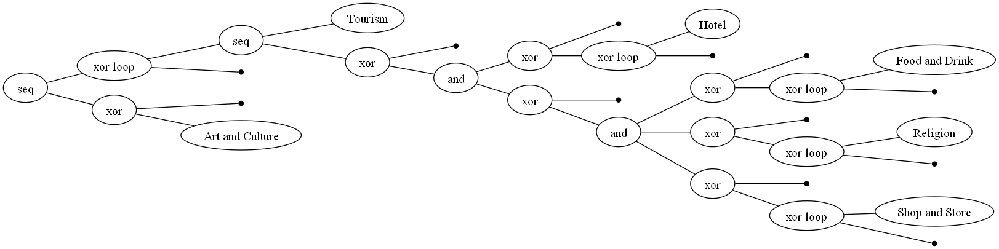

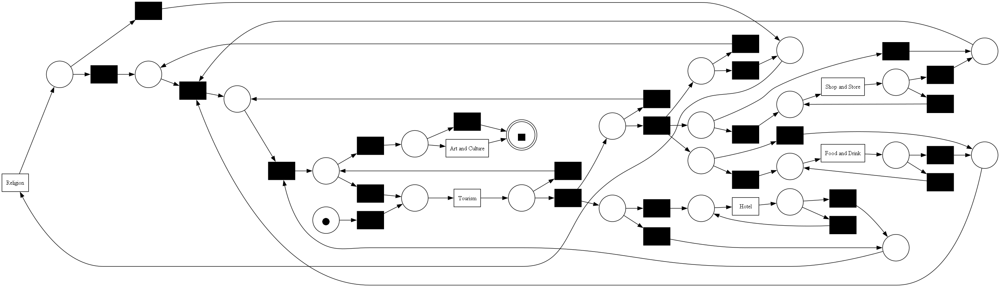

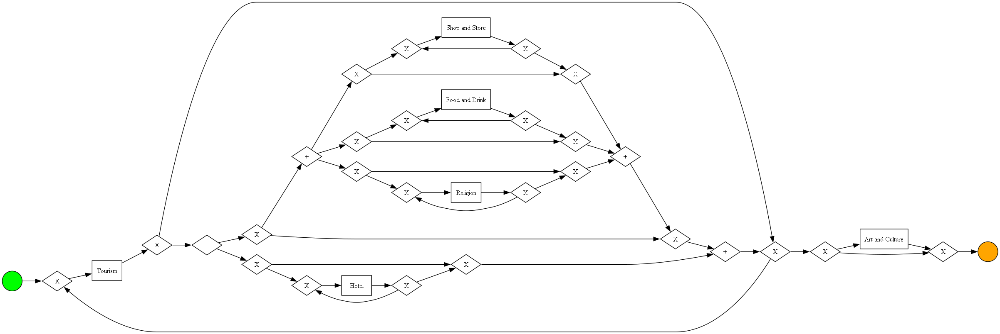

replaying log with TBR, completed traces ::   0%|          | 0/60 [00:00<?, ?it/s]

replaying log with TBR, completed traces ::   0%|          | 0/130 [00:00<?, ?it/s]

{'perc_fit_traces': 23.333333333333332, 'average_trace_fitness': 0.8894272860381934, 'log_fitness': 0.9266523669116516, 'percentage_of_fitting_traces': 23.333333333333332}
0.38687150837988826
True
###########################################
Cluster 11:
43


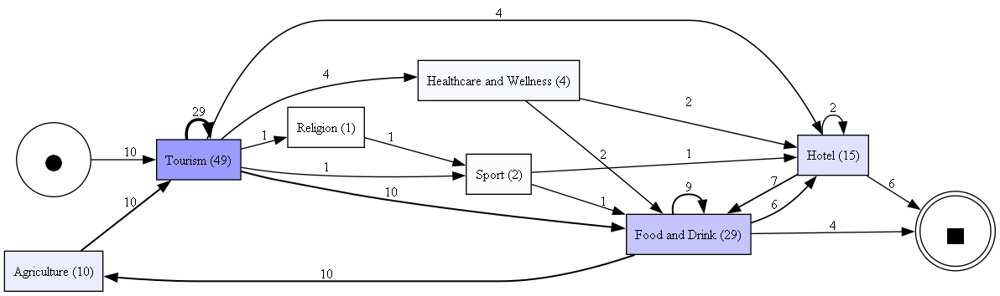

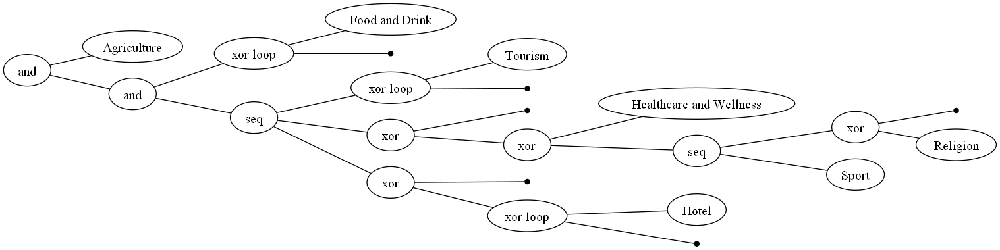

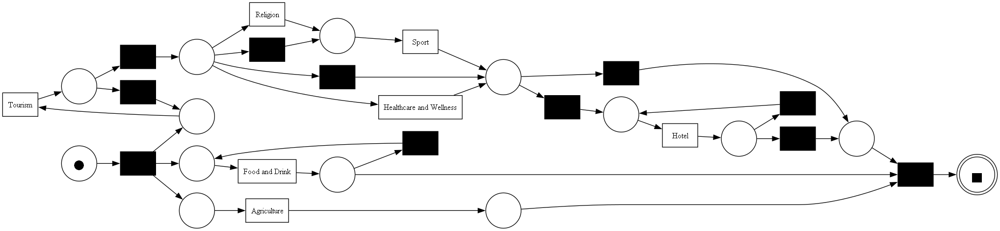

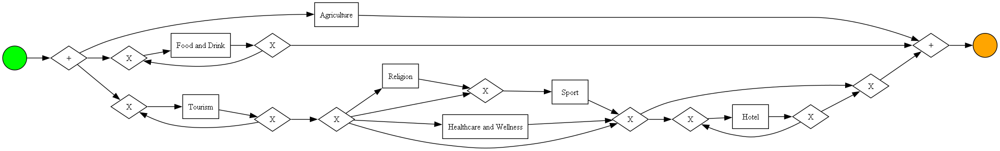

replaying log with TBR, completed traces ::   0%|          | 0/43 [00:00<?, ?it/s]

replaying log with TBR, completed traces ::   0%|          | 0/72 [00:00<?, ?it/s]

{'perc_fit_traces': 25.58139534883721, 'average_trace_fitness': 0.9608508983433148, 'log_fitness': 0.9619047619047619, 'percentage_of_fitting_traces': 25.58139534883721}
0.23825503355704702
True
###########################################


In [853]:
# cluster_index = 0
# for i in tqdm(best_clusters):
for i in tqdm(cluster_dict.keys()):
  print(f"Cluster {i}:")
  cluster_df = create_eventlog_df(cluster_dict[i])
  print(len(cluster_dict[i]))
  cluster_log = create_eventlog_pm4py(cluster_df)
  inductive_miner_visualization(cluster_log, f"Cluster_{i}:")
  # alpha_miner_visualization(cluster_log)
  print("###########################################")

## Runner - Pie Chart with Column

In [854]:
# https://developers.google.com/maps/documentation/places/web-service/place-types?hl=th
gistda_gg_types = {
  "Food and Drink": [
    "food",
    "american_restaurant",
    "bakery",
    "bar",
    "barbecue_restaurant",
    "brazilian_restaurant",
    "breakfast_restaurant",
    "brunch_restaurant",
    "cafe",
    "chinese_restaurant",
    "coffee_shop",
    "fast_food_restaurant",
    "french_restaurant",
    "greek_restaurant",
    "hamburger_restaurant",
    "ice_cream_shop",
    "indian_restaurant",
    "indonesian_restaurant",
    "italian_restaurant",
    "japanese_restaurant",
    "korean_restaurant",
    "lebanese_restaurant",
    "meal_delivery",
    "meal_takeaway",
    "mediterranean_restaurant",
    "mexican_restaurant",
    "middle_eastern_restaurant",
    "pizza_restaurant",
    "ramen_restaurant",
    "restaurant",
    "sandwich_shop",
    "seafood_restaurant",
    "spanish_restaurant",
    "steak_house",
    "sushi_restaurant",
    "thai_restaurant",
    "turkish_restaurant",
    "vegan_restaurant",
    "vegetarian_restaurant",
    "vietnamese_restaurant"
  ],
  "Education": [
    "library",
    "preschool",
    "primary_school",
    "school",
    "secondary_school",
    "university"
  ],
  "Religion": [
    "place_of_worship",
    "church",
    "hindu_temple",
    "mosque",
    "synagogue"
  ],
  "Healthcare and Wellness": [
    "dental_clinic",
    "dentist",
    "doctor",
    "drugstore",
    "hospital",
    "medical_lab",
    "pharmacy",
    "physiotherapist",
    "spa",
      "health"
  ],
  "Conference and Community": [
    "community_center",
    "convention_center",
    "cultural_center"
  ],
  "Service": [
      "general_contractor",
    "barber_shop",
    "beauty_salon",
    "cemetery",
    "child_care_agency",
    "consultant",
    "courier_service",
    "electrician",
    "florist",
    "funeral_home",
    "hair_care",
    "hair_salon",
    "insurance_agency",
    "laundry",
    "lawyer",
    "locksmith",
    "moving_company",
    "painter",
    "plumber",
    "real_estate_agency",
    "roofing_contractor",
    "storage",
    "tailor",
    "telecommunications_service_provider",
    "travel_agency",
    "veterinary_care"
  ],
  "Hotel": [
    "bed_and_breakfast",
    "campground",
    "camping_cabin",
    "cottage",
    "extended_stay_hotel",
    "farmstay",
    "guest_house",
    "hostel",
    "hotel",
    "lodging",
    "motel",
    "private_guest_room",
    "resort_hotel",
    "rv_park"
  ],
  "Shop and Store": [
    "auto_parts_store",
    "bicycle_store",
    "book_store",
    "cell_phone_store",
    "clothing_store",
    "convenience_store",
    "department_store",
    "discount_store",
    "electronics_store",
    "furniture_store",
    "gift_shop",
    "grocery_store",
    "hardware_store",
    "home_goods_store",
    "home_improvement_store",
    "jewelry_store",
    "liquor_store",
    "market",
    "pet_store",
    "shoe_store",
    "shopping_mall",
    "sporting_goods_store",
    "store",
    "supermarket",
    "wholesaler"
  ],
  "Tourism": [
    "archipelago",
    "continent",
    "landmark",
    "natural_feature",
    "neighborhood",
    "town_square",
    "amusement_park",
    "aquarium",
    "banquet_hall",
    "dog_park",
    "event_venue",
    "hiking_area",
    "historical_landmark",
    "marina",
    "national_park",
    "park",
    "tourist_attraction",
    "visitor_center",
    "wedding_venue",
    "zoo"
  ],
  "Entertainment": [
    "amusement_center",
    "bowling_alley",
    "casino",
    "movie_rental",
    "movie_theater",
    "night_club"
  ],
  "Art and Culture": [
    "art_gallery",
    "museum",
    "performing_arts_theater"
  ],
  "Sport": [
    "athletic_field",
    "fitness_center",
    "golf_course",
    "gym",
    "playground",
    "ski_resort",
    "sports_club",
    "sports_complex",
    "stadium",
    "swimming_pool"
  ],
  "Agriculture": [
    "farm"
  ]
}

In [855]:
#Define a function to be applied to each partition
def subtype_converter_process_partition(partition):
    partition = partition.reset_index(drop = True)
    # Extract mentioned activities along the places from text post by LLM
    for index, subType_itinerary_text in tqdm(enumerate(partition['subType'])):
        try:
            subType_itinerary_lists = ast.literal_eval(subType_itinerary_text)
            partition.loc[index, 'subType'] = subType_itinerary_lists
        except Exception as e:
            print(e)
    return partition

df = df.astype('object')
# Read the large DataFrame using Dask
_df = dd.from_pandas(df, npartitions=10)

# Apply the function to each partition in parallel
result_df = _df.map_partitions(subtype_converter_process_partition).compute()
df = result_df.copy()
df = df.reset_index(drop=True)
df

0it [00:00, ?it/s]

malformed node or string on line 1: <ast.Name object at 0x000001C1C3D01180>
malformed node or string on line 1: <ast.Name object at 0x000001C1C3D01B70>


,urls,keyword,text,places,place_infos,filtered_places,filtered_rename_places,primaryType,subType,activities,primaryType_comb,activity_comb,rename_activity_comb,primaryType_len,labels
0,https://www.facebook.com/groups/paikondieow/pe...,trip,"ONE DAY TRIP บางแสน , ชลบุรี_____หนึ่งวันกับกา...","[""บางแสน"", ""ชลบุรี"", ""กรุงเทพ"", ""หาดบางแสน"", ""...","[{'types': ['neighborhood', 'political'], 'add...","['หาดบางแสน', 'สะพานมารควิถี']","['Bang Saen Ville', 'Cholmarkwithi Bridge']","[[Tourism], [Tourism]]","[[neighborhood], [tourist_attraction]]","[{""place"": ""หาดบางแสน"", ""activity"": [""ถ่ายรูป""...","[Tourism, Tourism]","[('ถ่ายรูป',)]",[['Photography']],2,3
1,https://www.facebook.com/groups/paikondieow/pe...,มกรา,เที่ยวโฮมสเตย์ชาวเขา ที่พักบนดอย ต.ช้างกื้ด อ...,"[""ดอย"", ""ต.ช้างกื้ด"", ""อ.แม่แตง"", ""จ.เชียงใหม่...","[{'types': ['private_guest_room', 'lodging', '...","['บ้านห้วยกุ๊บกั๊บ', 'บ้านซุกกิ๊กโฮมสเตย์', 'ป...","['บ้านฝ้ายโฮมสเตย์ บ้านห้วยกุ๊บกั๊บ', 'Baansuk...","[[Hotel], [Hotel], [Tourism]]","[[private_guest_room, lodging], [private_guest...",<NA>,"[Hotel, Hotel, Tourism]",[],[],3,14
2,https://www.facebook.com/groups/paikondieow/pe...,มิถุนายน,ทุ่งบัวสวรรค์ (ทุ่งดอกกระเจียว) อช ไทรทอง อ หน...,"[""ทุ่งบัวสวรรค์"", ""ทุ่งดอกกระเจียว"", ""อช ไทรทอ...","[{'types': ['tourist_attraction', 'point_of_in...","['ทุ่งบัวสวรรค์', 'ทุ่งดอกกระเจียว', 'อช ไทรทอง']","['Bua Sawan field or Krachiao flower field', '...","[[Tourism], [Tourism], [Tourism]]","[[tourist_attraction], [tourist_attraction], [...","[{""place"": ""ทุ่งบัวสวรรค์"", ""activity"": []}, {...","[Tourism, Tourism, Tourism]",[()],[[]],3,13
3,https://www.facebook.com/groups/paikondieow/pe...,กันยายน,ยิ่งยงสวนดอกไม้ เชียงใหม่สวนดอกไม้ บนยอดดอยม...,"[""ดอยม่อนแจ่ม"", ""เชียงใหม่"", ""บ้านภูหมอก""]","[{'types': ['food', 'point_of_interest', 'stor...","['ดอยม่อนแจ่ม', 'บ้านภูหมอก']","['ม่อนแจ่ม(แซลมอนxซูชิ)สาขาบางใหญ่', 'Baan Phu...","[[Shop and Store, Food and Drink], [Hotel]]","[[store, food], [private_guest_room, lodging]]",<NA>,"[Shop and Store, Hotel]",[],[],2,5
4,https://www.facebook.com/groups/paikondieow/pe...,กันยายน,ยิ่งยงสวนดอกไม้ เชียงใหม่สวนดอกไม้ บนยอดดอยม...,"[""ดอยม่อนแจ่ม"", ""เชียงใหม่"", ""บ้านภูหมอก""]","[{'types': ['food', 'point_of_interest', 'stor...","['ดอยม่อนแจ่ม', 'บ้านภูหมอก']","['ม่อนแจ่ม(แซลมอนxซูชิ)สาขาบางใหญ่', 'Baan Phu...","[[Shop and Store, Food and Drink], [Hotel]]","[[store, food], [private_guest_room, lodging]]",<NA>,"[Food and Drink, Hotel]",[],[],2,8
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1311,https://www.facebook.com/groups/paikondieow/pe...,พระนครศรีอยุธยา,คาเฟ่บรรยากาศบ้านสวน พร้อมมุมถ่ายภาพสวยๆ @ บ้า...,"[""บ้านสวนรอยจรัล"", ""ต.วัดตูม"", ""พระนครศรีอยุธยา""]","[{'types': ['restaurant', 'point_of_interest',...","['บ้านสวนรอยจรัล', 'ต.วัดตูม']","['บ้านสวนรอยจรัล', 'Wat Tum']","[[Food and Drink], [Religion, Tourism]]","[[restaurant, food], [tourist_attraction, plac...",<NA>,"[Food and Drink, Tourism]",[],[],2,4
1312,https://www.facebook.com/groups/paikondieow/pe...,มิถุนายน,#โพสต์เดียวครบ — [ รวม 20 พิกัด ] [ #เกาะล้า...,"[""เกาะล้าน"", ""หาดสังวาลย์"", ""Sangwan beach vil...","[{'types': ['restaurant', 'food', 'point_of_in...","['Sangwan beach villa', 'หาดตาแหวน', 'หาดทองหล...","['Sangwan Beach', 'Tawaen', 'Tong Lang Beach',...","[[Food and Drink], [Tourism], [Tourism], [Tour...","[[food, restaurant], [natural_feature], [natur...","[{""place"": ""Sangwan beach villa"", ""activity"": ...","[Food and Drink, Tourism, Tourism, Tourism]",[()],[[]],4,14
1313,https://www.facebook.com/groups/paikondieow/pe...,เพื่อนร่วม,คาเฟ่วิวหลักล้าน | ม่อนสกาดคาเฟ่ ................,"[""ม่อนสกาดคาเฟ่"", ""น่าน"", ""ดอยสกาด"", ""สกาด"", ""...","[{'types': ['private_guest_room', 'lodging', '...","['ม่อนสกาดคาเฟ่', 'ดอยสกาด']","['ม่อนสกาดคาเฟ่&ฟาร์มสเตย์ ดอยสกาด', 'Baan Mom...","[[Hotel], [Hotel]]","[[private_guest_room, lodging], [private_guest...",<NA>,"[Hotel, Hotel]",[],[],2,10
1314,https://www.facebook.com/groups/paikon

In [856]:
chart_df = df.explode('subType').explode('subType').reset_index(drop=True)

In [857]:
chart_df

,urls,keyword,text,places,place_infos,filtered_places,filtered_rename_places,primaryType,subType,activities,primaryType_comb,activity_comb,rename_activity_comb,primaryType_len,labels
0,https://www.facebook.com/groups/paikondieow/pe...,trip,"ONE DAY TRIP บางแสน , ชลบุรี_____หนึ่งวันกับกา...","[""บางแสน"", ""ชลบุรี"", ""กรุงเทพ"", ""หาดบางแสน"", ""...","[{'types': ['neighborhood', 'political'], 'add...","['หาดบางแสน', 'สะพานมารควิถี']","['Bang Saen Ville', 'Cholmarkwithi Bridge']","[[Tourism], [Tourism]]",neighborhood,"[{""place"": ""หาดบางแสน"", ""activity"": [""ถ่ายรูป""...","[Tourism, Tourism]","[('ถ่ายรูป',)]",[['Photography']],2,3
1,https://www.facebook.com/groups/paikondieow/pe...,trip,"ONE DAY TRIP บางแสน , ชลบุรี_____หนึ่งวันกับกา...","[""บางแสน"", ""ชลบุรี"", ""กรุงเทพ"", ""หาดบางแสน"", ""...","[{'types': ['neighborhood', 'political'], 'add...","['หาดบางแสน', 'สะพานมารควิถี']","['Bang Saen Ville', 'Cholmarkwithi Bridge']","[[Tourism], [Tourism]]",tourist_attraction,"[{""place"": ""หาดบางแสน"", ""activity"": [""ถ่ายรูป""...","[Tourism, Tourism]","[('ถ่ายรูป',)]",[['Photography']],2,3
2,https://www.facebook.com/groups/paikondieow/pe...,มกรา,เที่ยวโฮมสเตย์ชาวเขา ที่พักบนดอย ต.ช้างกื้ด อ...,"[""ดอย"", ""ต.ช้างกื้ด"", ""อ.แม่แตง"", ""จ.เชียงใหม่...","[{'types': ['private_guest_room', 'lodging', '...","['บ้านห้วยกุ๊บกั๊บ', 'บ้านซุกกิ๊กโฮมสเตย์', 'ป...","['บ้านฝ้ายโฮมสเตย์ บ้านห้วยกุ๊บกั๊บ', 'Baansuk...","[[Hotel], [Hotel], [Tourism]]",private_guest_room,<NA>,"[Hotel, Hotel, Tourism]",[],[],3,14
3,https://www.facebook.com/groups/paikondieow/pe...,มกรา,เที่ยวโฮมสเตย์ชาวเขา ที่พักบนดอย ต.ช้างกื้ด อ...,"[""ดอย"", ""ต.ช้างกื้ด"", ""อ.แม่แตง"", ""จ.เชียงใหม่...","[{'types': ['private_guest_room', 'lodging', '...","['บ้านห้วยกุ๊บกั๊บ', 'บ้านซุกกิ๊กโฮมสเตย์', 'ป...","['บ้านฝ้ายโฮมสเตย์ บ้านห้วยกุ๊บกั๊บ', 'Baansuk...","[[Hotel], [Hotel], [Tourism]]",lodging,<NA>,"[Hotel, Hotel, Tourism]",[],[],3,14
4,https://www.facebook.com/groups/paikondieow/pe...,มกรา,เที่ยวโฮมสเตย์ชาวเขา ที่พักบนดอย ต.ช้างกื้ด อ...,"[""ดอย"", ""ต.ช้างกื้ด"", ""อ.แม่แตง"", ""จ.เชียงใหม่...","[{'types': ['private_guest_room', 'lodging', '...","['บ้านห้วยกุ๊บกั๊บ', 'บ้านซุกกิ๊กโฮมสเตย์', 'ป...","['บ้านฝ้ายโฮมสเตย์ บ้านห้วยกุ๊บกั๊บ', 'Baansuk...","[[Hotel], [Hotel], [Tourism]]",private_guest_room,<NA>,"[Hotel, Hotel, Tourism]",[],[],3,14
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
37529,https://www.facebook.com/groups/paikondieow/pe...,ทริป,ทริปลากกระเป๋าไปเชียงใหม่คนเดียวแบบจริงจัง สถ...,"[""เชียงใหม่"", ""ทุ่งดอกไม้"", ""I Love Flower Far...","[{'types': ['florist', 'store', 'point_of_inte...","['ทุ่งดอกไม้', 'I Love Flower Farm', 'ทุ่งดอกเ...","['ร้านดอกไม้วิรัลพัชร', 'I love flower farm', ...","[[Shop and Store, Service], [Agriculture], [To...",tourist_attraction,<NA>,"[Shop and Store, Agriculture, Tourism]",[],[],3,11
37530,https://www.facebook.com/groups/paikondieow/pe...,ทริป,ทริปลากกระเป๋าไปเชียงใหม่คนเดียวแบบจริงจัง สถ...,"[""เชียงใหม่"", ""ทุ่งดอกไม้"", ""I Love Flower Far...","[{'types': ['florist', 'store', 'point_of_inte...","['ทุ่งดอกไม้', 'I Love Flower Farm', 'ทุ่งดอกเ...","['ร้านดอกไม้วิรัลพัชร', 'I love flower farm', ...","[[Shop and Store, Service], [Agriculture], [To...",store,<NA>,"[Service, Agriculture, Tourism]",[],[],3,14
37531,https://www.facebook.com/groups/paikondieow/pe...,ทริป,ทริปลากกระเป๋าไปเชียงใหม่คนเดียวแบบจริงจัง สถ...,"[""เชียงใหม่"", ""ทุ่งดอกไม้"", ""I Love Flower Far...","[{'types': ['florist', 'store', 'point_of_inte...","['ทุ่งดอกไม้', 'I Love Flower Farm', 'ทุ่งดอกเ...","['ร้านดอกไม้วิรัลพัชร', 'I love flower farm', ...","[[Shop and Store, Service], [Agriculture], [To...",florist,<NA>,"[Service, Agriculture, Tourism]",[],[],3,14
37532,https://www.facebook.com/groups/paikondieow/pe...,ทริป,ทริปลากกระเป๋าไปเชียงใหม่คนเดียวแบบจริงจัง สถ...,"[""เชียงใหม่"", ""ทุ่งดอกไม้"", ""I Love Flower Far...","[{'types': ['florist', 'store', 'point_of_inte...","['ทุ่งดอกไม้', 'I Love Flower Farm', 'ทุ่งดอกเ...","['ร้านดอกไม

In [858]:
# chart_df.loc[4127, 'subType'] = list(ast.literal_eval(chart_df.loc[4127]['subType']))
chart_df = chart_df.explode('subType').explode('subType').reset_index(drop=True)

In [859]:
len(chart_df['subType'].tolist())

37534

In [860]:
temp_primaryTypes_list = []
for index, ggtype in enumerate(chart_df['subType'].tolist()):
    check = 0
    for key, gistda_group in gistda_gg_types.items():
        if ggtype in gistda_group:
            temp_primaryTypes_list.append(key)
            check = 1
            
chart_df['primaryType'] = temp_primaryTypes_list
chart_df = chart_df[['primaryType', 'subType']]
chart_df

,primaryType,subType
0,Tourism,neighborhood
1,Tourism,tourist_attraction
2,Hotel,private_guest_room
3,Hotel,lodging
4,Hotel,private_guest_room
...,...,...
37529,Tourism,tourist_attraction
37530,Shop and Store,store
37531,Service,florist
37532,Agriculture,farm


In [861]:
chart_df['value'] = 1
chart_df

,primaryType,subType,value
0,Tourism,neighborhood,1
1,Tourism,tourist_attraction,1
2,Hotel,private_guest_room,1
3,Hotel,lodging,1
4,Hotel,private_guest_room,1
...,...,...,...
37529,Tourism,tourist_attraction,1
37530,Shop and Store,store,1
37531,Service,florist,1
37532,Agriculture,farm,1


In [862]:
for i in np.setdiff1d(list(gistda_gg_types.keys()), unique(chart_df['primaryType'])):
    chart_df.loc[len(chart_df)] = [i, gistda_gg_types[i][0], 0]
chart_df

,primaryType,subType,value
0,Tourism,neighborhood,1
1,Tourism,tourist_attraction,1
2,Hotel,private_guest_room,1
3,Hotel,lodging,1
4,Hotel,private_guest_room,1
...,...,...,...
37529,Tourism,tourist_attraction,1
37530,Shop and Store,store,1
37531,Service,florist,1
37532,Agriculture,farm,1


In [863]:
chart_df = chart_df.sort_values(by=['primaryType']).reset_index(drop=True)

In [864]:
chart_df['primaryType'].unique()

array(['Agriculture', 'Art and Culture', 'Conference and Community',
       'Education', 'Entertainment', 'Food and Drink',
       'Healthcare and Wellness', 'Hotel', 'Religion', 'Service',
       'Shop and Store', 'Sport', 'Tourism'], dtype=object)

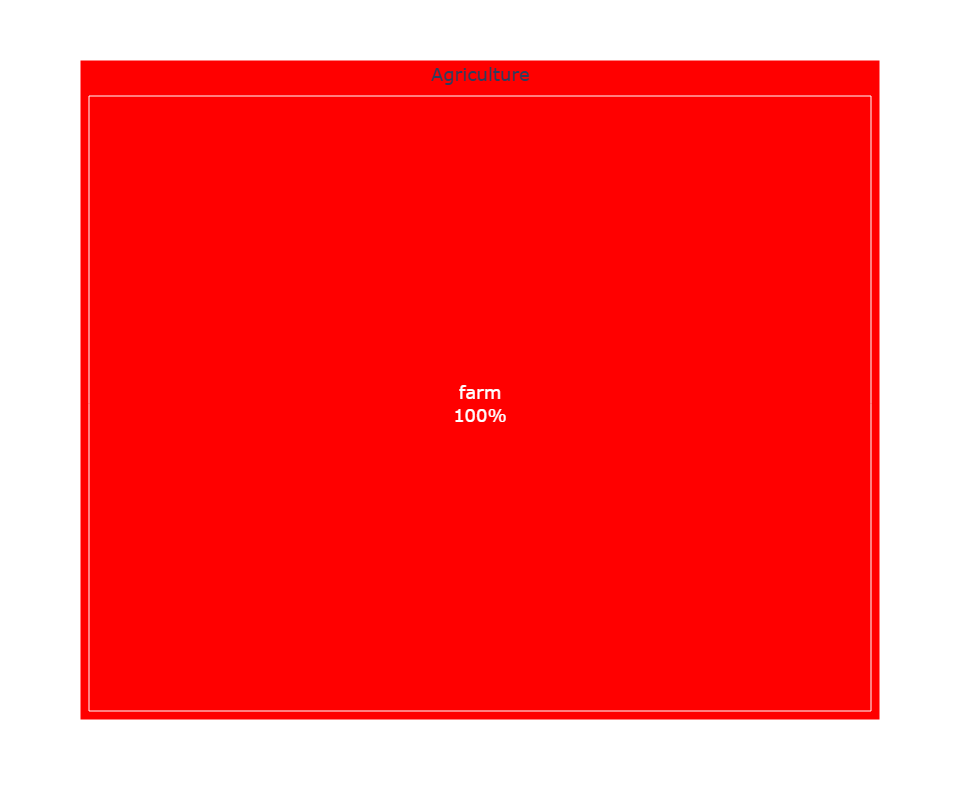

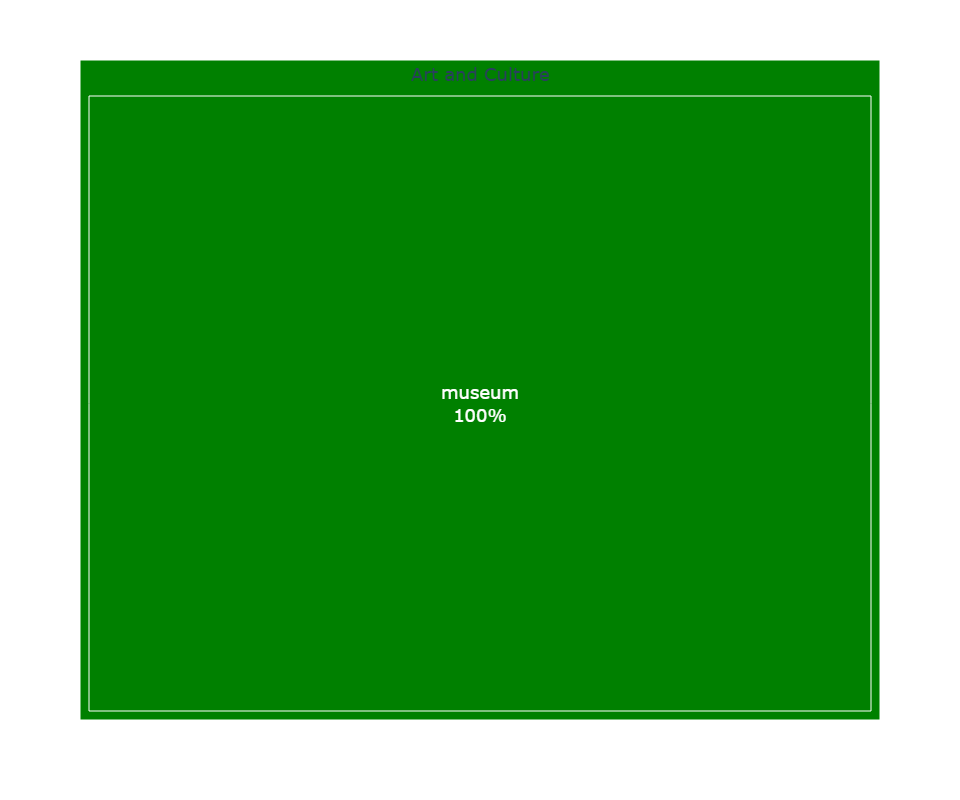

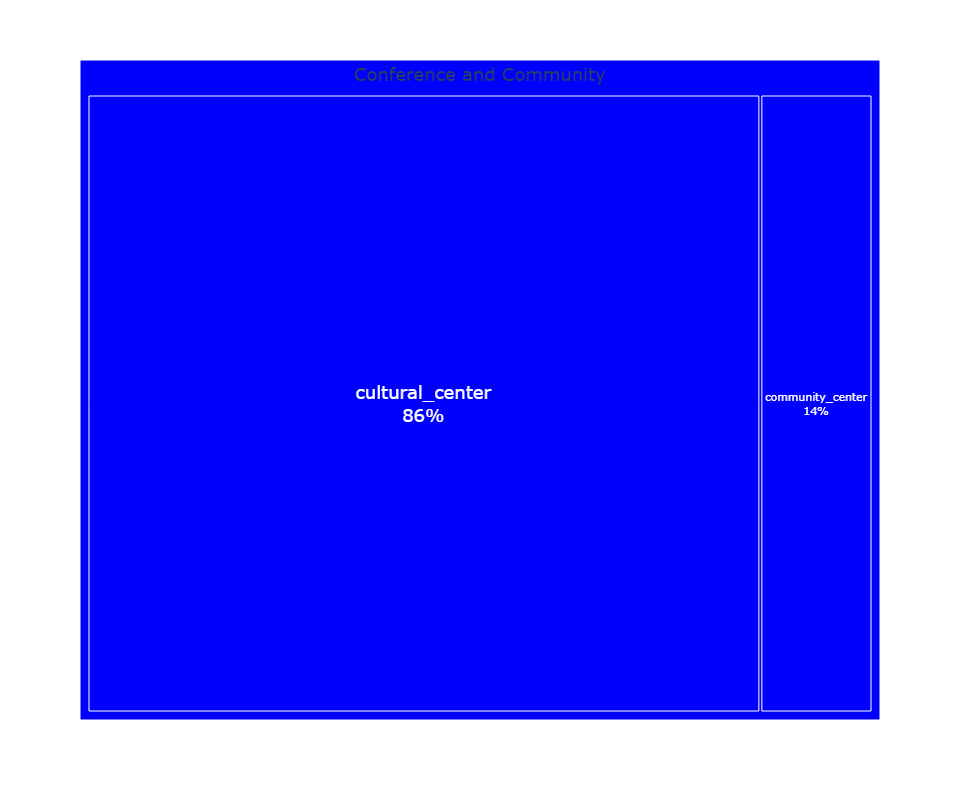

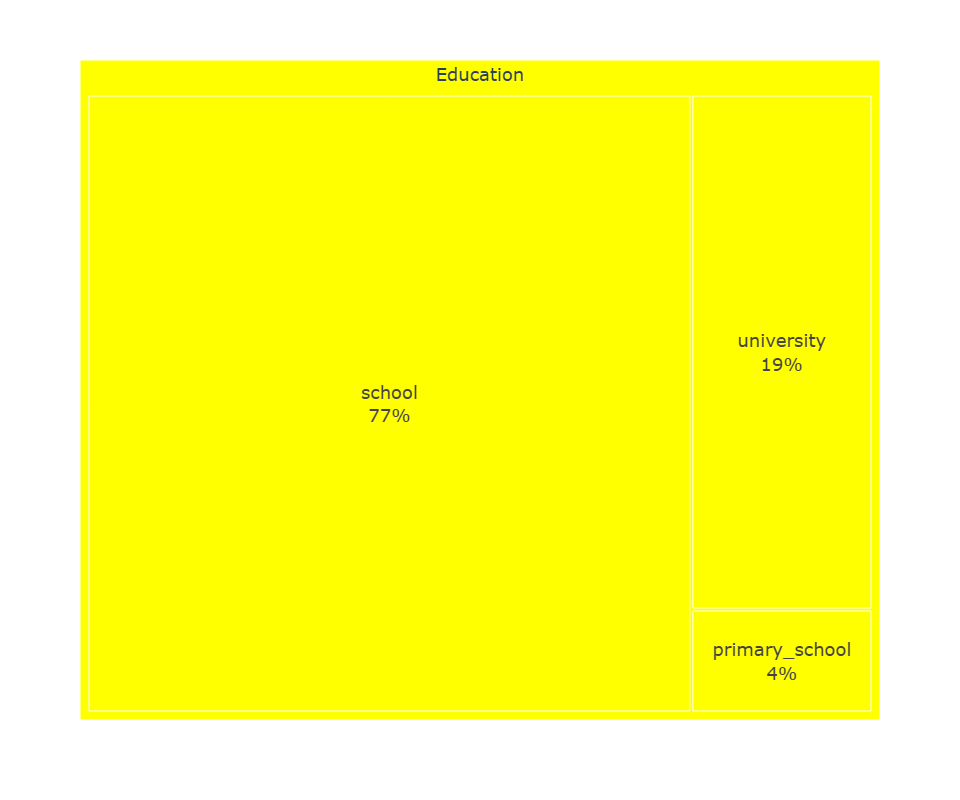

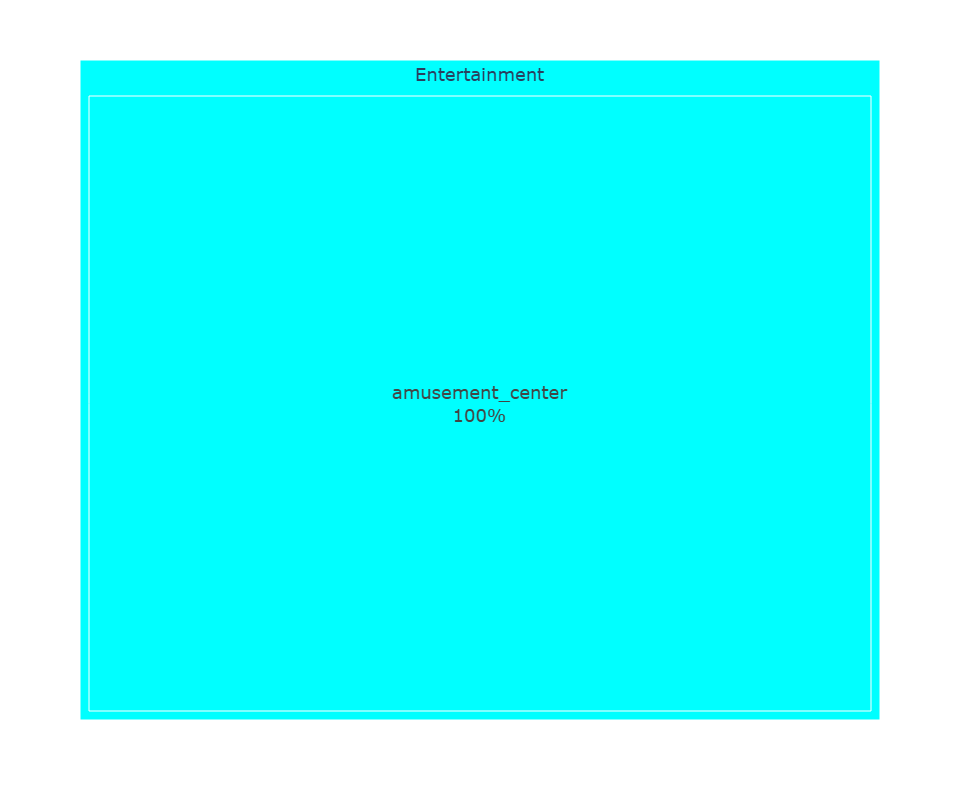

...

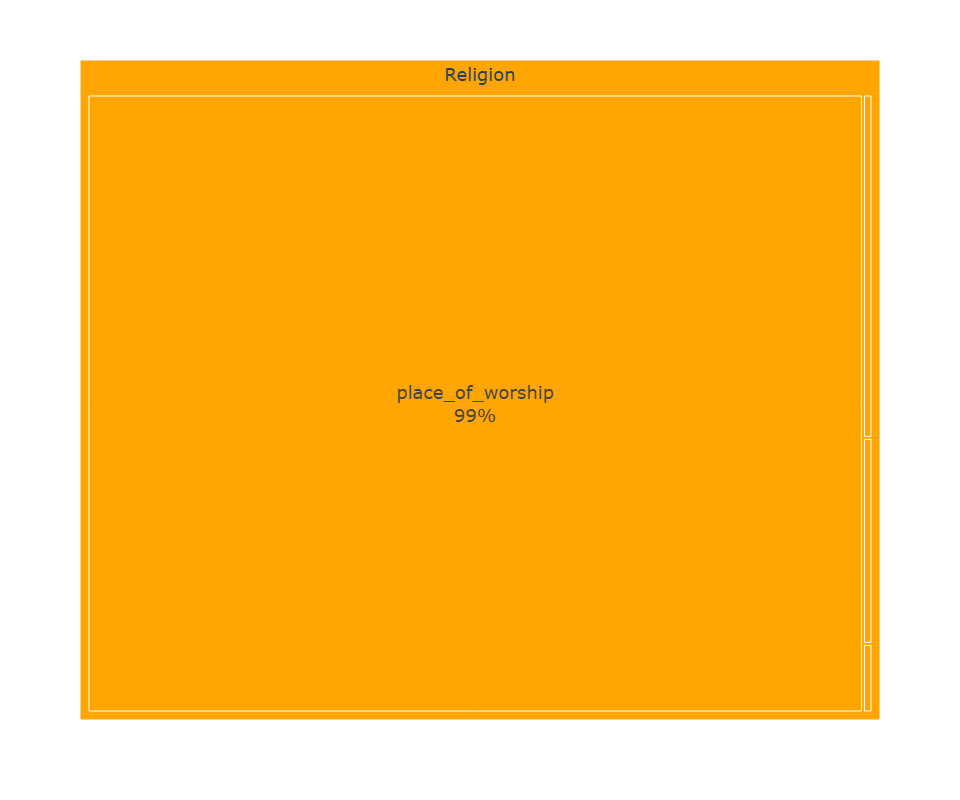

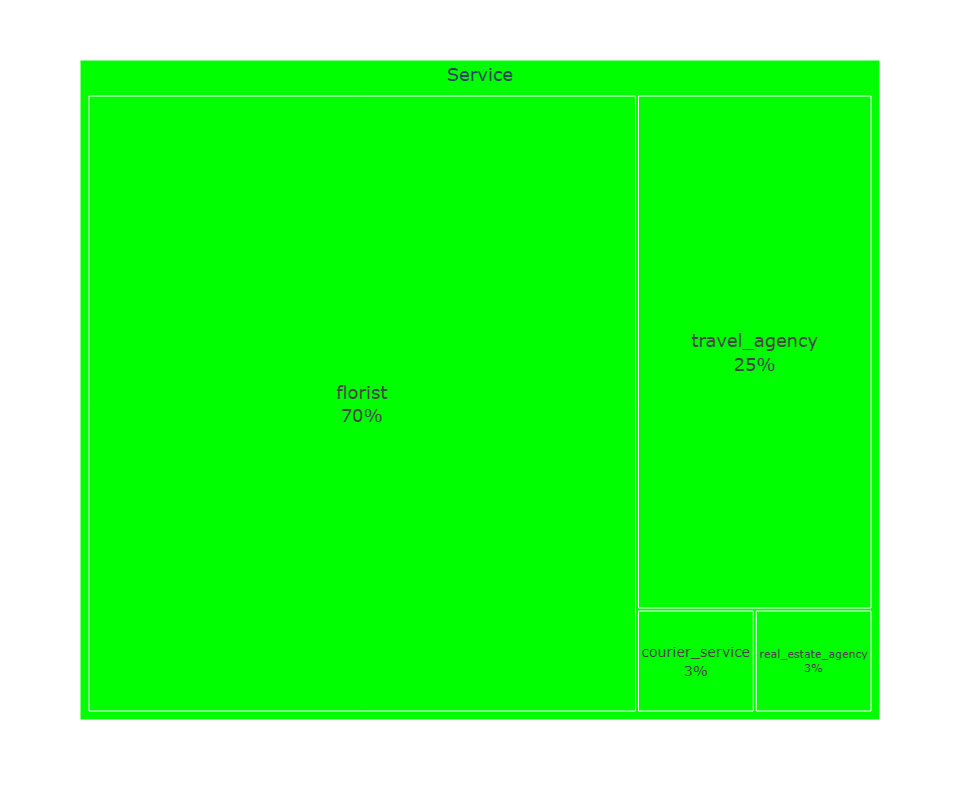

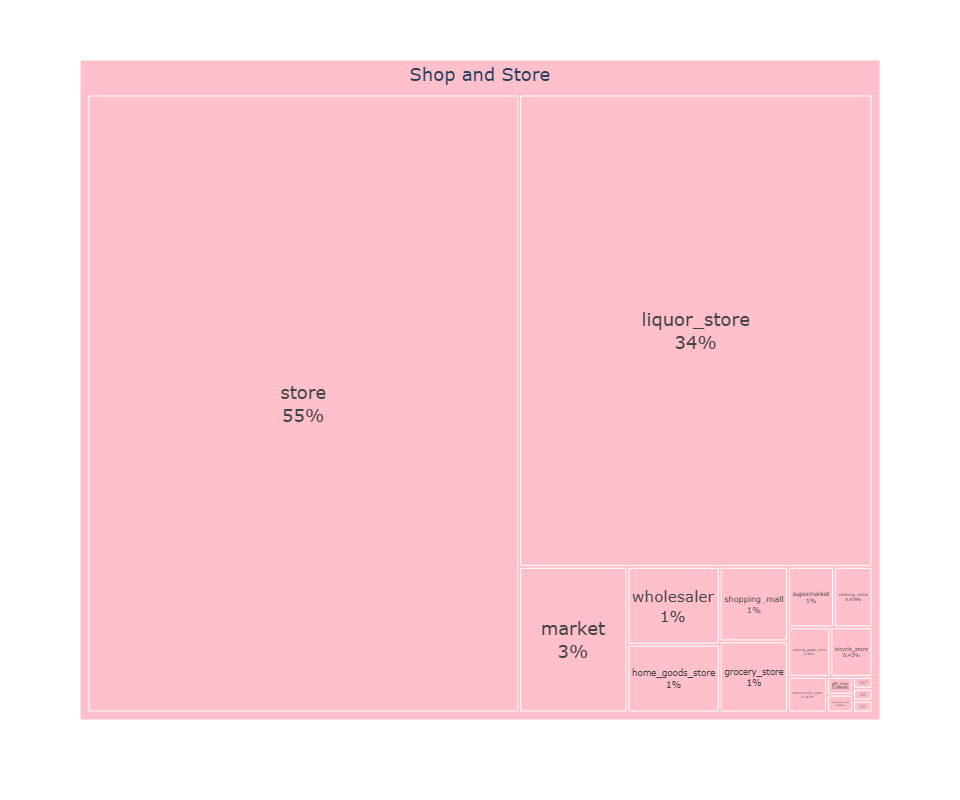

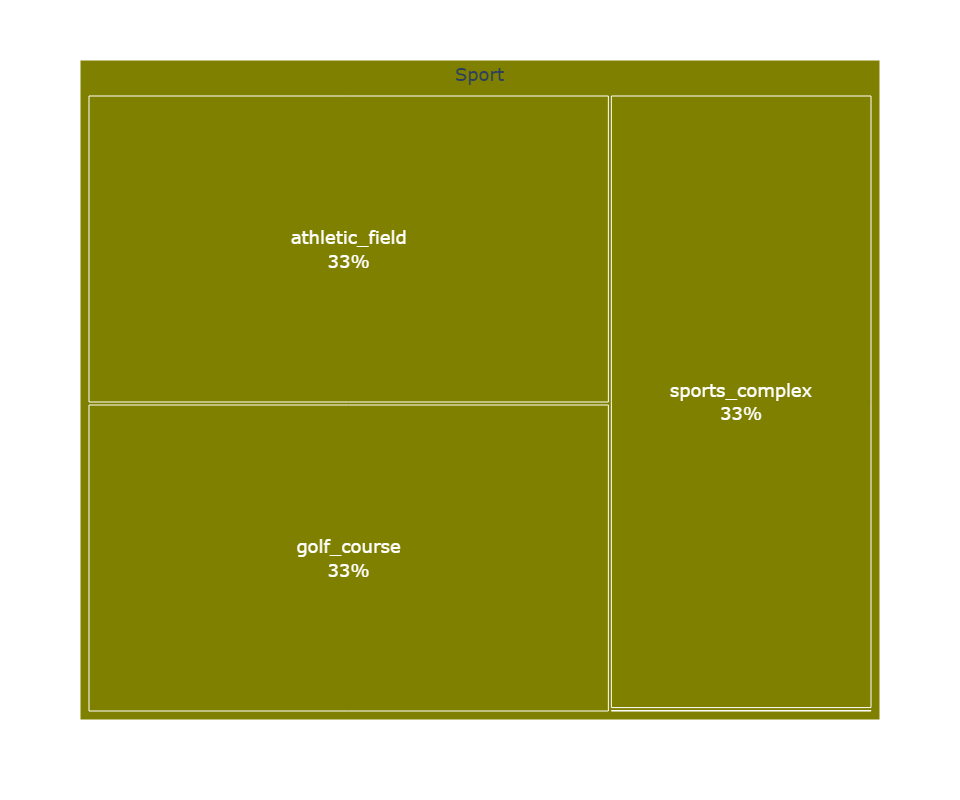

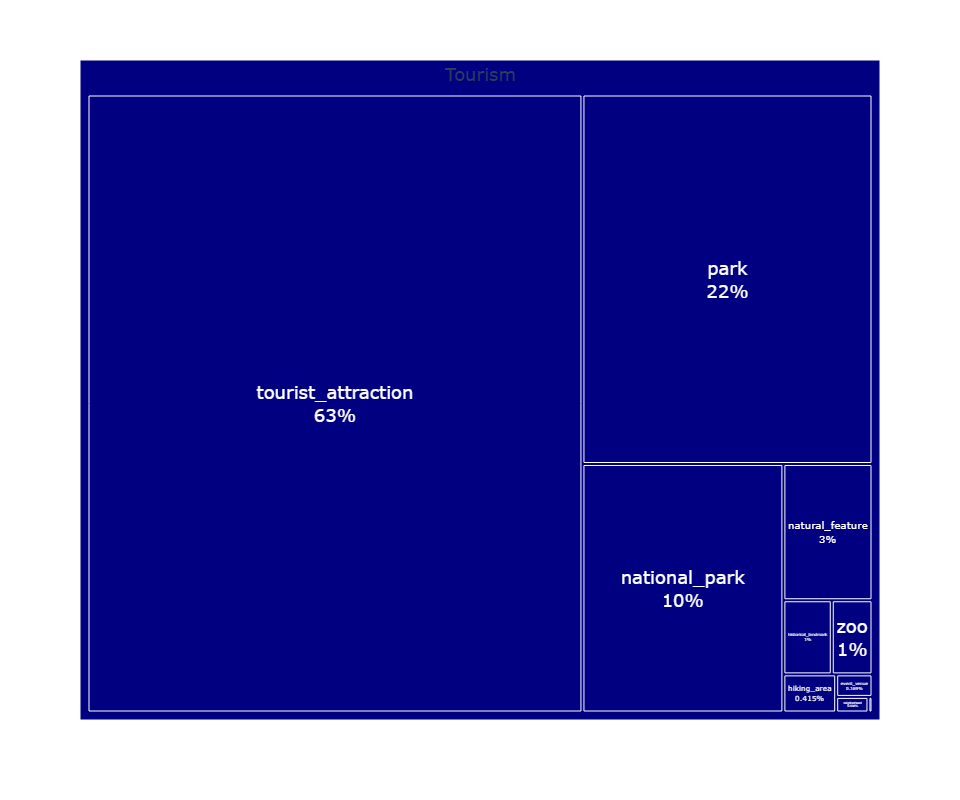

In [865]:
import plotly.express as px

for type_place in chart_df['primaryType'].unique():
    fig = px.treemap(chart_df[chart_df['primaryType']==type_place], path=['primaryType','subType'], values='value',color='primaryType',
                     color_discrete_map = {
                         'Agriculture':'red',
                         'Art and Culture': 'green',
                         'Conference and Community': 'blue',
                         'Education': 'yellow',
                         'Entertainment': 'cyan',
                         'Food and Drink': 'purple',
                         'Healthcare and Wellness': 'teal',
                         'Hotel': 'magenta',
                         'Religion': 'orange',
                         'Service': 'lime',
                         'Shop and Store':'pink',
                         'Sport': 'olive',
                         'Tourism': 'navy'
                     },
                     width=1200,height=800)
    fig.update_traces(textposition = 'middle center', textinfo='label+percent root',textfont_size=18)
    fig.update(layout_showlegend=True)
    fig.write_image('dataset/'+year+f'/placeType_overall_{type_place}_treemap.png')
    fig.show()

In [866]:
chart_df['percentage'] = '-1'

In [867]:
freq = chart_df['subType'].value_counts()
for pType, pCount in freq.items():
    pct = ' {0:.2f}%'.format(pCount*100 / freq.values.sum())
    chart_df.loc[chart_df['subType'] == pType, 'percentage'] = pct
    # freq.values / (chart_df[['primaryType', 'value']].value_counts().values).sum() * 100
chart_df

,primaryType,subType,value,percentage
0,Agriculture,farm,1,3.96%
1,Agriculture,farm,1,3.96%
2,Agriculture,farm,1,3.96%
3,Agriculture,farm,1,3.96%
4,Agriculture,farm,1,3.96%
...,...,...,...,...
37529,Tourism,tourist_attraction,1,12.96%
37530,Tourism,national_park,1,2.12%
37531,Tourism,park,1,4.54%
37532,Tourism,tourist_attraction,1,12.96%


In [868]:
chart_df.loc[len(chart_df)] = {'primaryType':"Religion", 'subType':'', "value":0, 'percentage': str(0)}
chart_df

,primaryType,subType,value,percentage
0,Agriculture,farm,1,3.96%
1,Agriculture,farm,1,3.96%
2,Agriculture,farm,1,3.96%
3,Agriculture,farm,1,3.96%
4,Agriculture,farm,1,3.96%
...,...,...,...,...
37530,Tourism,national_park,1,2.12%
37531,Tourism,park,1,4.54%
37532,Tourism,tourist_attraction,1,12.96%
37533,Tourism,tourist_attraction,1,12.96%


In [869]:
chart_df.drop_duplicates(['percentage']).sort_values('percentage')

,primaryType,subType,value,percentage
1767,Education,primary_school,1,0.00%
1756,Education,university,1,0.01%
24112,Religion,mosque,1,0.02%
1668,Conference and Community,community_center,1,0.03%
1749,Education,school,1,0.05%
25569,Shop and Store,shopping_mall,1,0.06%
25524,Service,florist,1,0.07%
15200,Healthcare and Wellness,health,1,0.08%
29858,Tourism,hiking_area,1,0.09%
17135,Hotel,campground,1,0.10%


In [870]:
list(sorted(chart_df['percentage'].unique()))

[' 0.00%',
 ' 0.01%',
 ' 0.02%',
 ' 0.03%',
 ' 0.05%',
 ' 0.06%',
 ' 0.07%',
 ' 0.08%',
 ' 0.09%',
 ' 0.10%',
 ' 0.13%',
 ' 0.15%',
 ' 0.18%',
 ' 0.19%',
 ' 0.21%',
 ' 0.48%',
 ' 0.51%',
 ' 0.63%',
 ' 1.92%',
 ' 1.93%',
 ' 1.95%',
 ' 1.97%',
 ' 10.36%',
 ' 12.00%',
 ' 12.96%',
 ' 13.11%',
 ' 2.00%',
 ' 2.12%',
 ' 3.02%',
 ' 3.07%',
 ' 3.87%',
 ' 3.96%',
 ' 4.54%',
 ' 8.02%',
 '0']

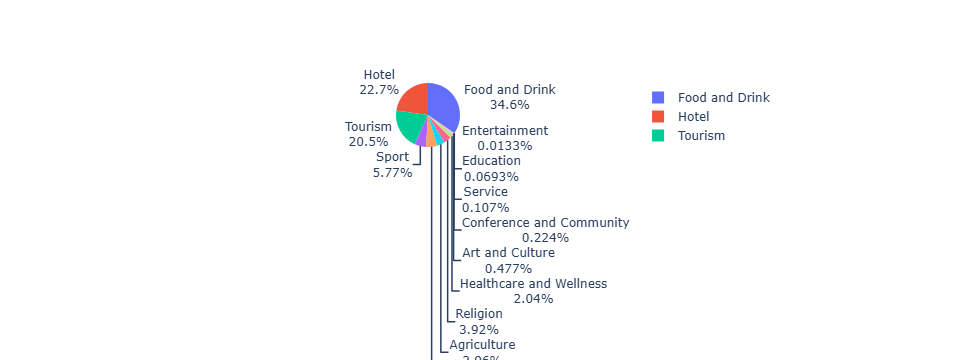

In [871]:
import plotly.graph_objects as go

labels = chart_df['primaryType']
values = chart_df['value']

fig = go.Figure(data=[go.Pie(labels=labels, values=values, textinfo='label+percent',
                             insidetextorientation='radial'
                            )])
fig.show()

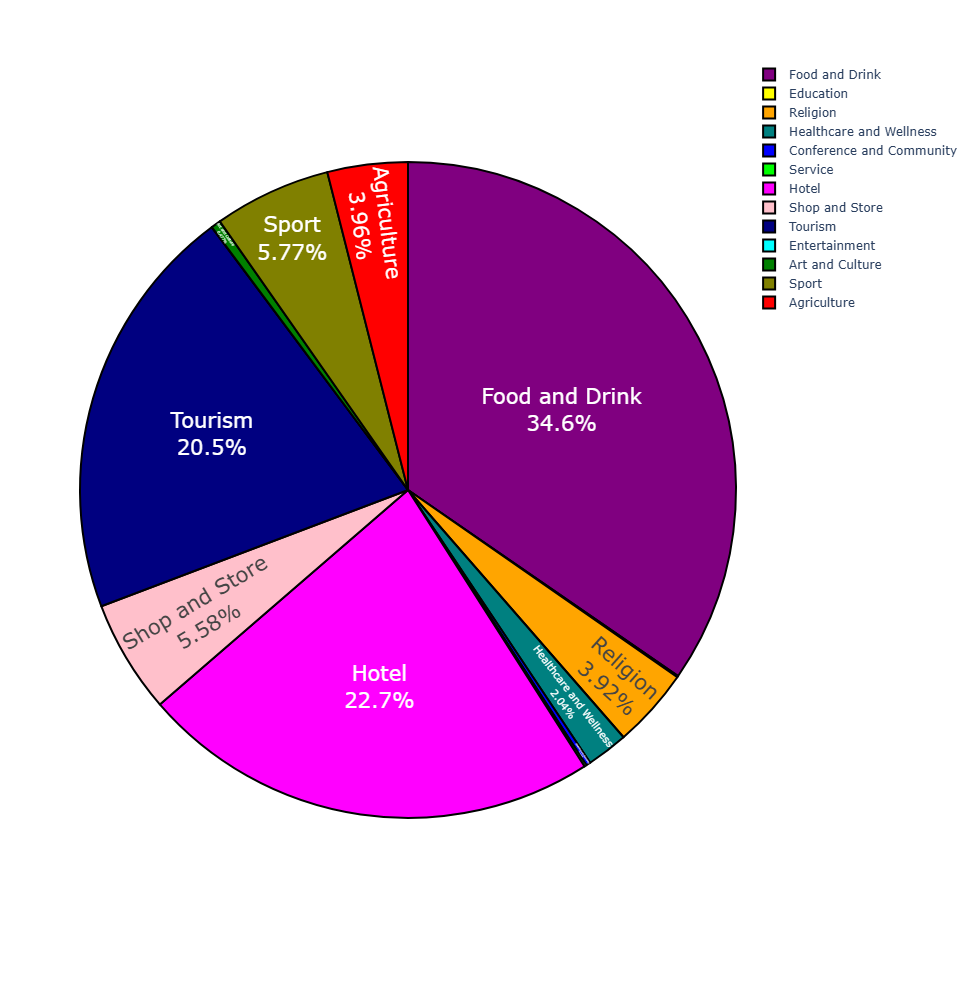

In [872]:
import plotly.express as px
__df = px.data.tips()
fig = px.pie(chart_df, values='value', names='primaryType',
             color='primaryType',
             # color_discrete_map={'Thur':'lightcyan',
             #                     'Fri':'cyan',
             #                     'Sun':'darkblue',
             #                     'Sat':'royalblue'
             #                     },
            
              color_discrete_map = {
                     'Agriculture':'red',
                         'Art and Culture': 'green',
                         'Conference and Community': 'blue',
                         'Education': 'yellow',
                         'Entertainment': 'cyan',
                         'Food and Drink': 'purple',
                         'Healthcare and Wellness': 'teal',
                         'Hotel': 'magenta',
                         'Religion': 'orange',
                         'Service': 'lime',
                         'Shop and Store':'pink',
                         'Sport': 'olive',
                         'Tourism': 'navy'
                     },
            category_orders = {'primaryType': list(gistda_gg_types.keys())},
             width=1000, height=1000
            )
fig.update_traces(textposition='inside',textinfo='label+percent', textfont_size=21,
                 marker=dict(line=dict(color='#000000', width=2))
                 )
# fig.update_layout(uniformtext_minsize=5, uniformtext_mode='hide')
fig.update(
    # layout_title_text='Van Gogh: 5 Most Prominent Colors Shown Proportionally',
           layout_showlegend=True)
fig.show()

In [873]:
# freq = chart_df['primaryType'].value_counts()
# for pType, pCount in freq.items():
#     pct = ' {0:.2f}%'.format(pCount*100 / freq.values.sum())
#     chart_df.loc[chart_df['primaryType'] == pType, 'primaryType'] = pType + pct
#     # freq.values / (chart_df[['primaryType', 'value']].value_counts().values).sum() * 100
# chart_df

In [874]:
# import plotly.express as px
# # 2023
# # testdf = px.data.tips()
# fig = px.sunburst(chart_df, path=['primaryType', 'subType'], values='value', width=1000, height=1000)
# fig.show()

In [875]:
# import plotly.express as px
# # 2019
# # testdf = px.data.tips()
# import plotly.graph_objects as go
# fig = px.sunburst(chart_df, path=['primaryType', 'subType'], values='value', width=1000, height=1000)
# fig.show()

In [876]:
# import pandas as pd
# import numpy as np
# import matplotlib.pyplot as plt

# counts = chart_df.value_counts().sort_index()
# WEDGE_SIZE = 1.8
# LABEL_THRESHOLD = np.average(counts.values)

# # df = pd.DataFrame({'one': list('AAAAAAAAABBBBBBBCCCC'), 'two': list('DDDDDDEEEFFFGGGGHHII'), 'three': list('JJJKKLLMMMMNNNNNNNNN'), 'four': list('OOPPPPQQRSTTTUUUUVVV'), 'five': list('WWWXXXXXXYYYYYYZZZZZ')}).cumsum(1)

# fig, ax = plt.subplots()


# # generate MultiIndex of counts with one feature per level


# # define primary colormaps (cycle if levels > 6)
# cmaps = np.resize(['Blues_r', 'Greens_r', 'Oranges_r', 'Purples_r', 'Reds_r', 'Greys_r',
#                    'pink_r', 'OrRd_r', 'BuGn_r', 'PuBu_r', 'RdPu_r','GnBu_r', 'YlGn_r'
#                   ],
#                   counts.index.get_level_values(0).size)

# # # Expanded list of colormap names including 'viridis'
# # colormap_list = ['Blues_r', 'Greens_r', 'Oranges_r', 'Purples_r', 'Reds_r', 'Greys_r'
# #                  ]

# # # Number of levels in your data
# # num_levels = counts.index.get_level_values(0).size

# # # Calculate the number of times to repeat the colormap list
# # repeats = -(-num_levels // len(colormap_list))  # Ceiling division

# # # Create the full list of colormaps to be cycled through
# # cmaps = np.tile(colormap_list, repeats)[:num_levels]

# for level in range(len(counts.index.names)):
#     # Compute grouped sums up to the current level
#     wedges = counts.groupby(level=list(range(level+1))).sum()

#     # Extract annotation labels from MultiIndex
#     labels = wedges.index.get_level_values(level)

#     # Calculate percentages
#     total = wedges.sum()
#     percentages = 100 * wedges / total  # get percentages

#     # Format labels with percentages
#     labels_with_percents = [
#         f"{label}: {percent:.1f}%" if value >= LABEL_THRESHOLD else ''
#         for label, percent, value in zip(labels, percentages, wedges)
#     ]

#     # Generate color shades per group
#     index = [(i,) if level == 0 else i for i in wedges.index.tolist()]  # standardize Index vs MultiIndex
#     g0 = pd.DataFrame.from_records(index).groupby(0)
#     maps = g0.ngroup()
#     shades = g0.cumcount() / g0.size().max()
#     colors = [plt.get_cmap(cmaps[m])(s) for m, s in zip(maps, shades)]
    
#     # Plot colorized/labeled donut layer with borders and colored text
#     ax.pie(x=wedges,
#            radius=1.8 + (level * WEDGE_SIZE),
#            colors=colors,
#            labels=labels_with_percents,  # Use formatted labels with percentages
#            rotatelabels=True,
#            labeldistance=1.1 - 1.4/(level+2),  # Put labels inside wedge
#            wedgeprops=dict(width=WEDGE_SIZE, linewidth=1, edgecolor='white', alpha=0.46),
#            textprops={'color': 'black'})  # Setting font color here

# # plt.savefig(f'./dataset/{year}/placeType_overall.png')
# plt.show()